In [155]:
from pymongo import MongoClient
from pathlib import Path
import os
from pprint import pprint
import nltk
import matplotlib.pyplot as plt
import pprint
import pywt

import os
import struct
import matplotlib
from scipy import signal
import scipy.fftpack
import numpy as np
import sys
import pymongo
import json
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler

import numpy as np
from scipy.signal import butter, lfilter, freqz
import matplotlib.pyplot as plt
%matplotlib inline

In [156]:
client = MongoClient('mongodb://localhost:27017')
testDb = client.testDb

patients = testDb.patients
sessions = testDb.sessions
reports = testDb.reports

In [158]:
def fileName(filePath):
    return (os.path.splitext(os.path.split(filePath)[1]))[0]

def fileExt(filePath):
    try:
        return (os.path.splitext(os.path.split(filePath)[1]))[1]
    except:
        return "Error"

In [159]:
testParse = '/Users/taylorsomma/Desktop/capstone/v1.2.0/eval/01_tcp_ar/00009842/s002_2013_04_01/00009842_s002_t000.edf'
nTestSignals = 32
decodeRecords = 32
seekToDecode = (256-32)*nTestSignals+256

testOut = open(testParse,'rb')
#testOut.seek(256)
print(testOut.read(512))
testOut.seek(252)
print("Signals: ",testOut.read(4))
print("------------------------End of file header-----------------------------------")
print(testOut.read(nTestSignals*(256-128)))
print(testOut.tell())
testOut.seek(seekToDecode)
print("------------------------------")
unpackString = ''
for x in range(nTestSignals*16):
    unpackString = unpackString + str(struct.unpack('h',testOut.read(2)))
print(unpackString)

b'0       00009842                                                                        Startdate 01-APR-2013 00009842_s002                                             01.04.1315.29.157168    EDF                                         300     1.00000027  EEG FP1-REF     EEG FP2-REF     EEG F3-REF      EEG F4-REF      EEG C3-REF      EEG C4-REF      EEG P3-REF      EEG P4-REF      EEG O1-REF      EEG O2-REF      EEG F7-REF      EEG F8-REF      EEG T3-REF      EEG T4-REF      EEG T5-REF      EEG T6-REF      '
Signals:  b'27  '
------------------------End of file header-----------------------------------
b'EEG FP1-REF     EEG FP2-REF     EEG F3-REF      EEG F4-REF      EEG C3-REF      EEG C4-REF      EEG P3-REF      EEG P4-REF      EEG O1-REF      EEG O2-REF      EEG F7-REF      EEG F8-REF      EEG T3-REF      EEG T4-REF      EEG T5-REF      EEG T6-REF      EEG T1-REF      EEG T2-REF      EEG FZ-REF      EEG CZ-REF      EEG PZ-REF      EEG EKG1-REF    EEG A1-REF      EEG A2-REF      IB

In [282]:
class channel(object):
    def __init__(self,edfFile,label=None,transducer=None,dimensions=None,
                physMin=None,physMax=None,digMin=None,digMax=None,
                 preFilter=None,sampleRate=None,notes=None,channelIndex=None,byteLength=None):
        self.edfFile = edfFile
        self.label = str(label)
        self.sampleRate = int(sampleRate)
        self.transducer = str(transducer)
        self.dimensions = dimensions
        self.physMin = physMin
        self.physMax = physMax
        self.digMin = digMin
        self.digMax = digMax
        self.preFilter = preFilter
        self.notes  = notes
        self.channelIndex = int(channelIndex)
        self.byteLength = byteLength
        #self.indexStart = indexStart
    
    def __str__(self):
        if self.label==None:
            return "None"
        else:
            returnString = ("Label: "+str(self.label) + "\nSample Rate"+str(self.sampleRate)+
            "\nTransducer: "+str(self.transducer)+"\nDimensions: "+str(self.dimensions)+
            "\nphysMin: "+str(self.physMin)+"\nphysMax: "+str(self.physMax)+
            "\ndigMin: "+str(self.digMin) +"\ndigMax: "+str(self.digMax)+ "\npreFilter: "+str(self.preFilter)+
            "\nNotes: "+str(self.notes) + "\nChannelIndex: "+str(self.channelIndex) + "\nbyteLength: "+str(self.byteLength))
        return returnString
    
    def channelData(self,start,duration,channelNumber = 0,sensitivity = 1):
        '''
        Returns data points of all signals from start time for duration
        start: seconds from start of record
        duration: time  of record desired in seconds
        byteLength: Length of each record per unit duration
        channelIndex: index in record
        '''
        headerLength = self.edfFile.getHeaderBytes()
        
        bytesToRead = self.sampleRate * self.edfFile.getDuration()
        channelDataToReturn = []
        recordByteLength = self.edfFile.getRecordByteLength()
        numSkipRecordBytes = start * recordByteLength
        '''
        print("IN CHANNEL DATA FUNCTION")
        print("Channel Sample Rate: ",self.sampleRate)
        print("Sample Durations: ",self.edfFile.getDuration())
        print("Channel Index: ",self.channelIndex)
        print("Skipping: ",numSkipRecordBytes)
        print("Record Byte Length: ",recordByteLength)
        print("headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i")
        print("Read INDEX: ",(headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength))
        '''
        samplesToRead = int(self.sampleRate/2)
        for i in range(duration):
            #print("I VALUE RIGHT NOW IS: ",i)
            readIndex = headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i
            self.edfFile.edfRawData.seek(readIndex)
            #print("Getting DATA FROM INDEX:  ",readIndex)
            for j in range(samplesToRead):
                channelDataToReturn.append(struct.unpack('h',self.edfFile.edfRawData.read(2)))
            #print("READ DATA TO INDEX: ",self.edfFile.edfRawData.tell())
        return channelDataToReturn

    def allChannelData(self):
        toReturn = []
        self.edfFile.edfRawData.seek(self.channelIndex)
        for i in range(int(self.byteLength/2)):
            toReturn.append(struct.unpack('h',self.edfFile.edfRawData.read(2)))
        return toReturn
        
    def getLabel(self):
        return str(self.label)
    
    def getSampleRate(self):
        return self.sampleRate
    
    def getChannelIndex(self):
        return self.channelIndex
    
    def getTransducer(self):
        return self.transducer

    def getDimensions(self):
        return self.dimensions
    
    def getPhysMin(self):
        return float(self.physMin)
    
    def getPhysMax(self):
        return float(self.physMax)
    
    def getDigMin(self):
        return float(self.digMin)
    
    def getDigMax(self):
        return float(self.digMax)
    
    def getPreFilter(self):
        return self.preFilter
    
    def getNotes(self):
        return self.notes
    
    def getByteLength(self):
        return self.byteLength
    
class edfData(object):
    def __init__(self,fileId):
        self.fileId=fileId
        
    def __str__(self):
        return ("version: " + str(self.version) + "\nPatient Id: "+str(self.patientId) 
                + "\nrecordId" + str(self.recordId) + "\nStart Date: " + str(self.startTime)
                + "\nStart Time: " + str(self.startTime)
                + "\nheader Bytes: " + str(self.headerBytes) +"\nReserve Bytes: " +str(self.reservedBytes)
                + "\nNum Records :" + str(self.nRecords) + "\nNum Signals :" + str(self.nSignals) 
                + "\nDuration: "+ str(self.duration) + "\nFile Size: "+str(self.fileSize))
                
                
    def loadFile(self,filepath):
        self.filePath = filepath
        self.fileSize = os.path.getsize(filepath)
        self.edfRawData = open(filepath,'rb')
        
    def readBitsTest(self):
        self.edfRawData.seek(0)
        bits = self.edfRawData.read(10000)
        self.edfRawData.seek(0)
        print(self.edfRawData.read(10))
        print("Some Bits: "+str(bits))
        return bits
    
    def readSignalHeaderBits(self,bitsIn,nSignals,nBits):
            returnArray = []
            for x in range(nSignals):
                returnArray.append(bitsIn.read(nBits))
            return returnArray
        
    def returnChannelObjects(self):
        return self.channels
    
    def parseEdf(self):
        '''
            This function parses the edf file getting the values of 
            the header fields. It also creates a channel object with 
            information about each channel, including the eeg tracing data from each channel.
        '''
        #Header Fields
        #print(self.edfRawData.tell()) #
        self.edfRawData.seek(0)       #
        self.version = str(self.edfRawData.read(8))
        self.patientId = str(self.edfRawData.read(80))
        self.recordId = str(self.edfRawData.read(80))
        self.startDate = str(self.edfRawData.read(8))
        self.startTime = str(self.edfRawData.read(8))
        self.headerBytes = int(self.edfRawData.read(8))
        self.reservedBytes = str(self.edfRawData.read(44))
        self.nRecords = int(self.edfRawData.read(8))
        #print("nRecords: ",self.nRecords)
        self.duration = float(self.edfRawData.read(8))
        #print("Duration: ",self.duration)
        self.nSignals = int(self.edfRawData.read(4))
        #print("N Signals: ",self.nSignals)
        #Create channel object for each channel
        self.channels = {}
        channelFields = ['labels','transducer','dimensions','physMin','physMax','digMin','digMax',
                        'preFilter','sampleRate','reservedNotes']
        self.channels['labels'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,16)
        self.channels['transducer'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,80)
        self.channels['dimensions'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['physMin'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['physMax'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['digMin'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['digMax'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['preFilter'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,80)
        self.channels['sampleRate'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['reservedNotes'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,32)
        #print("SAMPLE RATES: ",self.channels['sampleRate'])
        sumOfSampleRates = 0
        for x in self.channels['sampleRate']:
            sumOfSampleRates += int(x)
        self.recordByteLength = sumOfSampleRates * 2
        #print("EDF CHANNEL PRINT: ",self.channels['reservedNotes'])
        
        self.channelObjects = []
        self.sampleRate = int(self.channels['sampleRate'][0])
        
        channelDataStart = self.headerBytes
    
        #This loop creates and adds channel objects to self.channelObjects
        for i in range(int(self.nSignals)):
            
            channelValues ={'filepath':self.filePath}
            channelRecordIndex = sum(list(np.array(self.channels['sampleRate']).astype(int))[0:i])*2
            
            
            for j in channelFields:
                try:
                    channelValues[j]=(self.channels[j][i])
                except:
                    channelValues[j] = None
            newChannel = channel(self,channelValues['labels'],channelValues['transducer'],
                        channelValues['dimensions'],channelValues['physMin'],channelValues['physMax'],
                        channelValues['digMin'],channelValues['digMax'],channelValues['preFilter'],
                        channelValues['sampleRate'],channelValues['reservedNotes'],channelDataStart,self.recordByteLength) 
            #print("Appending channel")
            #print(newChannel)
            self.channelObjects.append(channel(self,channelValues['labels'],channelValues['transducer'],
                        channelValues['dimensions'],channelValues['physMin'],channelValues['physMax'],
                        channelValues['digMin'],channelValues['digMax'],channelValues['preFilter'],
                        channelValues['sampleRate'],channelValues['reservedNotes'],
                        channelRecordIndex))  #Changed this channelIndex to channelDataStart
            
            #channelDataStart += byteLength
    
    
        self.channelSampleRates = channelValues['sampleRate'] 
        self.channelDigMax = channelValues['digMax']
        self.channelDigMin = channelValues['digMin']
        self.channelPhysMax = channelValues['physMax']
        self.channelPhysMin = channelValues['physMin']
            
    def data(self,start,duration):
        sampleData = []
        j = 0
        for x in self.channelObjects:
            sampleData.append([x.getLabel(),x.channelData(start,duration)])
            j+=1
        return sampleData
    
    def dataDictionary(self,start,duration):
        sampleData = {}
        j = 0
        #Returns dictionary with key being channel label, values being a dict [data,sampleRate,digMax,digMin,physMax,physMin]
        for i,x in enumerate(self.channelObjects):
            dataToAdd = x.channelData(start,duration,i)   
            #print("ADDING TO DATA DICTIONARY: ",x.getLabel())
            sampleData[x.getLabel()]={'data':dataToAdd,'sampleRate':x.getSampleRate(),
                                     'digMax':x.getDigMax(),'digMin':x.getDigMin(),'physMin':x.getPhysMin(),
                                     'physMax':x.getPhysMax()}
            #print(x)
            j+=1
        return sampleData
    
    def dataForGraph(self,start,duration,sensitivity=1):
        sampleData = []
        j=0
        for x in self.channelObjects:
            sampleData.append([x.getLabel(),x.channelData(start,duration,j,sensitivity)])
            j+=1
        return sampleData
    
    def allData(self):
        '''
        Return[sampleRate,{channelData}]
        '''
        channelData = {}
        for x in self.channelObjects:
            channelData[str(x.getLabel())]=x.allChannelData()
        return[int(self.sampleRate),channelData]
            
            
    
    def patientId(self):
        return self.patientId
    
    def getFilePath(self):
        return self.filePath
    
    def getRecordId(self):
        return str(self.recordId)
    
    def getStartDate(self):
        return self.startDate
    
    def getStartTime(self):
        return self.startTime
    
    def getHeaderBytes(self):
        return self.headerBytes
    
    def getReservedBytes(self):
        return self.reservedBytes
    
    def getDuration(self):
        return self.duration
    
    def getNRecords(self):
        return self.nRecords
    
    def numSignals(self):
        return self.nSignals
    
    def getSampleRate(self):
        return int(self.sampleRate)
    
    def getRecordByteLength(self):
        return self.recordByteLength

    def getChannelLabels(self):
        labels = []
        for channel in self.channelObjects:
            labels.append(channel.getLabel())
        return labels
    
    def returnChannelObjects(self):
        return self.channels
    
    def totalSamples(self):
        duration = int(self.sampleRate) * int(self.nRecords)
        return duration
    
    def testChannelPrint(self):
        print(self.channelObjects[2])

<h1>Plotting Functions</h1>

In [320]:
'''
Plotting Functions
'''
    
    
def plotEDF(edfObject,montageArray,startPlot,endPlot,scaleFactor = 1,loFilter = 1, hiFilter = 70,dcFilter = True,filterOn = False,maxIndexMarkers=False,secondMarkers = False):
    
    edfDataDictionary = edfObject.dataDictionary(startPlot,endPlot)
    dataDictionaryKeys = list(edfDataDictionary.keys())
    #startPlotTime = str(edfObject.getStartTime()) +" + " + str(startPlot) + " Seconds"
    plotTitle = str(edfObject.getFilePath()) + " - "+str(startPlot)
    if filterOn == True:
        filterInfo = "( Lo: "+str(loFilter) + " Hi: "+str(hiFilter) + ")"
        plotTitle += filterInfo
    for n,x in enumerate(montageArray):
        channel1 = x[0]
        channel2 = x[1]
        channel1Label = dataDictionaryKeys[channel1]
        channel2Label = dataDictionaryKeys[channel2]
        
        channel1DigMax = edfDataDictionary[channel1Label]['digMax']
        channel1PhysMax = edfDataDictionary[channel1Label]['physMax']
        channel1SampleRate = edfDataDictionary[channel1Label]['sampleRate']
        channel2DigMax = edfDataDictionary[channel2Label]['digMax']
        channel2PhysMax = edfDataDictionary[channel2Label]['physMax']
        channel2SampleRate = edfDataDictionary[channel2Label]['sampleRate']
        
        channel1ScaleFactor = channel1PhysMax/channel1DigMax
        channel2ScaleFactor = channel2PhysMax/channel2DigMax
        
        input1Data = np.array(edfDataDictionary[channel1Label]['data']) * channel1ScaleFactor
        input2Data = np.array(edfDataDictionary[channel2Label]['data']) * channel2ScaleFactor
        
        if dcFilter == True:
            input1DataMean = np.mean(input1Data)
            input2DataMean = np.mean(input2Data)
            input1Data = input1Data - input1DataMean
            input2Data = input2Data - input2DataMean
        
        #plotData = input1Data - input2Data
        plotData = np.subtract(input1Data,input2Data)
        
        if filterOn == True:
            plotData = range_filter(plotData, loFilter, hiFilter, channel1SampleRate, order = 5)
            print("Filtering Data")
        
        scaledAndMoved = plotData*scaleFactor +(-n*40)
        
        #print(plotData[0:10])
        #print(scaledAndMoved[0:10])
        channelAverageHeight = np.average(scaledAndMoved)
        
        channelsInMontage = len(montageArray)
        vLineHeight = 1/channelsInMontage
        
        if maxIndexMarkers == True:
            channelMax = max(plotData)
            maxIndex = list(plotData).index(channelMax)
            lineStart = 1-((n+2)*(vLineHeight))
            lineEnd = 1-(n*vLineHeight)
            plt.text(maxIndex,channelAverageHeight+60,("Index: "+str(maxIndex)+" Value: "+str(channelMax)))
            #plt.axes().axvline(maxIndex,i*vLineHeight,(i+1)*vLineHeight).set_color('green') This one is if plots aren't started from the bottom
            plt.axes().axvline(maxIndex,lineStart,lineEnd).set_color('green')

        #plt.text(maxIndex,channelAverageHeight+60,("Channel: ",str(x)," Max Index: ",str(maxIndex)))
        plt.text(0,channelAverageHeight+3,(str(channel1Label)+" - "+str(channel2Label)))
        plt.title(plotTitle)
        plt.plot(scaledAndMoved)  #Change back to scaledAndMoved

    plt.show()
    
    
def plotQuadrantSpike(edfObject,quadrantArray,montageArray,quadrantToPlot,indexToPlot,timeSpan):
    '''
    Plot quadrant spike at specified index and quadrant
    '''
    sampleRate = edfObject.getSampleRate()
    startSecond = indexToPlot-(sampleRate/2)/sampleRate
    vLineLocation = sampleRate/2
    edfDataDictionary = edfObject.dataDictionary(startSecond,timeSpan)
    dataDictionaryKeys = list(edfDataDictionary.keys())
    quadrantChannels = quadrantArray[quadrantToPlot]
    for i,x in enumerate(quadrantChannels):
        channel1 = montageArray[x][0]
        channel2 = montageArray[x][1]
        channel1Label = dataDictionaryKeys[channel1]
        channel2Label = dataDictionaryKeys[channel2]
        
        channel1DigMax = edfDataDictionary[channel1Label]['digMax']
        channel1PhysMax = edfDataDictionary[channel1Label]['physMax']
        channel1SampleRate = edfDataDictionary[channel1Label]['sampleRate']
        channel2DigMax = edfDataDictionary[channel1Label]['digMax']
        channel2PhysMax = edfDataDictionary[channel1Label]['physMax']
        
        channel1ScaleFactor = float(channel1PhysMax/channel1DigMax)
        channel2ScaleFactor = float(channel2PhysMax/channel2DigMax)
        #print("Channel2SCALE FACTOR: ",channel2ScaleFactor)
        input1Data = np.array(edfDataDictionary[channel1Label]['data']) * float(channel1ScaleFactor)
        input2Data = np.array(edfDataDictionary[channel2Label]['data']) * float(channel2ScaleFactor)

        plotData = input1Data - input2Data

        scaledAndMoved = plotData +(-i*600)
        channelAverageHeight = np.average(scaledAndMoved)
        plt.axes().axvline(vLineLocation,0,1).set_color('red')
        plt.text(0,channelAverageHeight+60,(str(channel1Label)+" - "+str(channel2Label)))
        plt.plot(scaledAndMoved)
    plt.show()
        
        

<h1>Global variables</h1>
<h3>Montages,Sample EDF Files,</h3>

In [161]:
'''
Global Variables
'''

#Longitudinal Bipolar Montage array
longBipolarMontage = [[0,10],[10,12],[12,14],[14,8],[0,2],[2,4],[4,6],[6,8],
                      [18,19],[19,20],[1,3],[3,5],[5,7],[7,9],[1,11],[11,13],[13,15],[15,9]]
czRefMontage = [[0,19],[10,19],[12,19],[14,19],[0,19],[2,19],[4,19],[6,19],
                      [18,19],[19,19],[1,19],[3,19],[5,19],[7,19],[1,19],[11,19],[13,19],[15,19]]
testMontage = [[1,21],[3,21],[5,21],[7,21],[9,21],[1,3],[3,5],[5,7],[7,9]]
testMontage2 = [[0,19],[1,19],[2,19],[3,19],[4,19],[5,19],[6,19],[7,19],[8,19],[9,19],[10,19],
                [11,19],[12,19],[13,19],[14,19],[15,19],[16,19],[17,19],[18,19],[19,19],[0,19],
                [10,19],[12,19],[14,19],[0,19],[2,19],[4,19],[6,19],
                [18,19],[19,19],[1,19],[3,19],[5,19],[7,19],[1,19],[11,19],[13,19],[15,19]]
#adjacentElectrodeArray is an array of arrays where each of the entries is a quadrant LAQ,LPQ,RAQ,RPQ
adjacentElectrodeArray = [[0,1,4,5],[2,6,3,7],[10,11,14,15],[12,11,13,17]] 

#Contains Many Spikes
trainingFile1 ='/Users/taylorsomma/Desktop/capstone/v1.2.0/eval/01_tcp_ar/00009842/s001_2013_04_01/00009842_s001_t000.edf'
predictFile1 = '/Users/taylorsomma/Desktop/capstone/v1.2.0/eval/01_tcp_ar/00009842/s002_2013_04_01/00009842_s002_t000.edf'
predictFile2 = '/Users/taylorsomma/Desktop/capstone/v1.2.0/eval/01_tcp_ar/00010547/s001_2013_07_29/00010547_s001_t001.edf'

predictEDF1 = edfData(2)
predictEDF1.loadFile(predictFile2)
predictEDF1.parseEdf()

trainingEDF1 = edfData(1)
trainingEDF1.loadFile(trainingFile1)
trainingEDF1.parseEdf()

    #fftData[channelName] = fft(channelData)
    #fftData[channelName] = scipy.fftpack.fft(channelData)


durationToCheck = 120  # Only search first 120 seconds of each sample
print(trainingEDF1)
print("\n",predictEDF1)


version: b'0       '
Patient Id: b'00009842                                                                        '
recordIdb'Startdate 01-APR-2013 00009842_s001                                             '
Start Date: b'14.17.46'
Start Time: b'14.17.46'
header Bytes: 9472
Reserve Bytes: b'EDF                                         '
Num Records :1568
Num Signals :36
Duration: 1.0
File Size: 25890880

 version: b'0       '
Patient Id: b'00010547                                                                        '
recordIdb'Startdate 29-JUL-2013 00010547_s001                                             '
Start Date: b'10.32.07'
Start Time: b'10.32.07'
header Bytes: 9472
Reserve Bytes: b'EDF                                         '
Num Records :1795
Num Signals :36
Duration: 1.0
File Size: 29637742


In [162]:
#testEDF1 = predictEDF1.dataDictionary(0,1)
#print(testEDF1.keys())
#for x in testEDF1:
#    print(testEDF1[x])
print(predictEDF1)
predictChannels = predictEDF1.returnChannelObjects()
print("Num Chanel Objects = ",len(predictChannels))
for x in predictChannels:
    print(type(x))
    print(x)
    
print("\n\n")
print(trainingEDF1)
trainingChannels = trainingEDF1.returnChannelObjects()
print("Num Chanel Objects = ",len(trainingChannels))
#for x in trainingChannels:
#    print(type(x))
#    print(x)
    
trainingDictionaryTest =  trainingEDF1.dataDictionary(0,10)

version: b'0       '
Patient Id: b'00010547                                                                        '
recordIdb'Startdate 29-JUL-2013 00010547_s001                                             '
Start Date: b'10.32.07'
Start Time: b'10.32.07'
header Bytes: 9472
Reserve Bytes: b'EDF                                         '
Num Records :1795
Num Signals :36
Duration: 1.0
File Size: 29637742
Num Chanel Objects =  10
<class 'str'>
labels
<class 'str'>
transducer
<class 'str'>
dimensions
<class 'str'>
physMin
<class 'str'>
physMax
<class 'str'>
digMin
<class 'str'>
digMax
<class 'str'>
preFilter
<class 'str'>
sampleRate
<class 'str'>
reservedNotes



version: b'0       '
Patient Id: b'00009842                                                                        '
recordIdb'Startdate 01-APR-2013 00009842_s001                                             '
Start Date: b'14.17.46'
Start Time: b'14.17.46'
header Bytes: 9472
Reserve Bytes: b'EDF                                   

30


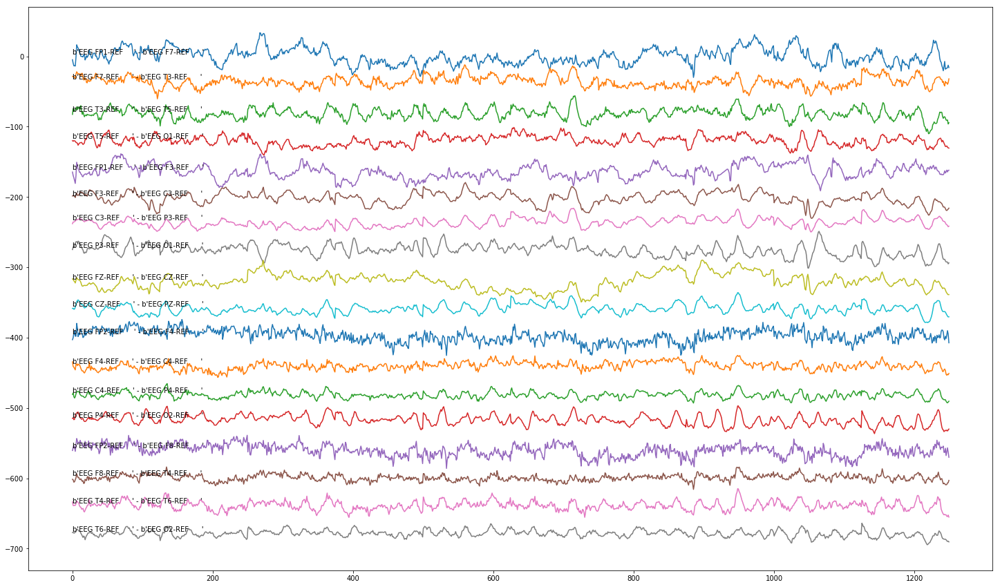

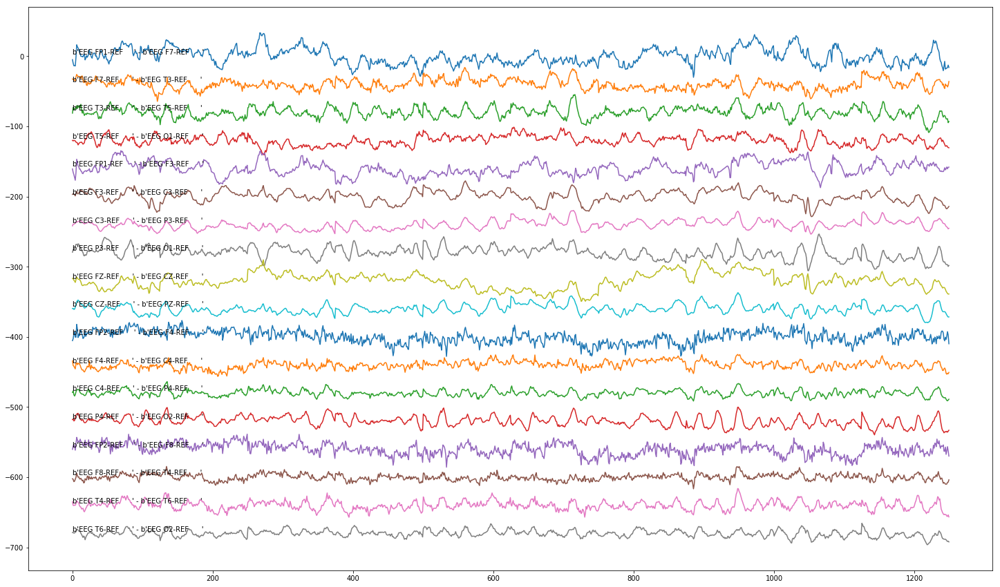

Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data


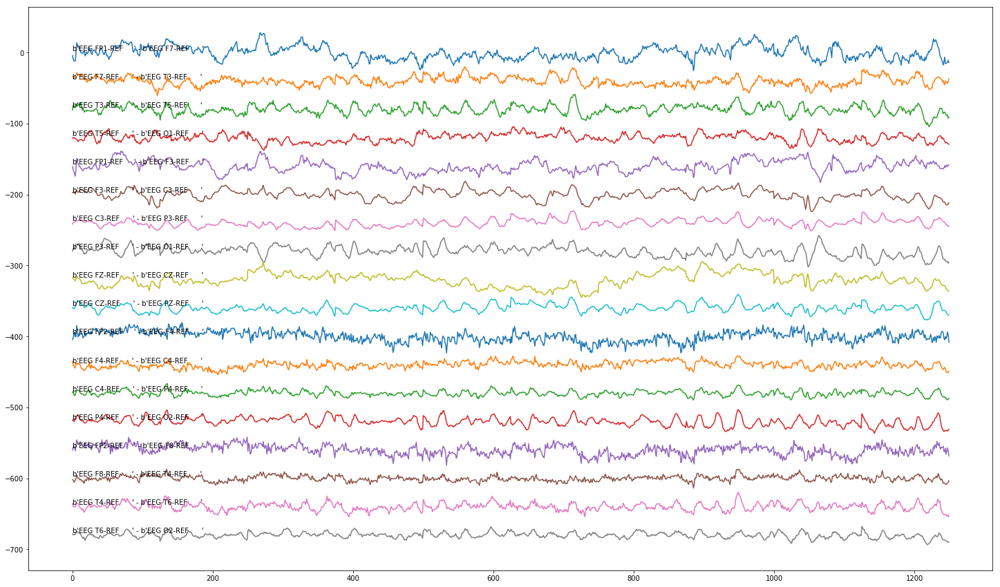

KeyboardInterrupt: 

In [174]:
#plotEDF(edfObject,montageArray,startPlot,endPlot,scaleFactor = 1,loFilter = 1, hiFilter = 70,dcFilter = True,filterOn = False,maxIndexMarkers=False)
keepPlotting = 1
while keepPlotting != -1:
    keepPlotting = input()
    plotStart = int(keepPlotting)
    plotEnd = 10
    plt.figure(figsize=(25,15))
    plotEDF(predictEDF1,longBipolarMontage,plotStart,plotEnd,1,dcFilter = False,filterOn = False)
    plt.figure(figsize=(25,15))
    plotEDF(predictEDF1,longBipolarMontage,plotStart,plotEnd,1,filterOn = False)
    plt.figure(figsize=(25,15))
    plotEDF(predictEDF1,longBipolarMontage,plotStart,plotEnd,40,loFilter = 1,hiFilter = 50,filterOn=True)

0


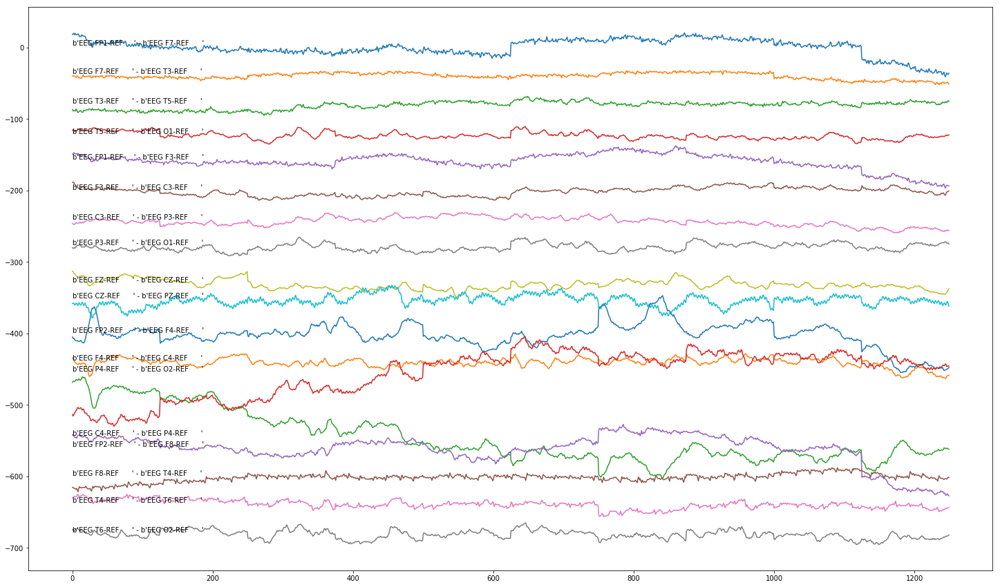

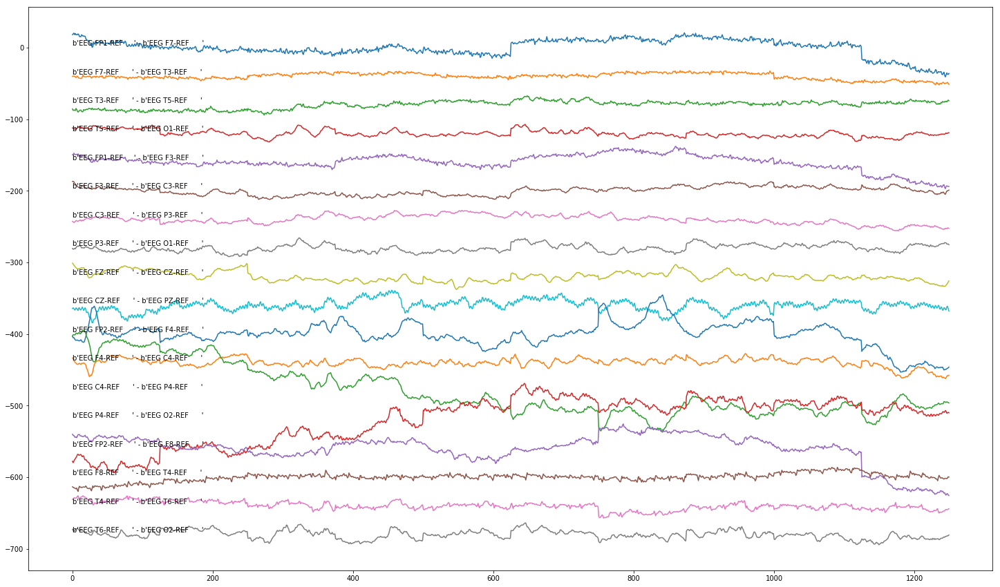

Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data


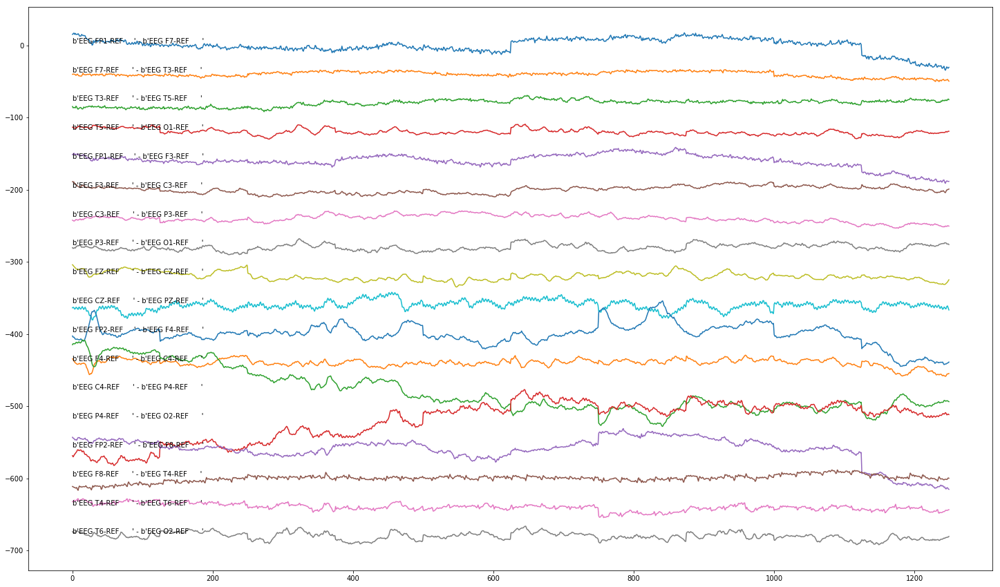

30


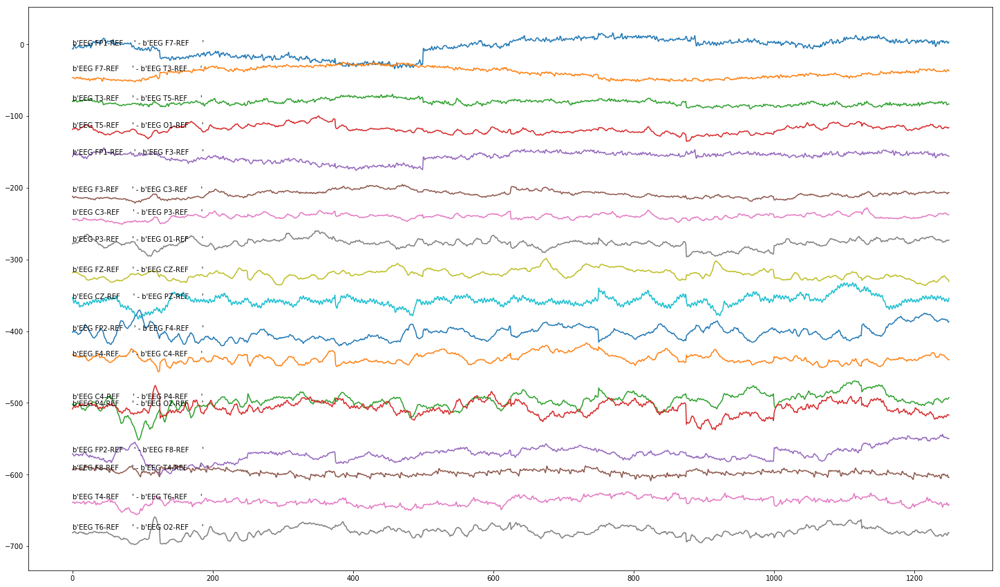

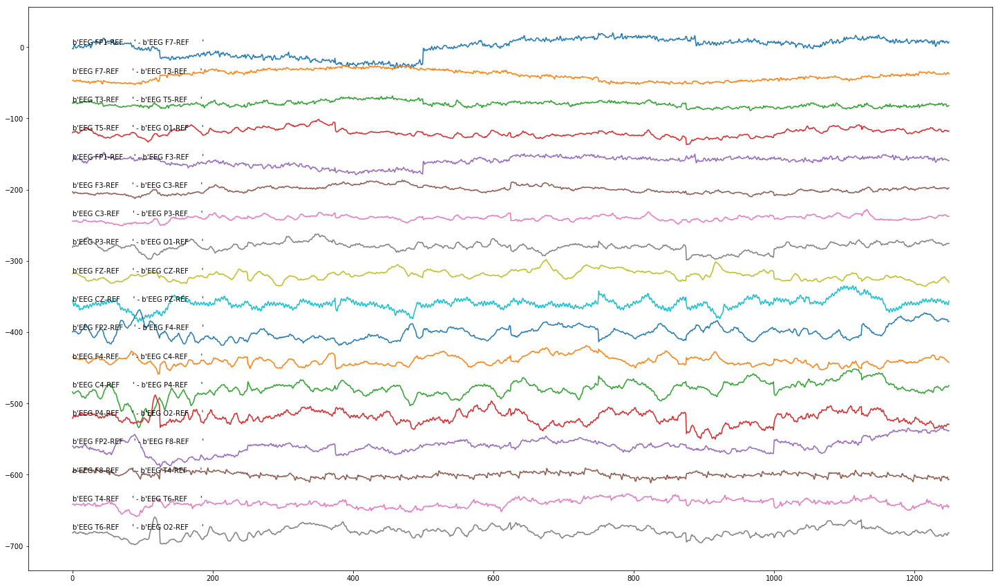

Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data
Filtering Data


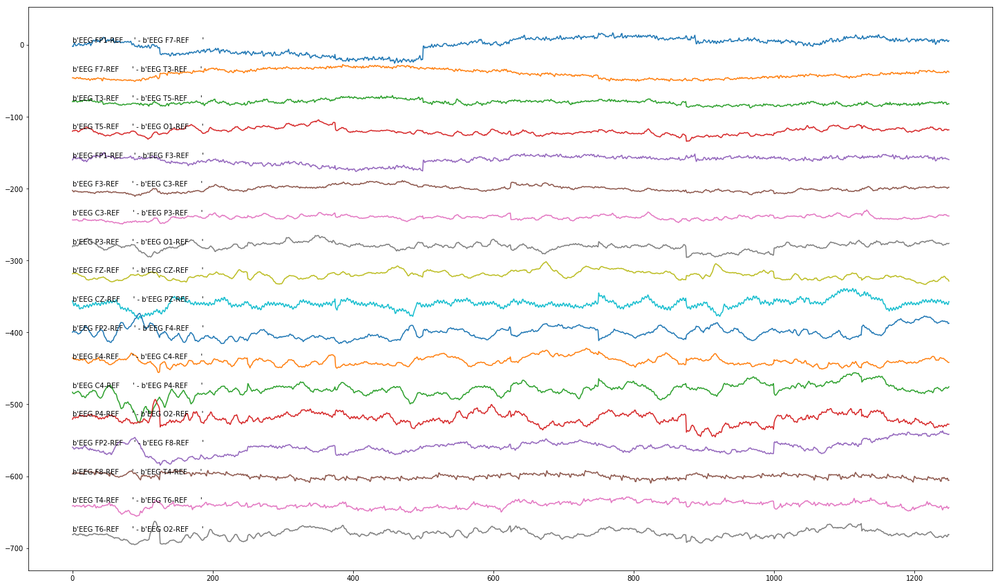

KeyboardInterrupt: 

In [175]:
keepPlotting = 1
while keepPlotting != -1:
    keepPlotting = input()
    plotStart = int(keepPlotting)
    plotEnd = 10
    plt.figure(figsize=(25,15))
    plotEDF(trainingEDF1,longBipolarMontage,plotStart,plotEnd,1,dcFilter = False,filterOn = False)
    plt.figure(figsize=(25,15))
    plotEDF(trainingEDF1,longBipolarMontage,plotStart,plotEnd,1,filterOn = False)
    plt.figure(figsize=(25,15))
    plotEDF(trainingEDF1,longBipolarMontage,plotStart,plotEnd,40,loFilter = 1,hiFilter = 50,filterOn=True)

In [ ]:
'''
Signal Processing Functions
'''

def getChangeArray(inputArray):
    newArray =[]
    for i in range(len(inputArray)):
        if i==0:
            pass
        newArray.append(inputArray[i]-inputArray[i-1])
    return newArray

def movingAverage(inputArray,avgNum):
    newArray = []
    for i in range(len(inputArray)):
        if i<avgNum:
            pass
        newArray.append(np.average(inputArray[i-(avgNum):i]))
    return newArray

def returnVariation(eegData,width,sampleRate):
    #Looks for greatest change over the specified width in the signal
    #width is samples to 
    v1 = eegData[0]
    totalChange = 0 
    maxChange = 0
    maxIndex = 0
    dataLength = len(eegData)
    for i in range(dataLength-width):
        currentChange = 0
        for j in range(width-1):
            currentChange += eegData[j+i]-eegData[j+i+1]
             
        if abs(currentChange) > abs(maxChange):
            maxChange = currentChange
            maxIndex = i
        #print(currentChange)
        currentChange = 0
        
    msTime = maxIndex/sampleRate
    #print("Max Change: ",maxChange," Max Index: ",maxIndex," Max Time: ",msTime)
    return [maxChange,maxIndex,msTime]

def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

def butter_lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

def butter_highpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff,btype='high', analog = False)
    return b, a

def butter_highpass_filter(data, cutoff, fs, order = 5):
    b, a = butter_highpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

def range_filter(data, low, high, fs, order = 5):
    dataLow = butter_lowpass_filter(data,high,fs,order)
    dataReturn = butter_highpass_filter(dataLow,low,fs,order)
    return dataReturn
    

def zeroAverage1(data):
    average = np.mean(np.absolute(data))
    returnData = []
    for x in data:
        returnData.append(((x-average)/average)**2)
    return returnData

def normalizeSignal(data):
    maxValue = max(data)
    minValue = min(data)
    valueRange = maxValue-minValue
    returnArray = []
    for x in data:
        returnArray.append(x/valueRange)
    return returnArray
        

<h1>Find Features</h1>

In [333]:
def fileName(filePath):
    return (os.path.splitext(os.path.split(filePath)[1]))[0]

def fileExt(filePath):
    return (os.path.splitext(os.path.split(filePath)[1]))[1]


featureTypes = testDb.sessions.distinct('tseData.eventLabel')
print(featureTypes)

abszRecords = testDb.sessions.find({'tseData.eventLabel':'absz'})
tcszRecords = testDb.sessions.find({'tseData.eventLabel':'tcsz'})
gnszRecords = testDb.sessions.find({'tseData.eventLabel':'gnsz'})
myszRecords = testDb.sessions.find({'tseData.eventLabel':'mysz'})
spszRecords = testDb.sessions.find({'tseData.eventLabel':'spsz'})
fnszRecords = testDb.sessions.find({'tseData.eventLabel':'fnsz'})

#pt1 = testDb.sessions.find_one({'patientId':'00005479'})

abszSeizureSamples = {}
abszSeizureSamplesList = []
myszSeizureSamples = []
spszSeizureSamples = []
tcszSeizureSamples = []
fnszSeizureSamples = []

#for x in abszRecords:
#    print(x['tseData'])
    
for x in abszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'absz':
            for filePath in x['edfList']:
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = list([entry['startTime'],entry['endTime']])
                    abszSeizureSampleKeys = list(abszSeizureSamples.keys())
                    if filePath in abszSeizureSampleKeys:
                        abszSeizureSamples[filePath].append(seizureSampleEntry)
                    else:
                        abszSeizureSamples[filePath] = [seizureSampleEntry,]
        else:
            pass       
        
for x in spszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'spsz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                #print(fileName(filePath))
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            spszSeizureSamples.append(seizureSampleEntry) 
        else:
            pass
        
abszRecords = testDb.sessions.find({'tseData.eventLabel':'absz'})
for x in abszRecords:
    print("In absz")
    for entry in x['tseData']:
        if entry['eventLabel'] == 'absz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                #print(fileName(filePath))
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            abszSeizureSamplesList.append(seizureSampleEntry) 
        else:
            pass 
        
for x in tcszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'tcsz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                #print(fileName(filePath))
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            #print("TCSZ SENTRY: ",seizureSampleEntry)
            tcszSeizureSamples.append(seizureSampleEntry) 
        else:
            pass    
        
for x in myszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'mysz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            myszSeizureSamples.append(seizureSampleEntry) 
        else:
            pass
        
        
for x in fnszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'fnsz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            fnszSeizureSamples.append(seizureSampleEntry) 
        else:
            pass        

#print(tcszSeizureSamples)
#print(myszSeizureSamples)

['bckg', 'fnsz', 'gnsz', 'cpsz', 'tcsz', 'absz', 'spsz', 'mysz', 'tnsz']
In absz
In absz
In absz
In absz
In absz
v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf
[['646.0199', '656.7111'], ['811.5721', '819.8721']]
v1.2.0/eval/02_tcp_le/00003306/s001_2006_10_11/00003306_s001_t001.edf
[['193.8443', '200.0443'], ['287.8331', '296.5331'], ['564.3052', '573.0052'], ['1355.6108', '1363.3108']]
v1.2.0/eval/02_tcp_le/00001984/s001_2004_02_17/00001984_s001_t001.edf
[['101.3115', '111.1115'], ['121.2115', '130.2115'], ['307.6115', '315.4115'], ['436.2508', '448.3508'], ['557.1951', '565.2951'], ['763.2230', '775.3230'], ['802.1230', '810.3230'], ['964.4951', '974.2951'], ['1166.9836', '1173.5836']]
v1.2.0/eval/02_tcp_le/00000675/s002_2006_09_05/00000675_s002_t001.edf
[['115.4115', '119.7115'], ['155.7115', '160.6115'], ['168.2115', '169.9115'], ['181.3115', '185.1115'], ['205.4115', '210.2115'], ['232.1115', '234.1115'], ['244.3115', '246.3115'], ['251.5115', '254.3115'], [

v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf
['646.0199', '656.7111']


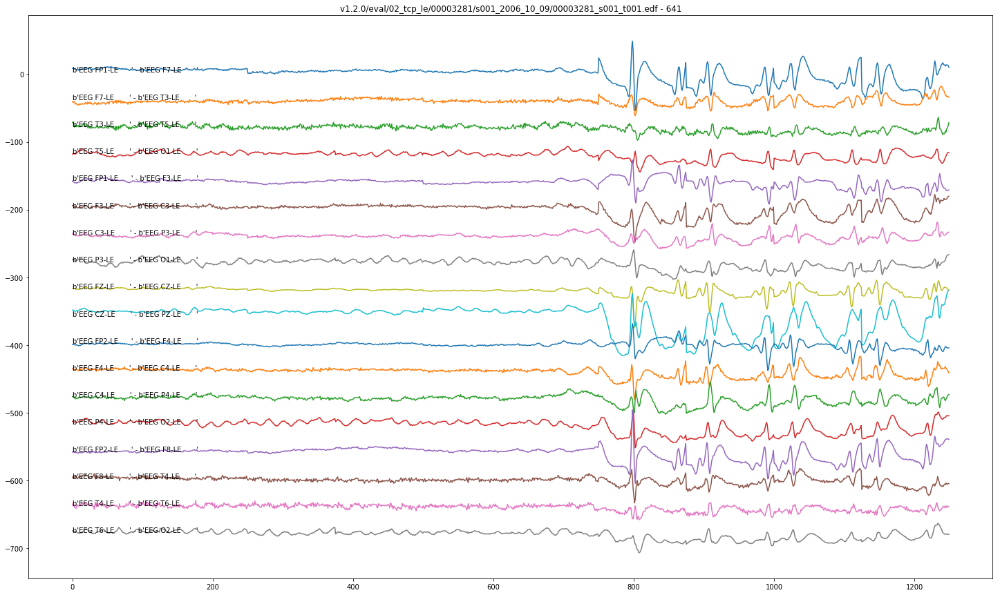

['811.5721', '819.8721']


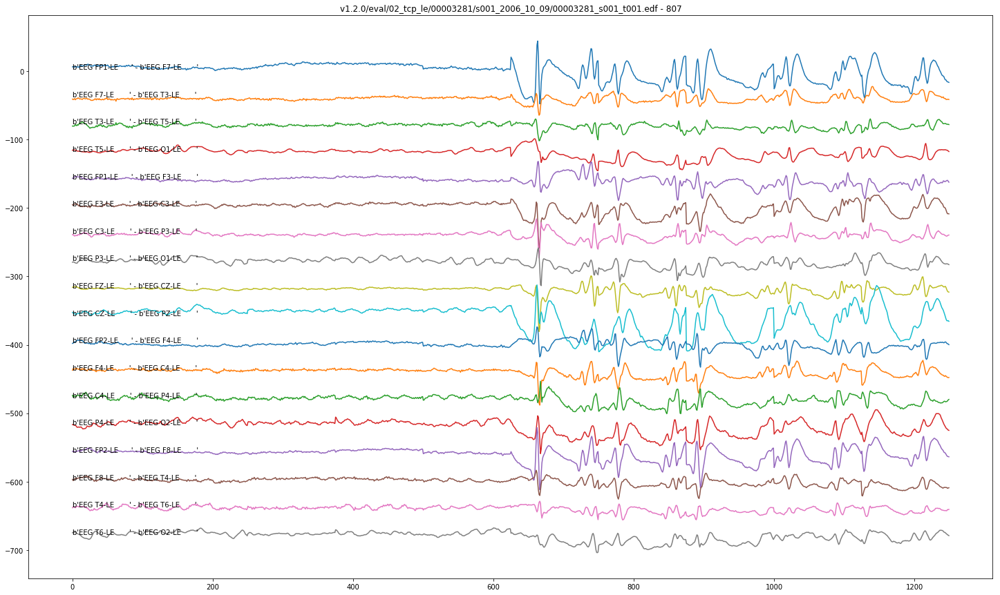

v1.2.0/eval/02_tcp_le/00003306/s001_2006_10_11/00003306_s001_t001.edf
['193.8443', '200.0443']


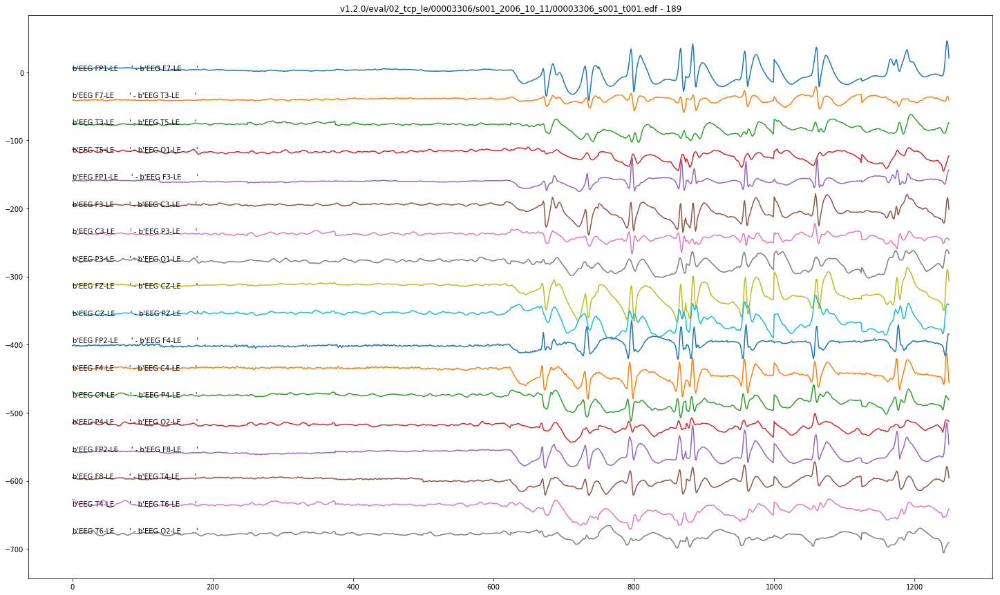

['287.8331', '296.5331']


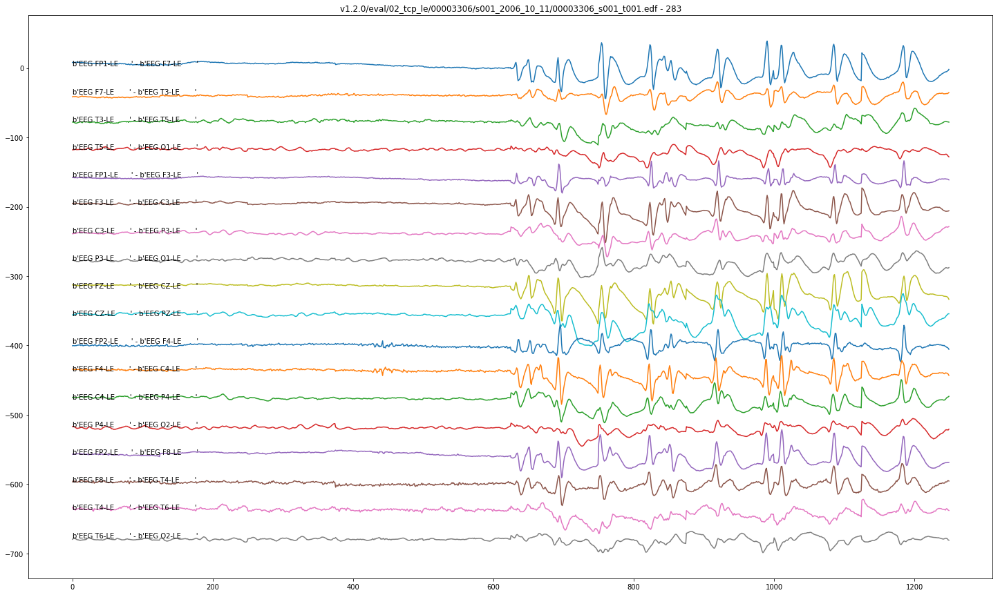

['564.3052', '573.0052']


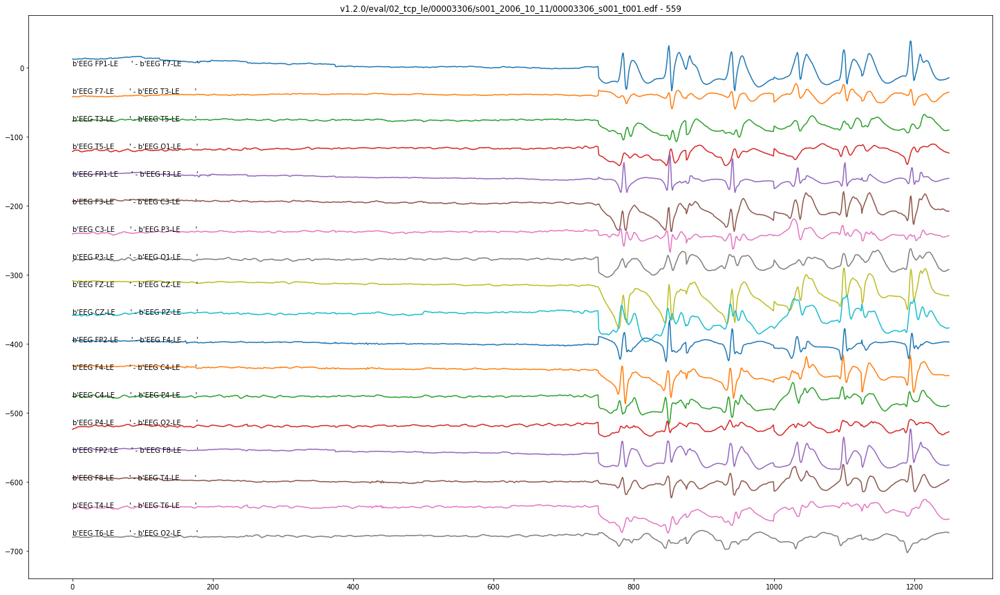

['1355.6108', '1363.3108']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['121.2115', '130.2115']


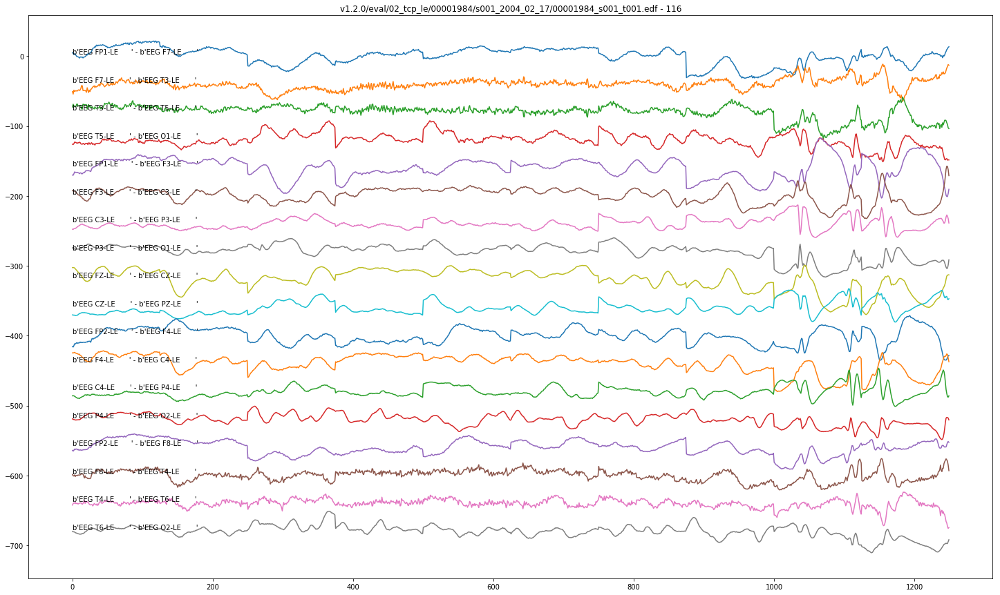

['307.6115', '315.4115']


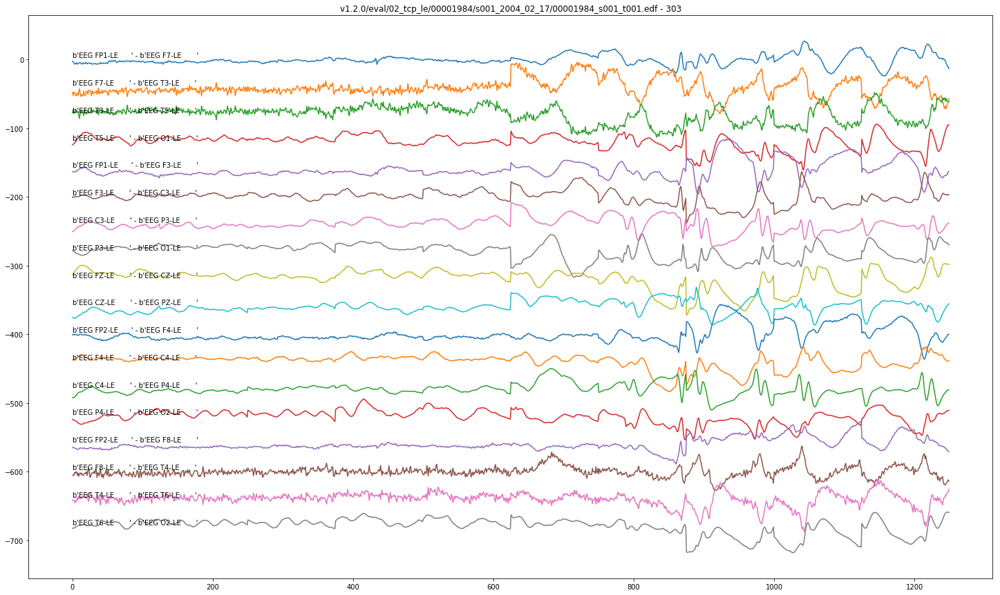

['436.2508', '448.3508']


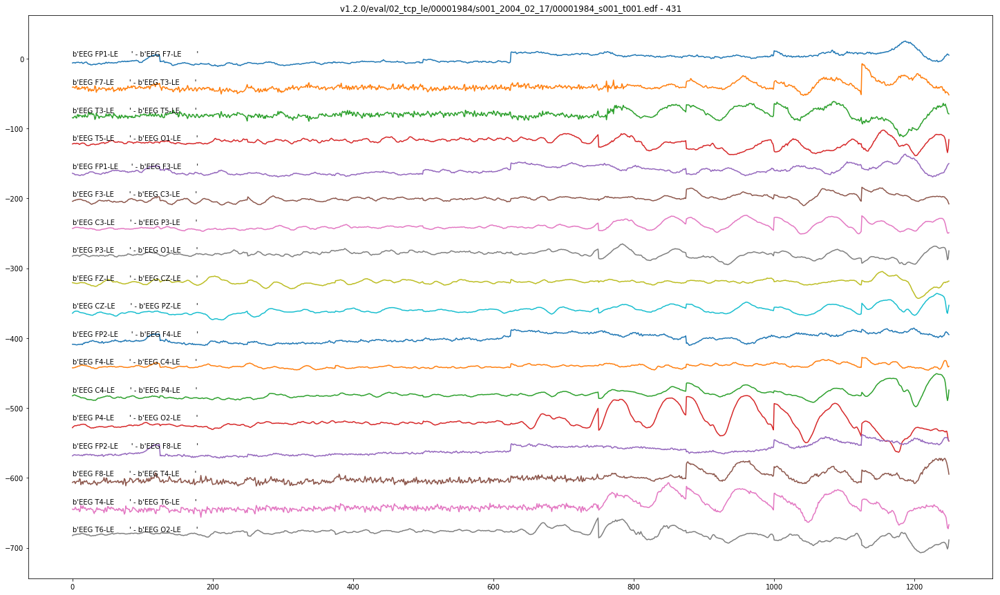

['557.1951', '565.2951']


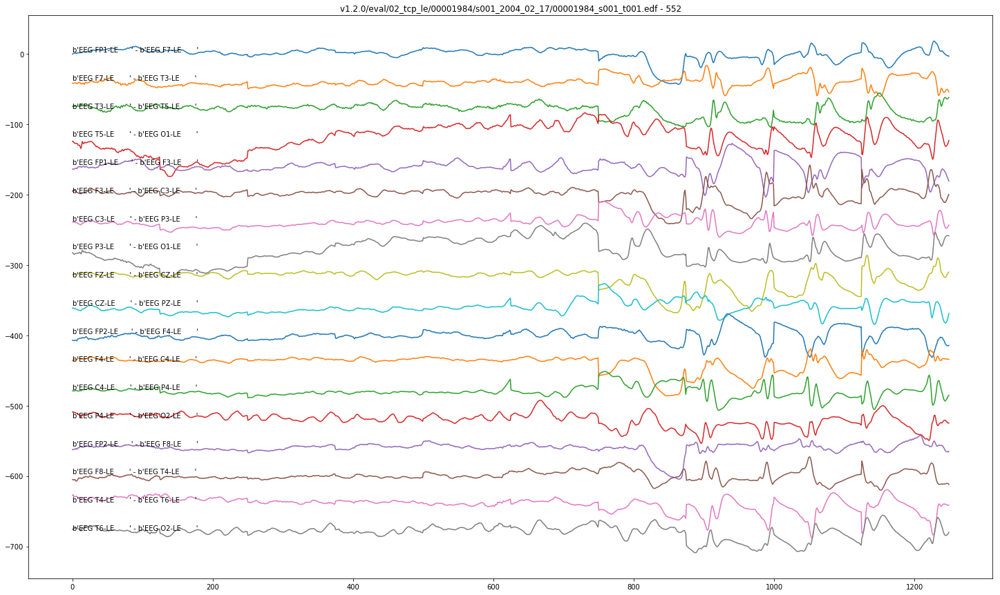

['763.2230', '775.3230']


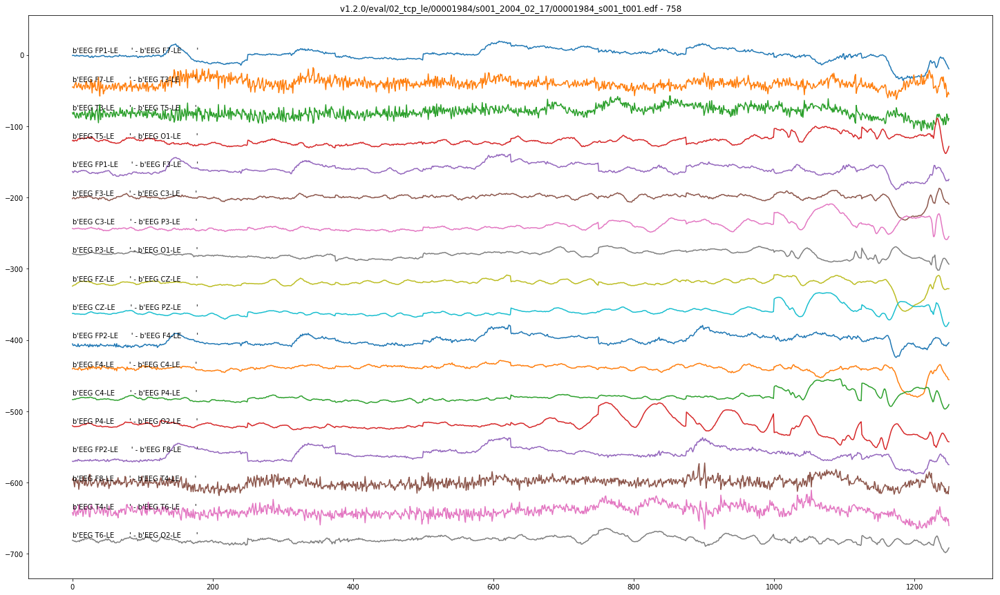

['802.1230', '810.3230']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['964.4951', '974.2951']


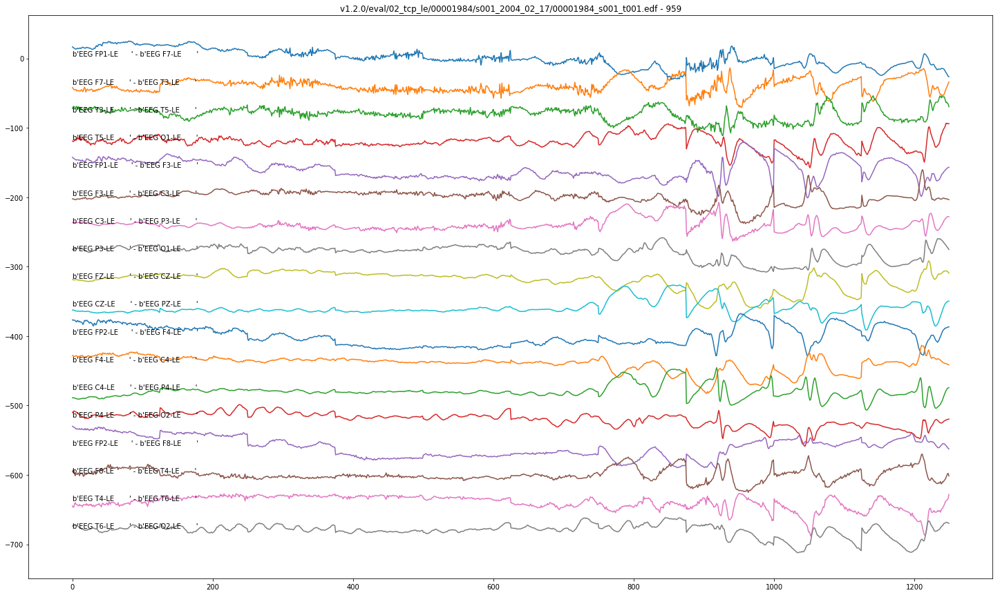

['1166.9836', '1173.5836']


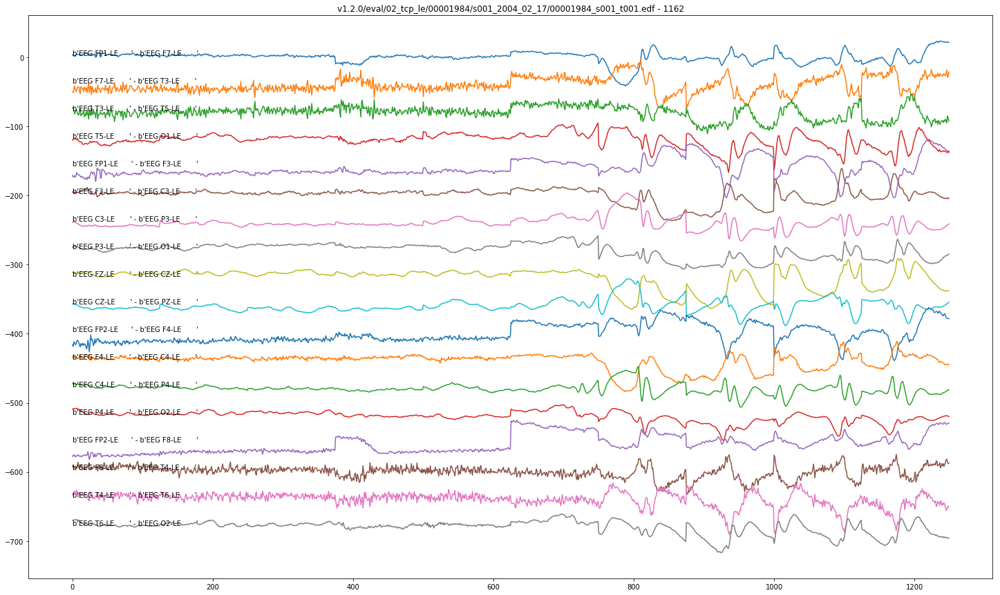

v1.2.0/eval/02_tcp_le/00000675/s002_2006_09_05/00000675_s002_t001.edf
['115.4115', '119.7115']


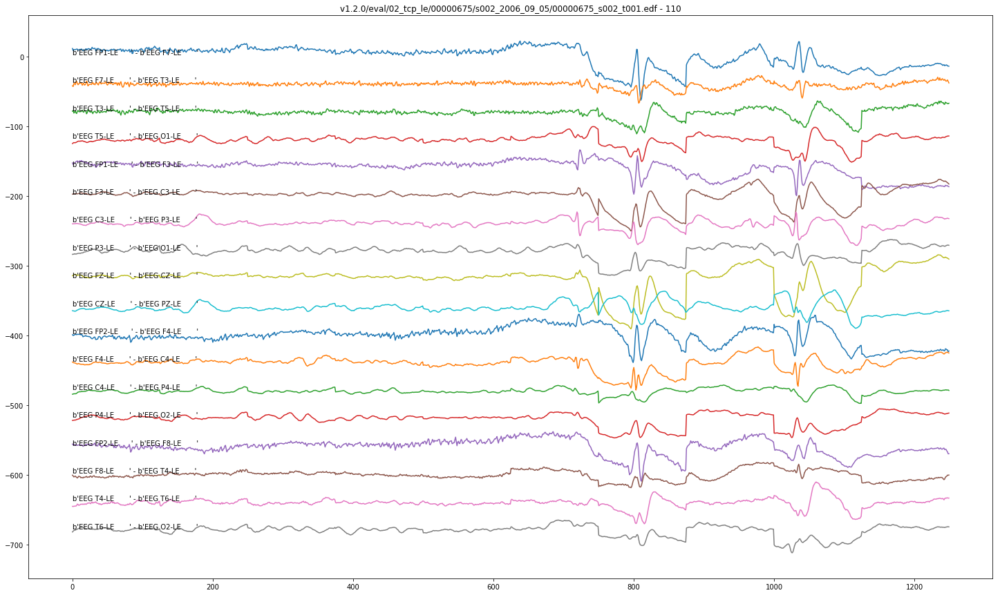

['155.7115', '160.6115']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['168.2115', '169.9115']


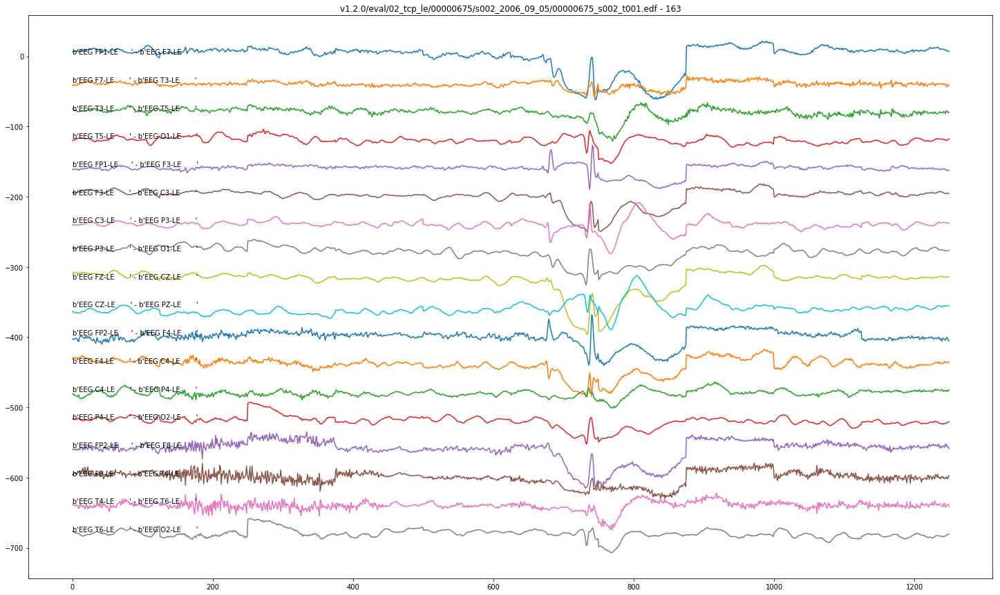

['181.3115', '185.1115']


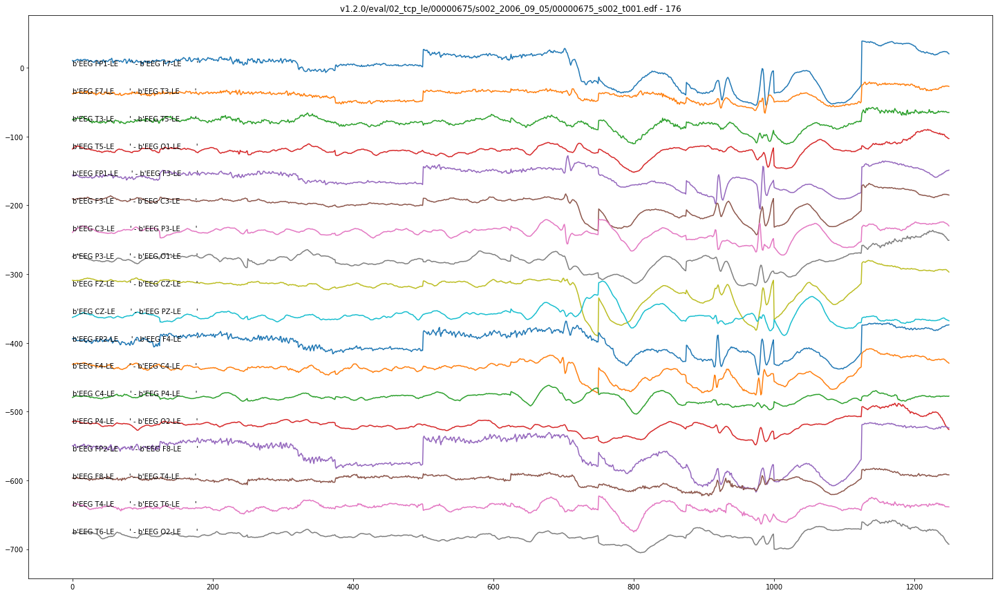

['205.4115', '210.2115']


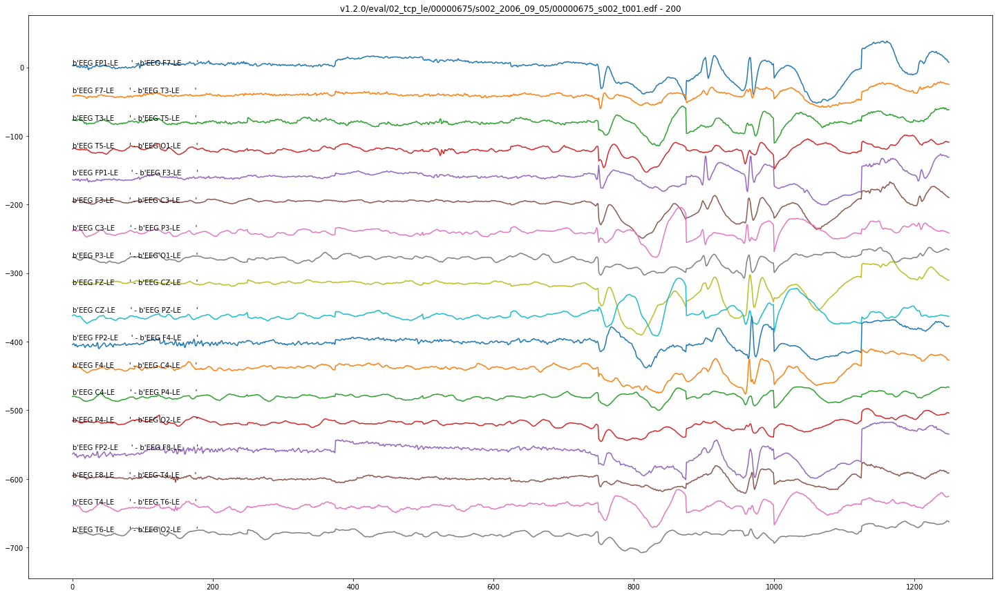

['232.1115', '234.1115']


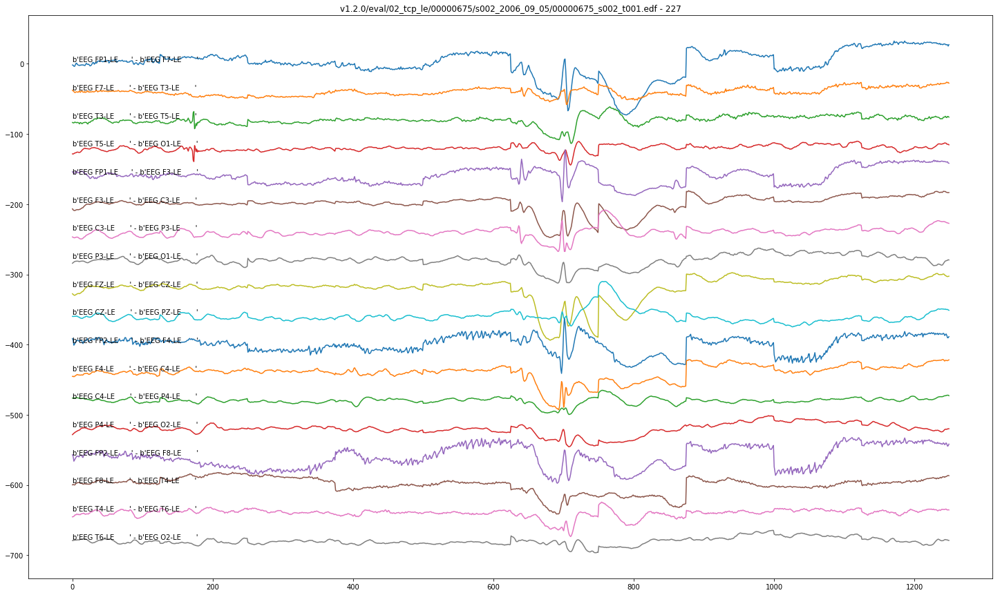

['244.3115', '246.3115']


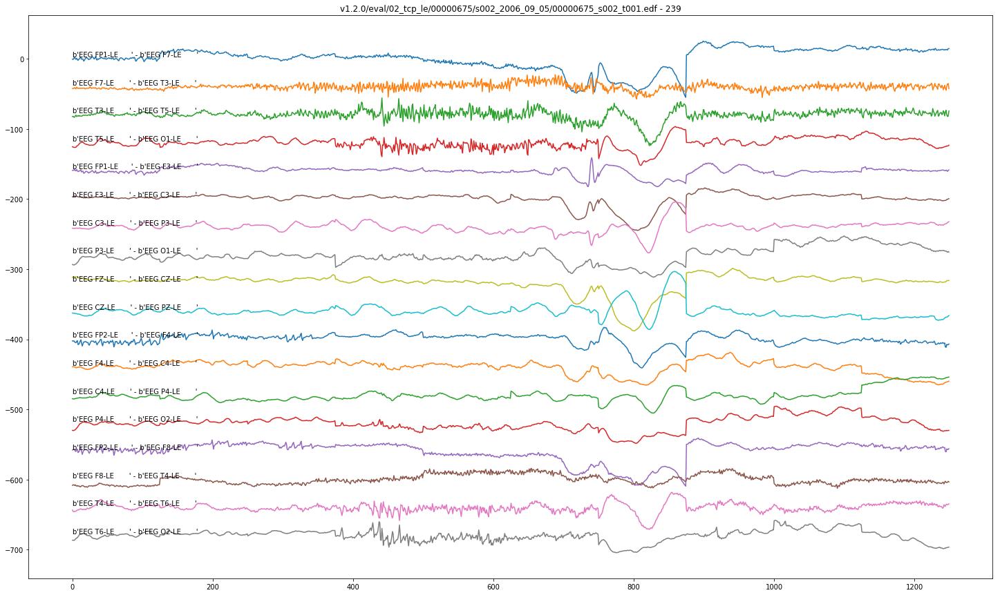

['251.5115', '254.3115']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['255.2115', '256.6115']


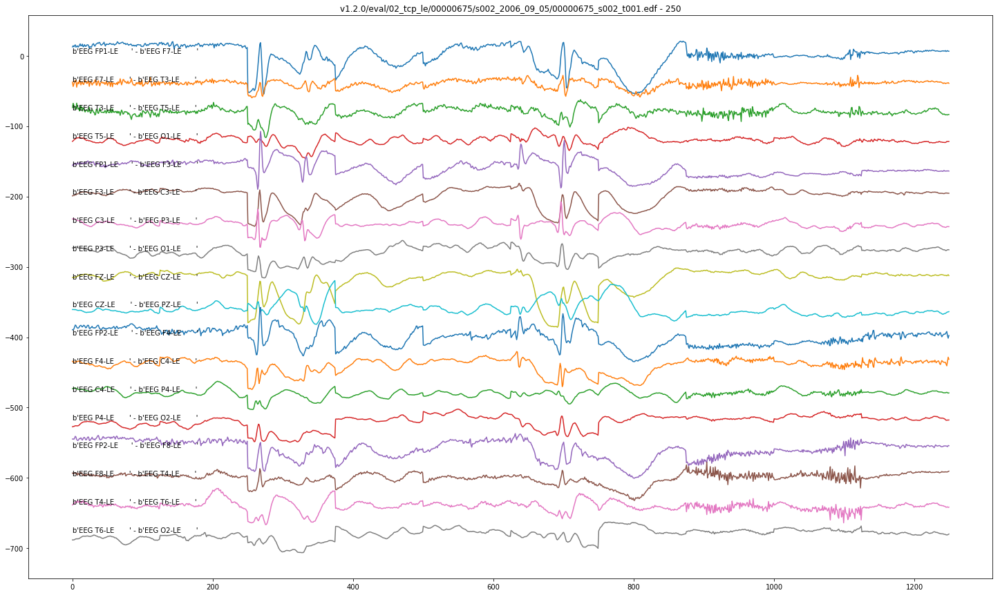

['313.4115', '319.7115']


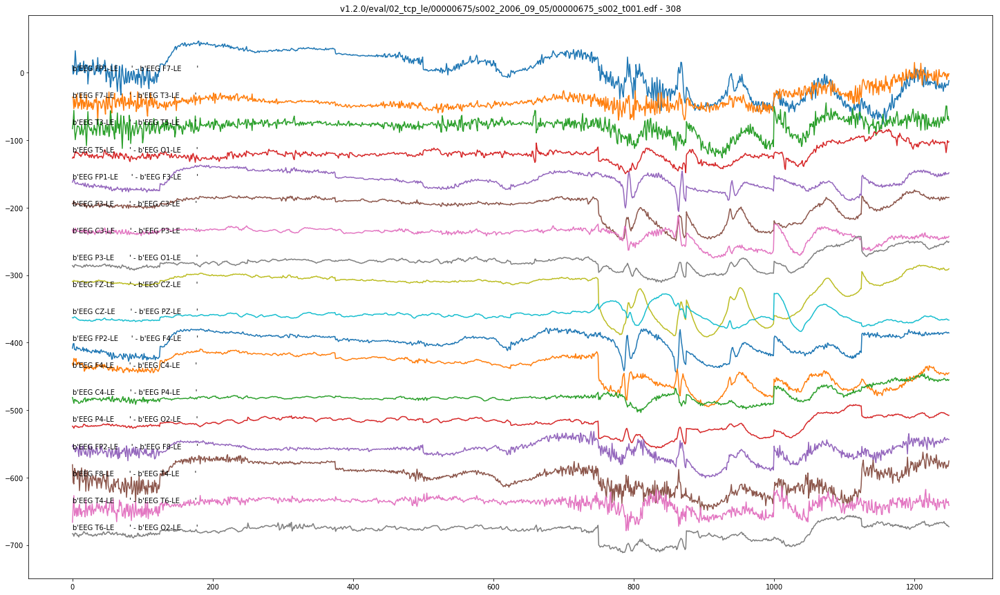

['554.7672', '558.9672']


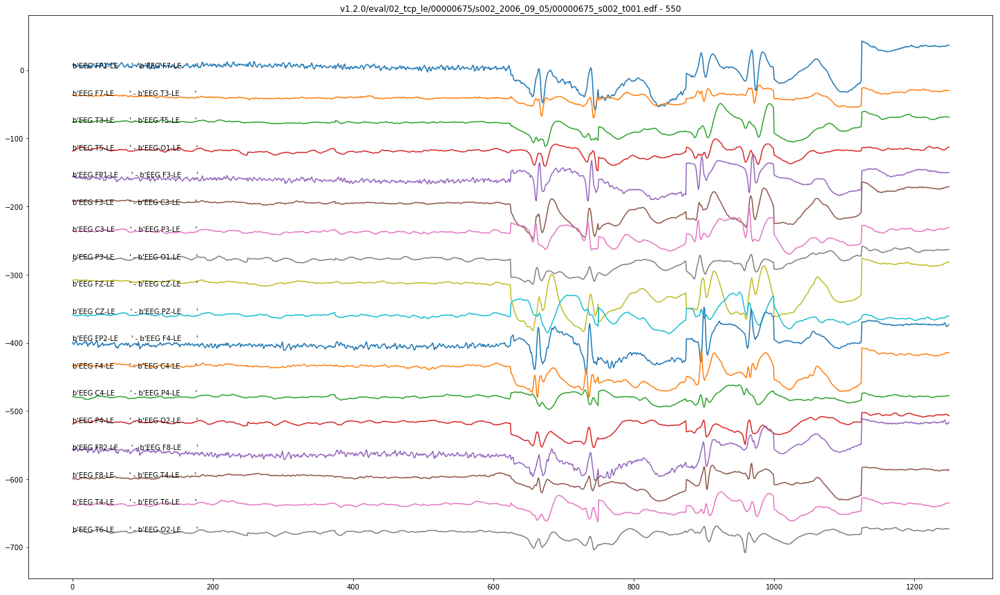

['777.1230', '783.6230']


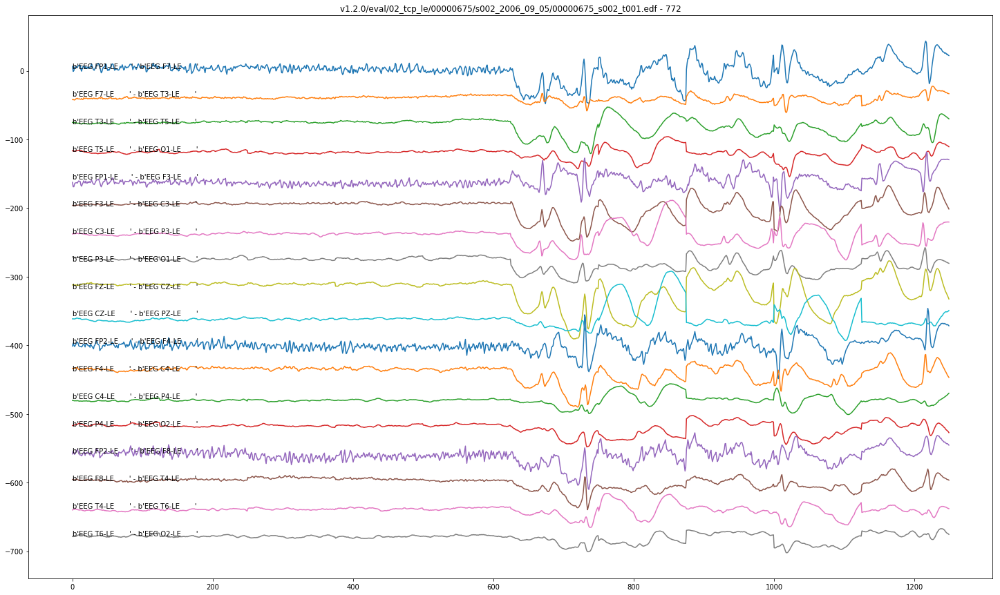

['1026.2115', '1028.2115']


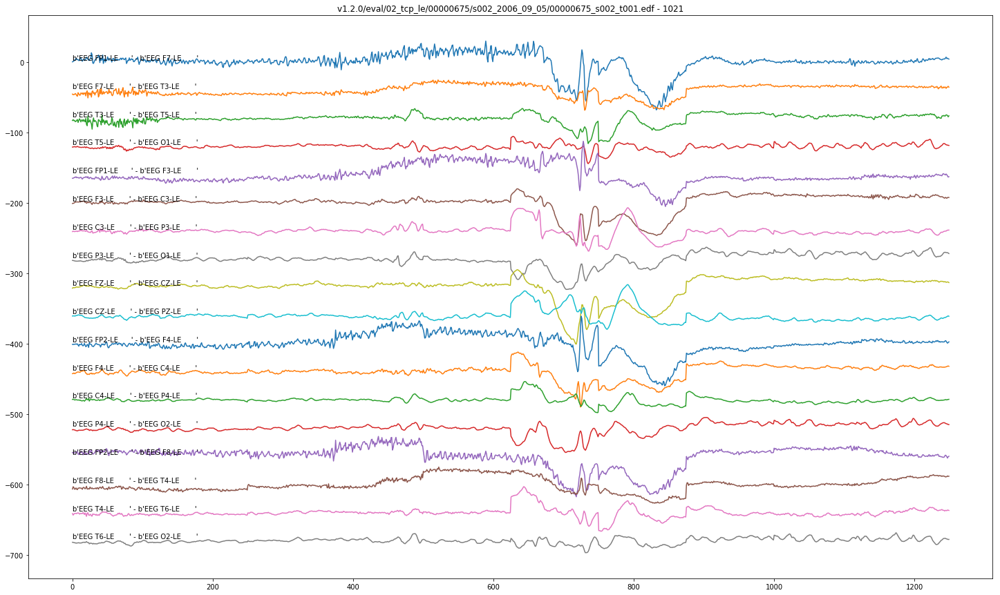

['1034.0115', '1037.3115']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['1045.0115', '1046.5115']


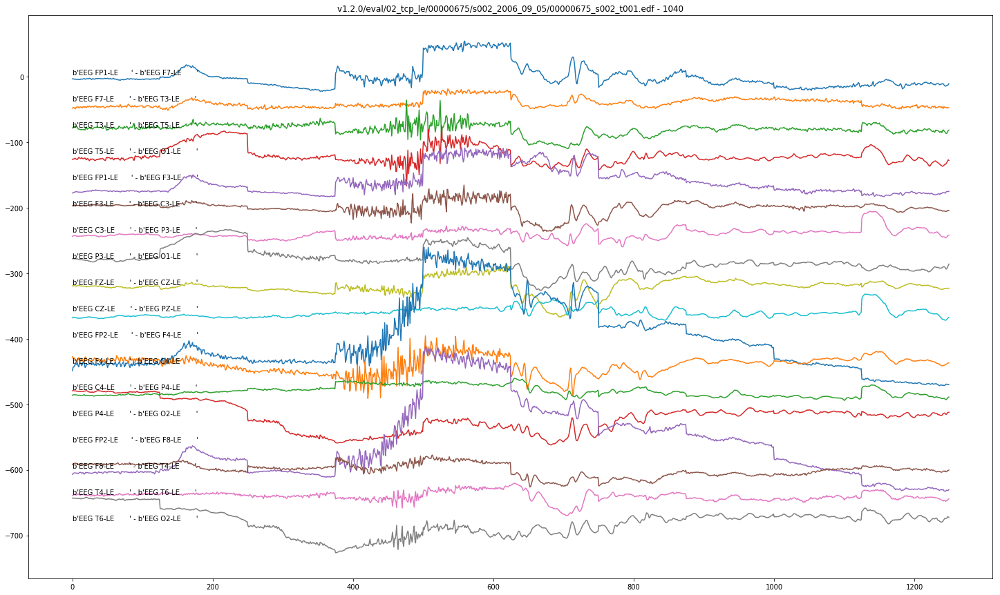

['1086.0115', '1088.0115']


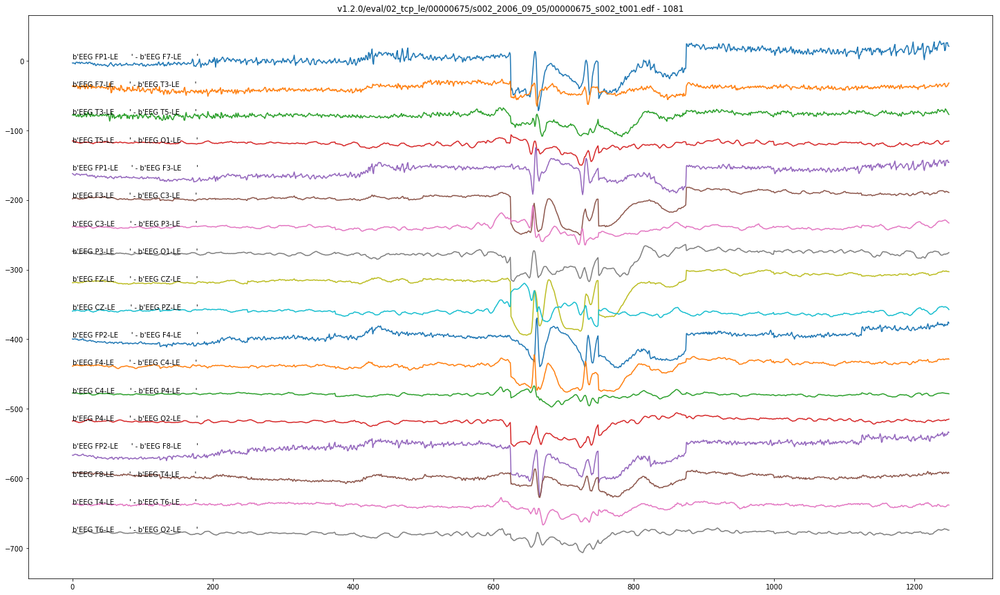

['1105.4115', '1107.8115']


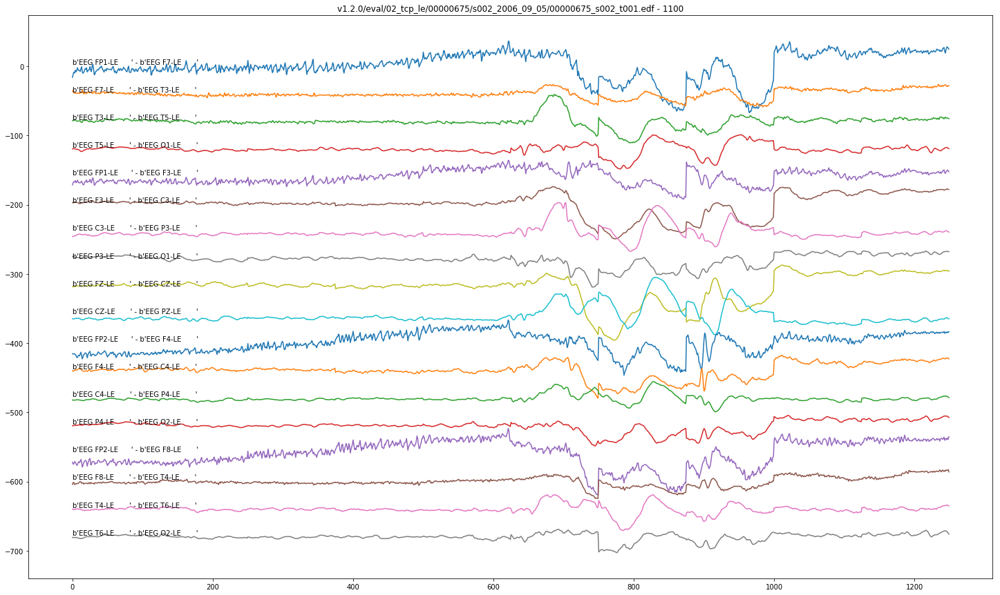

['1126.4115', '1129.4115']


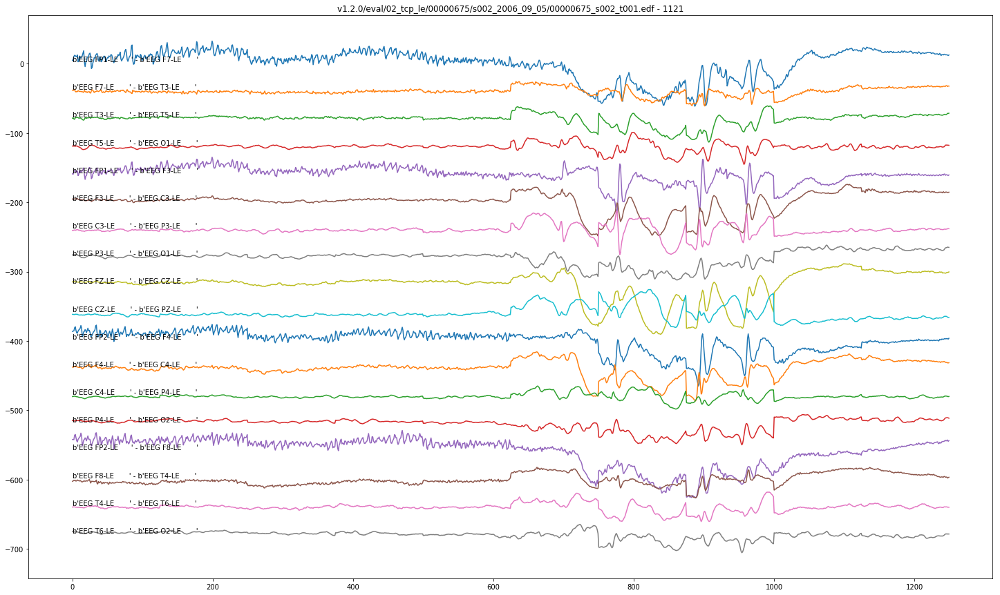

v1.2.0/eval/02_tcp_le/00000675/s001_2003_11_10/00000675_s001_t001.edf
['117.0669', '137.7669']


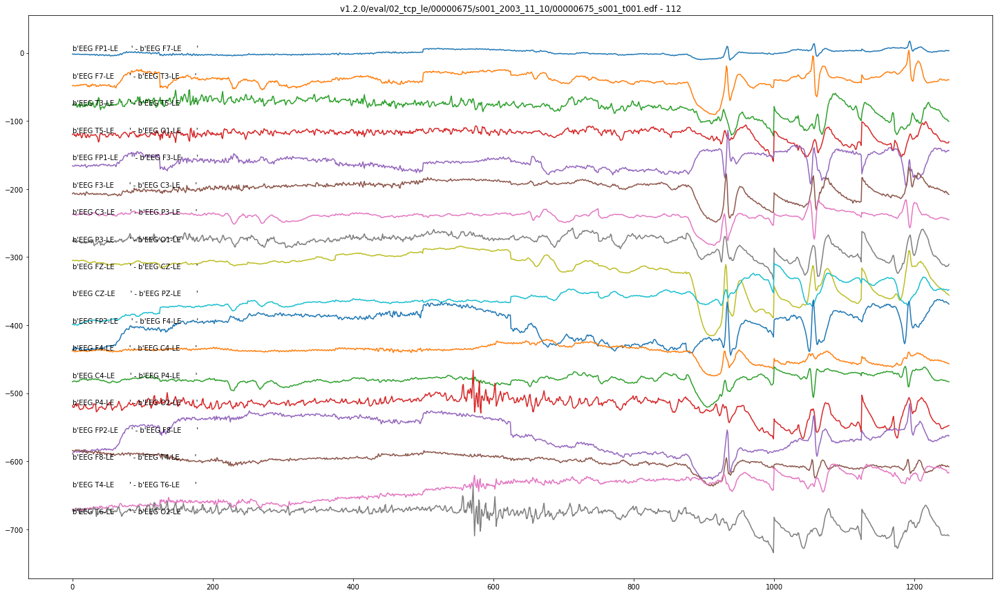

['266.6557', '282.5557']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['498.1672', '516.8672']


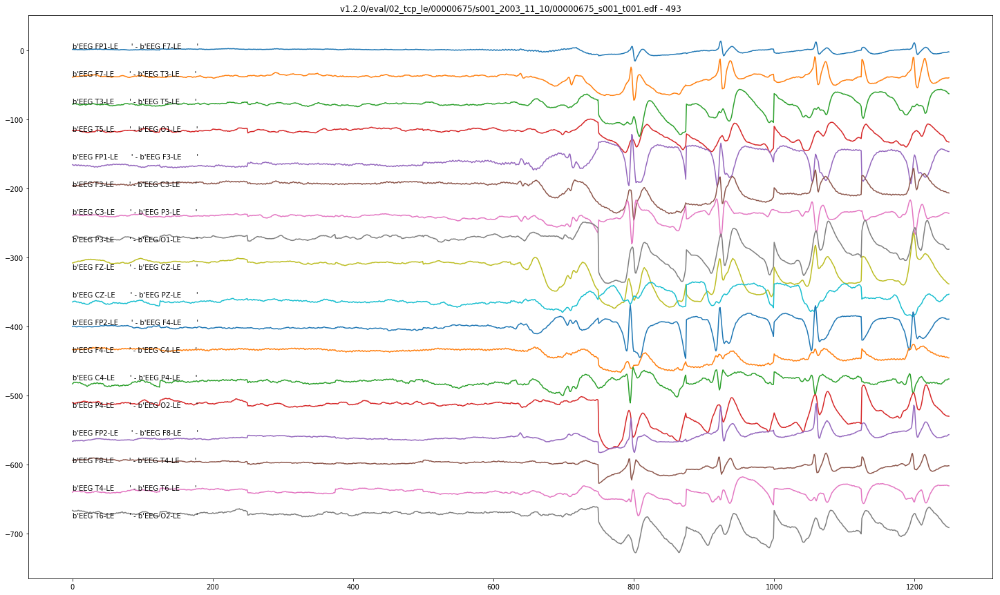

['592.0459', '609.0459']


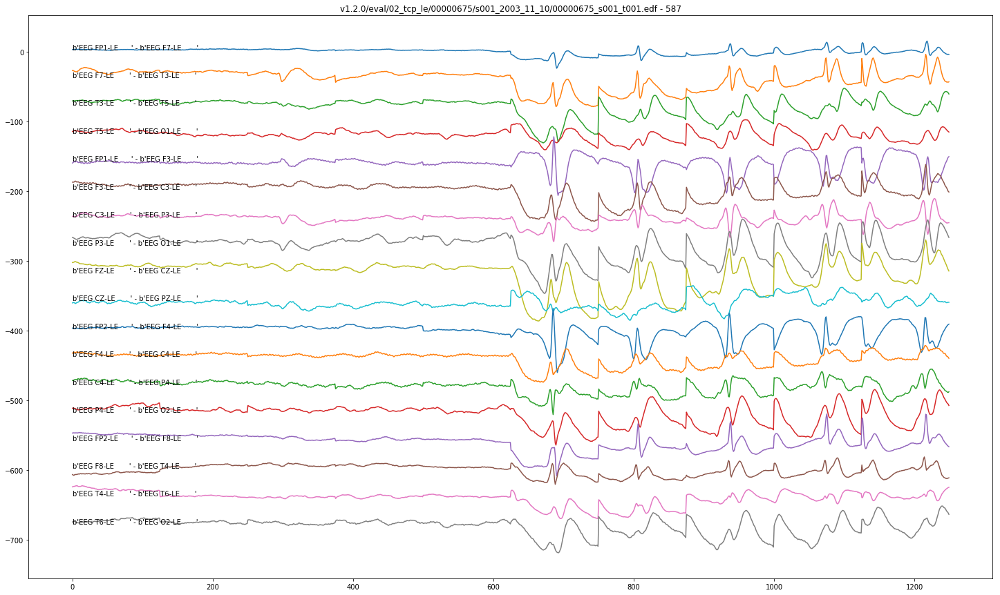

['739.0213', '754.2213']


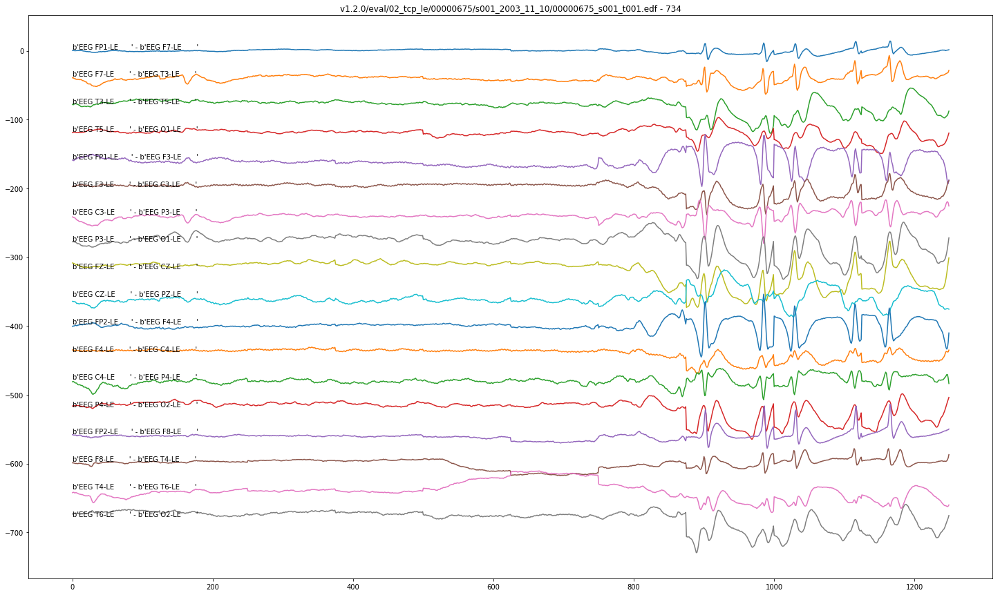

['833.9213', '844.2213']


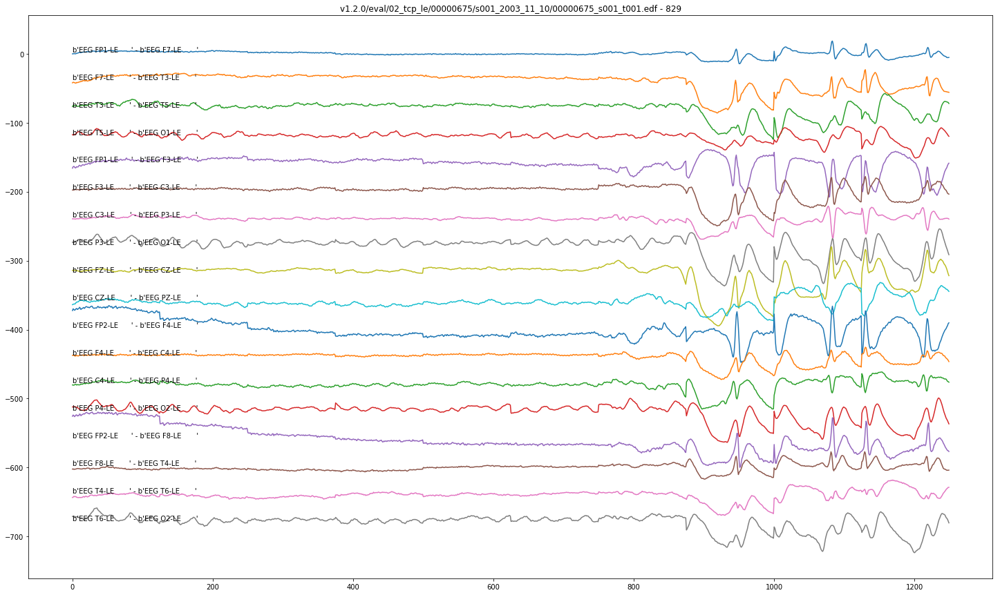

['939.9902', '949.4902']


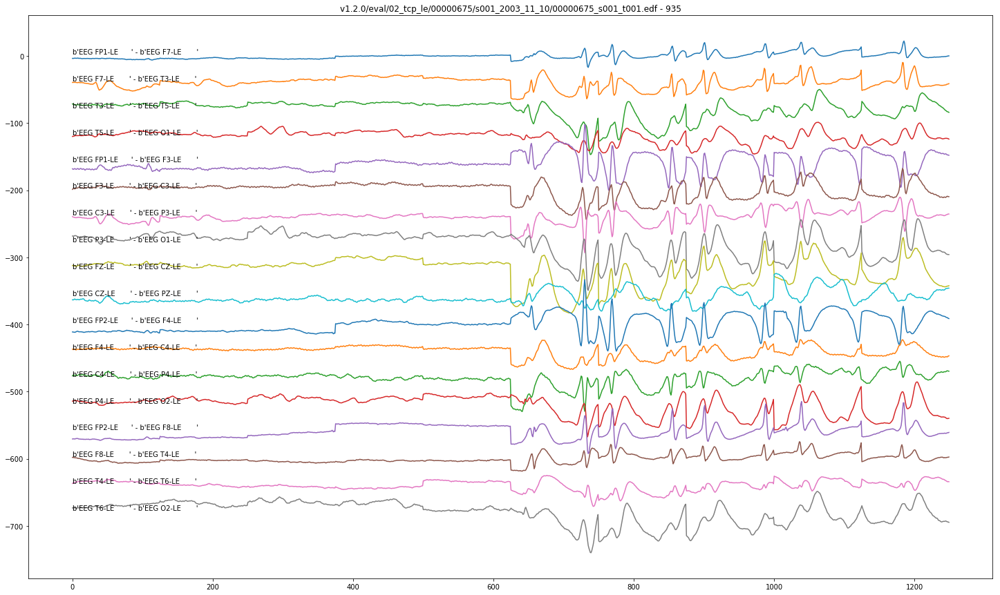

['1119.4017', '1141.3017']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [335]:
#Plot Samples
for filePath in abszSeizureSamples:
    print(filePath)
    for seizureLocation in abszSeizureSamples[filePath]:
        startOfEvent = int(round(float(seizureLocation[0]))) - 5
        timeToPlot = 10
        print(seizureLocation)
        edfFile = edfData(6)
        edfFile.loadFile(filePath)
        edfFile.parseEdf()

        plt.figure(figsize=(25,15))
        plotEDF(edfFile,longBipolarMontage2,startOfEvent,timeToPlot,0.1,dcFilter = True,filterOn = False)
    

<h1>Identify and label spikes for training and confirmation dataset</h1>

In [ ]:
def lookForPossibleChannelSpikes(edfObject,montageArray,stepSize,searchSize,ampThreshold,ptpThreshold,durationToCheck,filterTag=False,lowFilter=1,highFilter=40,ampThresholdConstant = True):
    '''
    data should already be scaled 
    stepSize: in mSec
    searchSize: in seconds
    ampThreshold: ratio of max to average or if ampThresholdConstant set to true then this is a uV threshold
    returns: Dictionary {MontageChannelIndex:[spikeIndices]}
    '''
    
    edfDataDictionary = edfObject.dataDictionary(0,durationToCheck)
    dataDictionaryKeys = list(edfDataDictionary.keys())
    possibleSpikeDictionary = {}
    for i,channel in enumerate(montageArray):
        channel1Index = channel[0]
        channel2Index = channel[1]
        channel1Label = dataDictionaryKeys[channel1Index]
        channel2Label = dataDictionaryKeys[channel2Index]
        channel1 = edfDataDictionary[channel1Label]
        channel2= edfDataDictionary[channel2Label]
        
        channel1DigMax = channel1['digMax']
        channel1PhysMax = channel1['physMax']
        channel2DigMax = channel2['digMax']
        channel2PhysMax = channel2['physMax']
        sampleRate = channel1['sampleRate']
        
        channel1ScaleFactor = channel1PhysMax/channel1DigMax
        channel2ScaleFactor = channel2PhysMax/channel2DigMax
        
        input1Data = np.array(edfDataDictionary[channel1Label]['data']) * channel1ScaleFactor
        input2Data = np.array(edfDataDictionary[channel2Label]['data']) * channel2ScaleFactor
        
        channelData = input1Data - input2Data 
        
        if filterTag == True:
            channelData = range_filter(channelData, lowFilter, highFilter, sampleRate, order = 5)
        
        sampleSearchSize = searchSize * sampleRate  #Size to search in each iteration
        stepSampleSize = int((stepSize/1000)*sampleRate)  #samples to move during each step
        totalSamples = durationToCheck * sampleRate  #Total Number of samples to check in data file
        numberOfSteps = int(totalSamples/stepSampleSize) #Total number of steps to take
        
        #print("SampleSearchSize: ",sampleSearchSize,"\nstepSampleSize: ",stepSampleSize,
        #    "\ntotalSamples: ",totalSamples,"\nnumberOfSteps: ",numberOfSteps)
    
        possibleSpikeArray = []
        
        for x in range(numberOfSteps):
            startIndex = x*stepSampleSize
            endIndex = (x*stepSampleSize)+sampleSearchSize
            segmentToCheck = channelData[startIndex:endIndex]
            segmentMax = np.amax(np.absolute(segmentToCheck))
            segmentPTP = np.ptp(segmentToCheck)
            segmentAverage = abs(np.average(segmentToCheck))
            freqs, pxx = scipy.signal.periodogram(segmentToCheck, sampleRate)
            if ampThresholdConstant == True:
                amplitudeThreshold = ampThreshold
            else:
                amplitudeThreshold = segmentAverage * ampThreshold
            ptpThreshold = segmentAverage * ptpThreshold
            #print("AmplitudeThreshold: ",amplitudeThreshold,"\nSegment Max: ",segmentMax,"\nSegmentPTP: ",segmentPTP,
            #     "\nSegmentAverage: ",segmentAverage, "StartIndex: ",startIndex)
            #print("StartIndex: ",startIndex,"\nEndIndex: ",endIndex,"\nSegmentAverage: ",segmentAverage,
            #    "/nsegmentMax: ",segmentMax,"\nAmplitudeThreshold: ", amplitudeThreshold,"\nptpThreshold: ",ptpThreshold)
            if segmentMax > amplitudeThreshold and segmentPTP > amplitudeThreshold:
                try:
                    possibleSegmentIndex = list(segmentToCheck).index(segmentMax)
                except:
                    possibleSegmentIndex = list(segmentToCheck).index(0-segmentMax)
                    
                channelSpikeIndex = startIndex + possibleSegmentIndex
                if channelSpikeIndex not in possibleSpikeArray: 
                    possibleSpikeArray.append(channelSpikeIndex)
        
        possibleSpikeDictionary[i] = possibleSpikeArray
    return possibleSpikeDictionary
                    
                    
    


def checkQuadrants(indexDict,adjacencyArray,edfObject,latencyAllowed):
    '''
    Ths function makes sure that a possible spike exists at the same time in more than one channel.
    adjacencyArray: list of lists containing channel indices in quadrant
    indexDict: {channelNumber:[spikeCandidates]}
    latencyAllowed: latency in mSec allowed, distance between spikes in different channels
    
    returns: List of Lists containing possible spikes indices in each quadrant
    '''
    spikeCandidatesFinal = []
    sampleRate = edfObject.getSampleRate()
    spikeDistanceAllowed = latencyAllowed/sampleRate
    for quadrant in adjacencyArray:
        quadrantCandidates = []
        for channelIndex in quadrant: 
            for spikeIndex in indexDict[channelIndex]:
                quadrantCandidates.append(spikeIndex)
        #print("Quadrant1:",len(quadrantCandidates))
        isolatesRemoved = removeIsolatedSpikes(sampleRate,quadrantCandidates,latencyAllowed)
        spikeCandidatesFinal.append(isolatesRemoved)
    return spikeCandidatesFinal
                
                

def removeIsolatedSpikes(sampleRate,quadrantSpikesIn,latencyAllowedIn):
    '''
    Run this only in checkQuadrants!
    indexArray: Array of indices of possible spikes in a quadrant
    sampleRate: sampleRate of data
    latencyAllowed: distance between possible spikes in msec
    
    To do: Add adjacency coefficient
    '''
    returnList = []
    #print("LEN in",len(quadrantSpikesIn))
    quadrantSpikesIn.sort() 
    numberOfSpikes = len(quadrantSpikesIn)
    indexDistanceLimit = (latencyAllowedIn/1000) * sampleRate
    for i in range(numberOfSpikes-2):
        if i ==0:
            pass
        else:
            distanceLeft = abs(quadrantSpikesIn[i]-quadrantSpikesIn[i+1])
            distanceRight = abs(quadrantSpikesIn[i]-quadrantSpikesIn[i-1])
            if distanceLeft > indexDistanceLimit and distanceRight > indexDistanceLimit:
                pass
                #print("Removed, no adjaceny")
            else:
                returnList.append(quadrantSpikesIn[i])
    return returnList
            

def removeCloseSpikes(indexArray,edfObject,minDistanceBetweenSpikes):
    '''
    indexArray: Array of indices of possible spikes in a quadrant
    sampleRate: sampleRate of data
    latencyAllowed: distance between possible spikes in msec
    '''
    edfSampleRate = edfObject.getSampleRate()
    indexArray.sort()
    latencySamplesAllowed = (minDistanceBetweenSpikes/1000) * edfSampleRate
    returnArray = []
    indexLength = len(indexArray)
    removed = 0
    for i, x in enumerate(indexArray):
        sampleDistance = 1
        if i <= 1:
            returnArray.append(x)
        else:
            returnLength = len(returnArray)
            if (x-returnArray[returnLength-1]) > latencySamplesAllowed:
                returnArray.append(x)
            else:
                removed+=1
    #print("Removed: ",removed)
    return returnArray

In [126]:
#lookForPossibleChannelSpikes(edfObject,montageArray,stepSize,searchSize,ampThreshold,ptpThreshold,durationToCheck,filterTag=False,loFilter=1,highFilter=40,ampThresholdConstant = True)
possibleSpikesPrelim = lookForPossibleChannelSpikes(trainingEDF1,longBipolarMontage,150,1,100,3,120,filterTag=True,lowFilter=1,highFilter=40)
possibleSpikesPrelimPredict = lookForPossibleChannelSpikes(predictEDF1,longBipolarMontage,150,1,100,3,120,filterTag=True,lowFilter=1,highFilter=40)

IN CHANNEL DATA FUNCTION
Channel Sample Rate:  250
Sample Durations:  1.0
Channel Index:  0
Skipping:  0
Record Byte Length:  16506
headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i
Read INDEX:  25978
I VALUE RIGHT NOW IS:  0
Getting DATA FROM INDEX:   9472
READ DATA TO INDEX:  9722
I VALUE RIGHT NOW IS:  1
Getting DATA FROM INDEX:   25978
READ DATA TO INDEX:  26228
I VALUE RIGHT NOW IS:  2
Getting DATA FROM INDEX:   42484
READ DATA TO INDEX:  42734
I VALUE RIGHT NOW IS:  3
Getting DATA FROM INDEX:   58990
READ DATA TO INDEX:  59240
I VALUE RIGHT NOW IS:  4
Getting DATA FROM INDEX:   75496
READ DATA TO INDEX:  75746
I VALUE RIGHT NOW IS:  5
Getting DATA FROM INDEX:   92002
READ DATA TO INDEX:  92252
I VALUE RIGHT NOW IS:  6
Getting DATA FROM INDEX:   108508
READ DATA TO INDEX:  108758
I VALUE RIGHT NOW IS:  7
Getting DATA FROM INDEX:   125014
READ DATA TO INDEX:  125264
I VALUE RIGHT NOW IS:  8
Getting DATA FROM INDEX:   141520
READ DATA TO INDEX:  141770
I VALUE

Getting DATA FROM INDEX:   1891156
READ DATA TO INDEX:  1891406
I VALUE RIGHT NOW IS:  115
Getting DATA FROM INDEX:   1907662
READ DATA TO INDEX:  1907912
I VALUE RIGHT NOW IS:  116
Getting DATA FROM INDEX:   1924168
READ DATA TO INDEX:  1924418
I VALUE RIGHT NOW IS:  117
Getting DATA FROM INDEX:   1940674
READ DATA TO INDEX:  1940924
I VALUE RIGHT NOW IS:  118
Getting DATA FROM INDEX:   1957180
READ DATA TO INDEX:  1957430
I VALUE RIGHT NOW IS:  119
Getting DATA FROM INDEX:   1973686
READ DATA TO INDEX:  1973936
IN CHANNEL DATA FUNCTION
Channel Sample Rate:  250
Sample Durations:  1.0
Channel Index:  500
Skipping:  0
Record Byte Length:  16506
headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i
Read INDEX:  26478
I VALUE RIGHT NOW IS:  0
Getting DATA FROM INDEX:   9972
READ DATA TO INDEX:  10222
I VALUE RIGHT NOW IS:  1
Getting DATA FROM INDEX:   26478
READ DATA TO INDEX:  26728
I VALUE RIGHT NOW IS:  2
Getting DATA FROM INDEX:   42984
READ DATA TO INDEX:  43234
I

Getting DATA FROM INDEX:   1396976
READ DATA TO INDEX:  1397226
I VALUE RIGHT NOW IS:  85
Getting DATA FROM INDEX:   1413482
READ DATA TO INDEX:  1413732
I VALUE RIGHT NOW IS:  86
Getting DATA FROM INDEX:   1429988
READ DATA TO INDEX:  1430238
I VALUE RIGHT NOW IS:  87
Getting DATA FROM INDEX:   1446494
READ DATA TO INDEX:  1446744
I VALUE RIGHT NOW IS:  88
Getting DATA FROM INDEX:   1463000
READ DATA TO INDEX:  1463250
I VALUE RIGHT NOW IS:  89
Getting DATA FROM INDEX:   1479506
READ DATA TO INDEX:  1479756
I VALUE RIGHT NOW IS:  90
Getting DATA FROM INDEX:   1496012
READ DATA TO INDEX:  1496262
I VALUE RIGHT NOW IS:  91
Getting DATA FROM INDEX:   1512518
READ DATA TO INDEX:  1512768
I VALUE RIGHT NOW IS:  92
Getting DATA FROM INDEX:   1529024
READ DATA TO INDEX:  1529274
I VALUE RIGHT NOW IS:  93
Getting DATA FROM INDEX:   1545530
READ DATA TO INDEX:  1545780
I VALUE RIGHT NOW IS:  94
Getting DATA FROM INDEX:   1562036
READ DATA TO INDEX:  1562286
I VALUE RIGHT NOW IS:  95
Getting DA

I VALUE RIGHT NOW IS:  100
Getting DATA FROM INDEX:   1662072
READ DATA TO INDEX:  1662322
I VALUE RIGHT NOW IS:  101
Getting DATA FROM INDEX:   1678578
READ DATA TO INDEX:  1678828
I VALUE RIGHT NOW IS:  102
Getting DATA FROM INDEX:   1695084
READ DATA TO INDEX:  1695334
I VALUE RIGHT NOW IS:  103
Getting DATA FROM INDEX:   1711590
READ DATA TO INDEX:  1711840
I VALUE RIGHT NOW IS:  104
Getting DATA FROM INDEX:   1728096
READ DATA TO INDEX:  1728346
I VALUE RIGHT NOW IS:  105
Getting DATA FROM INDEX:   1744602
READ DATA TO INDEX:  1744852
I VALUE RIGHT NOW IS:  106
Getting DATA FROM INDEX:   1761108
READ DATA TO INDEX:  1761358
I VALUE RIGHT NOW IS:  107
Getting DATA FROM INDEX:   1777614
READ DATA TO INDEX:  1777864
I VALUE RIGHT NOW IS:  108
Getting DATA FROM INDEX:   1794120
READ DATA TO INDEX:  1794370
I VALUE RIGHT NOW IS:  109
Getting DATA FROM INDEX:   1810626
READ DATA TO INDEX:  1810876
I VALUE RIGHT NOW IS:  110
Getting DATA FROM INDEX:   1827132
READ DATA TO INDEX:  1827382

Getting DATA FROM INDEX:   1894156
READ DATA TO INDEX:  1894406
I VALUE RIGHT NOW IS:  115
Getting DATA FROM INDEX:   1910662
READ DATA TO INDEX:  1910912
I VALUE RIGHT NOW IS:  116
Getting DATA FROM INDEX:   1927168
READ DATA TO INDEX:  1927418
I VALUE RIGHT NOW IS:  117
Getting DATA FROM INDEX:   1943674
READ DATA TO INDEX:  1943924
I VALUE RIGHT NOW IS:  118
Getting DATA FROM INDEX:   1960180
READ DATA TO INDEX:  1960430
I VALUE RIGHT NOW IS:  119
Getting DATA FROM INDEX:   1976686
READ DATA TO INDEX:  1976936
IN CHANNEL DATA FUNCTION
Channel Sample Rate:  250
Sample Durations:  1.0
Channel Index:  3500
Skipping:  0
Record Byte Length:  16506
headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i
Read INDEX:  29478
I VALUE RIGHT NOW IS:  0
Getting DATA FROM INDEX:   12972
READ DATA TO INDEX:  13222
I VALUE RIGHT NOW IS:  1
Getting DATA FROM INDEX:   29478
READ DATA TO INDEX:  29728
I VALUE RIGHT NOW IS:  2
Getting DATA FROM INDEX:   45984
READ DATA TO INDEX:  46234

Getting DATA FROM INDEX:   1053350
READ DATA TO INDEX:  1053600
I VALUE RIGHT NOW IS:  64
Getting DATA FROM INDEX:   1069856
READ DATA TO INDEX:  1070106
I VALUE RIGHT NOW IS:  65
Getting DATA FROM INDEX:   1086362
READ DATA TO INDEX:  1086612
I VALUE RIGHT NOW IS:  66
Getting DATA FROM INDEX:   1102868
READ DATA TO INDEX:  1103118
I VALUE RIGHT NOW IS:  67
Getting DATA FROM INDEX:   1119374
READ DATA TO INDEX:  1119624
I VALUE RIGHT NOW IS:  68
Getting DATA FROM INDEX:   1135880
READ DATA TO INDEX:  1136130
I VALUE RIGHT NOW IS:  69
Getting DATA FROM INDEX:   1152386
READ DATA TO INDEX:  1152636
I VALUE RIGHT NOW IS:  70
Getting DATA FROM INDEX:   1168892
READ DATA TO INDEX:  1169142
I VALUE RIGHT NOW IS:  71
Getting DATA FROM INDEX:   1185398
READ DATA TO INDEX:  1185648
I VALUE RIGHT NOW IS:  72
Getting DATA FROM INDEX:   1201904
READ DATA TO INDEX:  1202154
I VALUE RIGHT NOW IS:  73
Getting DATA FROM INDEX:   1218410
READ DATA TO INDEX:  1218660
I VALUE RIGHT NOW IS:  74
Getting DA

Getting DATA FROM INDEX:   1632060
READ DATA TO INDEX:  1632310
I VALUE RIGHT NOW IS:  99
Getting DATA FROM INDEX:   1648566
READ DATA TO INDEX:  1648816
I VALUE RIGHT NOW IS:  100
Getting DATA FROM INDEX:   1665072
READ DATA TO INDEX:  1665322
I VALUE RIGHT NOW IS:  101
Getting DATA FROM INDEX:   1681578
READ DATA TO INDEX:  1681828
I VALUE RIGHT NOW IS:  102
Getting DATA FROM INDEX:   1698084
READ DATA TO INDEX:  1698334
I VALUE RIGHT NOW IS:  103
Getting DATA FROM INDEX:   1714590
READ DATA TO INDEX:  1714840
I VALUE RIGHT NOW IS:  104
Getting DATA FROM INDEX:   1731096
READ DATA TO INDEX:  1731346
I VALUE RIGHT NOW IS:  105
Getting DATA FROM INDEX:   1747602
READ DATA TO INDEX:  1747852
I VALUE RIGHT NOW IS:  106
Getting DATA FROM INDEX:   1764108
READ DATA TO INDEX:  1764358
I VALUE RIGHT NOW IS:  107
Getting DATA FROM INDEX:   1780614
READ DATA TO INDEX:  1780864
I VALUE RIGHT NOW IS:  108
Getting DATA FROM INDEX:   1797120
READ DATA TO INDEX:  1797370
I VALUE RIGHT NOW IS:  109


I VALUE RIGHT NOW IS:  104
Getting DATA FROM INDEX:   1732096
READ DATA TO INDEX:  1732346
I VALUE RIGHT NOW IS:  105
Getting DATA FROM INDEX:   1748602
READ DATA TO INDEX:  1748852
I VALUE RIGHT NOW IS:  106
Getting DATA FROM INDEX:   1765108
READ DATA TO INDEX:  1765358
I VALUE RIGHT NOW IS:  107
Getting DATA FROM INDEX:   1781614
READ DATA TO INDEX:  1781864
I VALUE RIGHT NOW IS:  108
Getting DATA FROM INDEX:   1798120
READ DATA TO INDEX:  1798370
I VALUE RIGHT NOW IS:  109
Getting DATA FROM INDEX:   1814626
READ DATA TO INDEX:  1814876
I VALUE RIGHT NOW IS:  110
Getting DATA FROM INDEX:   1831132
READ DATA TO INDEX:  1831382
I VALUE RIGHT NOW IS:  111
Getting DATA FROM INDEX:   1847638
READ DATA TO INDEX:  1847888
I VALUE RIGHT NOW IS:  112
Getting DATA FROM INDEX:   1864144
READ DATA TO INDEX:  1864394
I VALUE RIGHT NOW IS:  113
Getting DATA FROM INDEX:   1880650
READ DATA TO INDEX:  1880900
I VALUE RIGHT NOW IS:  114
Getting DATA FROM INDEX:   1897156
READ DATA TO INDEX:  1897406

Getting DATA FROM INDEX:   1287434
READ DATA TO INDEX:  1287684
I VALUE RIGHT NOW IS:  78
Getting DATA FROM INDEX:   1303940
READ DATA TO INDEX:  1304190
I VALUE RIGHT NOW IS:  79
Getting DATA FROM INDEX:   1320446
READ DATA TO INDEX:  1320696
I VALUE RIGHT NOW IS:  80
Getting DATA FROM INDEX:   1336952
READ DATA TO INDEX:  1337202
I VALUE RIGHT NOW IS:  81
Getting DATA FROM INDEX:   1353458
READ DATA TO INDEX:  1353708
I VALUE RIGHT NOW IS:  82
Getting DATA FROM INDEX:   1369964
READ DATA TO INDEX:  1370214
I VALUE RIGHT NOW IS:  83
Getting DATA FROM INDEX:   1386470
READ DATA TO INDEX:  1386720
I VALUE RIGHT NOW IS:  84
Getting DATA FROM INDEX:   1402976
READ DATA TO INDEX:  1403226
I VALUE RIGHT NOW IS:  85
Getting DATA FROM INDEX:   1419482
READ DATA TO INDEX:  1419732
I VALUE RIGHT NOW IS:  86
Getting DATA FROM INDEX:   1435988
READ DATA TO INDEX:  1436238
I VALUE RIGHT NOW IS:  87
Getting DATA FROM INDEX:   1452494
READ DATA TO INDEX:  1452744
I VALUE RIGHT NOW IS:  88
Getting DA

Getting DATA FROM INDEX:   1866144
READ DATA TO INDEX:  1866394
I VALUE RIGHT NOW IS:  113
Getting DATA FROM INDEX:   1882650
READ DATA TO INDEX:  1882900
I VALUE RIGHT NOW IS:  114
Getting DATA FROM INDEX:   1899156
READ DATA TO INDEX:  1899406
I VALUE RIGHT NOW IS:  115
Getting DATA FROM INDEX:   1915662
READ DATA TO INDEX:  1915912
I VALUE RIGHT NOW IS:  116
Getting DATA FROM INDEX:   1932168
READ DATA TO INDEX:  1932418
I VALUE RIGHT NOW IS:  117
Getting DATA FROM INDEX:   1948674
READ DATA TO INDEX:  1948924
I VALUE RIGHT NOW IS:  118
Getting DATA FROM INDEX:   1965180
READ DATA TO INDEX:  1965430
I VALUE RIGHT NOW IS:  119
Getting DATA FROM INDEX:   1981686
READ DATA TO INDEX:  1981936
IN CHANNEL DATA FUNCTION
Channel Sample Rate:  250
Sample Durations:  1.0
Channel Index:  8500
Skipping:  0
Record Byte Length:  16506
headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i
Read INDEX:  34478
I VALUE RIGHT NOW IS:  0
Getting DATA FROM INDEX:   17972
READ DATA TO I

IN CHANNEL DATA FUNCTION
Channel Sample Rate:  250
Sample Durations:  1.0
Channel Index:  9500
Skipping:  0
Record Byte Length:  16506
headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i
Read INDEX:  35478
I VALUE RIGHT NOW IS:  0
Getting DATA FROM INDEX:   18972
READ DATA TO INDEX:  19222
I VALUE RIGHT NOW IS:  1
Getting DATA FROM INDEX:   35478
READ DATA TO INDEX:  35728
I VALUE RIGHT NOW IS:  2
Getting DATA FROM INDEX:   51984
READ DATA TO INDEX:  52234
I VALUE RIGHT NOW IS:  3
Getting DATA FROM INDEX:   68490
READ DATA TO INDEX:  68740
I VALUE RIGHT NOW IS:  4
Getting DATA FROM INDEX:   84996
READ DATA TO INDEX:  85246
I VALUE RIGHT NOW IS:  5
Getting DATA FROM INDEX:   101502
READ DATA TO INDEX:  101752
I VALUE RIGHT NOW IS:  6
Getting DATA FROM INDEX:   118008
READ DATA TO INDEX:  118258
I VALUE RIGHT NOW IS:  7
Getting DATA FROM INDEX:   134514
READ DATA TO INDEX:  134764
I VALUE RIGHT NOW IS:  8
Getting DATA FROM INDEX:   151020
READ DATA TO INDEX:  151270


Getting DATA FROM INDEX:   1422482
READ DATA TO INDEX:  1422732
I VALUE RIGHT NOW IS:  86
Getting DATA FROM INDEX:   1438988
READ DATA TO INDEX:  1439238
I VALUE RIGHT NOW IS:  87
Getting DATA FROM INDEX:   1455494
READ DATA TO INDEX:  1455744
I VALUE RIGHT NOW IS:  88
Getting DATA FROM INDEX:   1472000
READ DATA TO INDEX:  1472250
I VALUE RIGHT NOW IS:  89
Getting DATA FROM INDEX:   1488506
READ DATA TO INDEX:  1488756
I VALUE RIGHT NOW IS:  90
Getting DATA FROM INDEX:   1505012
READ DATA TO INDEX:  1505262
I VALUE RIGHT NOW IS:  91
Getting DATA FROM INDEX:   1521518
READ DATA TO INDEX:  1521768
I VALUE RIGHT NOW IS:  92
Getting DATA FROM INDEX:   1538024
READ DATA TO INDEX:  1538274
I VALUE RIGHT NOW IS:  93
Getting DATA FROM INDEX:   1554530
READ DATA TO INDEX:  1554780
I VALUE RIGHT NOW IS:  94
Getting DATA FROM INDEX:   1571036
READ DATA TO INDEX:  1571286
I VALUE RIGHT NOW IS:  95
Getting DATA FROM INDEX:   1587542
READ DATA TO INDEX:  1587792
I VALUE RIGHT NOW IS:  96
Getting DA

I VALUE RIGHT NOW IS:  110
Getting DATA FROM INDEX:   1836132
READ DATA TO INDEX:  1836382
I VALUE RIGHT NOW IS:  111
Getting DATA FROM INDEX:   1852638
READ DATA TO INDEX:  1852888
I VALUE RIGHT NOW IS:  112
Getting DATA FROM INDEX:   1869144
READ DATA TO INDEX:  1869394
I VALUE RIGHT NOW IS:  113
Getting DATA FROM INDEX:   1885650
READ DATA TO INDEX:  1885900
I VALUE RIGHT NOW IS:  114
Getting DATA FROM INDEX:   1902156
READ DATA TO INDEX:  1902406
I VALUE RIGHT NOW IS:  115
Getting DATA FROM INDEX:   1918662
READ DATA TO INDEX:  1918912
I VALUE RIGHT NOW IS:  116
Getting DATA FROM INDEX:   1935168
READ DATA TO INDEX:  1935418
I VALUE RIGHT NOW IS:  117
Getting DATA FROM INDEX:   1951674
READ DATA TO INDEX:  1951924
I VALUE RIGHT NOW IS:  118
Getting DATA FROM INDEX:   1968180
READ DATA TO INDEX:  1968430
I VALUE RIGHT NOW IS:  119
Getting DATA FROM INDEX:   1984686
READ DATA TO INDEX:  1984936
IN CHANNEL DATA FUNCTION
Channel Sample Rate:  250
Sample Durations:  1.0
Channel Index:  

I VALUE RIGHT NOW IS:  8
Getting DATA FROM INDEX:   154020
READ DATA TO INDEX:  154270
I VALUE RIGHT NOW IS:  9
Getting DATA FROM INDEX:   170526
READ DATA TO INDEX:  170776
I VALUE RIGHT NOW IS:  10
Getting DATA FROM INDEX:   187032
READ DATA TO INDEX:  187282
I VALUE RIGHT NOW IS:  11
Getting DATA FROM INDEX:   203538
READ DATA TO INDEX:  203788
I VALUE RIGHT NOW IS:  12
Getting DATA FROM INDEX:   220044
READ DATA TO INDEX:  220294
I VALUE RIGHT NOW IS:  13
Getting DATA FROM INDEX:   236550
READ DATA TO INDEX:  236800
I VALUE RIGHT NOW IS:  14
Getting DATA FROM INDEX:   253056
READ DATA TO INDEX:  253306
I VALUE RIGHT NOW IS:  15
Getting DATA FROM INDEX:   269562
READ DATA TO INDEX:  269812
I VALUE RIGHT NOW IS:  16
Getting DATA FROM INDEX:   286068
READ DATA TO INDEX:  286318
I VALUE RIGHT NOW IS:  17
Getting DATA FROM INDEX:   302574
READ DATA TO INDEX:  302824
I VALUE RIGHT NOW IS:  18
Getting DATA FROM INDEX:   319080
READ DATA TO INDEX:  319330
I VALUE RIGHT NOW IS:  19
Getting 

I VALUE RIGHT NOW IS:  10
Getting DATA FROM INDEX:   188032
READ DATA TO INDEX:  188282
I VALUE RIGHT NOW IS:  11
Getting DATA FROM INDEX:   204538
READ DATA TO INDEX:  204788
I VALUE RIGHT NOW IS:  12
Getting DATA FROM INDEX:   221044
READ DATA TO INDEX:  221294
I VALUE RIGHT NOW IS:  13
Getting DATA FROM INDEX:   237550
READ DATA TO INDEX:  237800
I VALUE RIGHT NOW IS:  14
Getting DATA FROM INDEX:   254056
READ DATA TO INDEX:  254306
I VALUE RIGHT NOW IS:  15
Getting DATA FROM INDEX:   270562
READ DATA TO INDEX:  270812
I VALUE RIGHT NOW IS:  16
Getting DATA FROM INDEX:   287068
READ DATA TO INDEX:  287318
I VALUE RIGHT NOW IS:  17
Getting DATA FROM INDEX:   303574
READ DATA TO INDEX:  303824
I VALUE RIGHT NOW IS:  18
Getting DATA FROM INDEX:   320080
READ DATA TO INDEX:  320330
I VALUE RIGHT NOW IS:  19
Getting DATA FROM INDEX:   336586
READ DATA TO INDEX:  336836
I VALUE RIGHT NOW IS:  20
Getting DATA FROM INDEX:   353092
READ DATA TO INDEX:  353342
I VALUE RIGHT NOW IS:  21
Gettin

READ DATA TO INDEX:  387354
I VALUE RIGHT NOW IS:  23
Getting DATA FROM INDEX:   403610
READ DATA TO INDEX:  403860
I VALUE RIGHT NOW IS:  24
Getting DATA FROM INDEX:   420116
READ DATA TO INDEX:  420366
I VALUE RIGHT NOW IS:  25
Getting DATA FROM INDEX:   436622
READ DATA TO INDEX:  436872
I VALUE RIGHT NOW IS:  26
Getting DATA FROM INDEX:   453128
READ DATA TO INDEX:  453378
I VALUE RIGHT NOW IS:  27
Getting DATA FROM INDEX:   469634
READ DATA TO INDEX:  469884
I VALUE RIGHT NOW IS:  28
Getting DATA FROM INDEX:   486140
READ DATA TO INDEX:  486390
I VALUE RIGHT NOW IS:  29
Getting DATA FROM INDEX:   502646
READ DATA TO INDEX:  502896
I VALUE RIGHT NOW IS:  30
Getting DATA FROM INDEX:   519152
READ DATA TO INDEX:  519402
I VALUE RIGHT NOW IS:  31
Getting DATA FROM INDEX:   535658
READ DATA TO INDEX:  535908
I VALUE RIGHT NOW IS:  32
Getting DATA FROM INDEX:   552164
READ DATA TO INDEX:  552414
I VALUE RIGHT NOW IS:  33
Getting DATA FROM INDEX:   568670
READ DATA TO INDEX:  568920
I VA

I VALUE RIGHT NOW IS:  46
Getting DATA FROM INDEX:   784248
READ DATA TO INDEX:  784498
I VALUE RIGHT NOW IS:  47
Getting DATA FROM INDEX:   800754
READ DATA TO INDEX:  801004
I VALUE RIGHT NOW IS:  48
Getting DATA FROM INDEX:   817260
READ DATA TO INDEX:  817510
I VALUE RIGHT NOW IS:  49
Getting DATA FROM INDEX:   833766
READ DATA TO INDEX:  834016
I VALUE RIGHT NOW IS:  50
Getting DATA FROM INDEX:   850272
READ DATA TO INDEX:  850522
I VALUE RIGHT NOW IS:  51
Getting DATA FROM INDEX:   866778
READ DATA TO INDEX:  867028
I VALUE RIGHT NOW IS:  52
Getting DATA FROM INDEX:   883284
READ DATA TO INDEX:  883534
I VALUE RIGHT NOW IS:  53
Getting DATA FROM INDEX:   899790
READ DATA TO INDEX:  900040
I VALUE RIGHT NOW IS:  54
Getting DATA FROM INDEX:   916296
READ DATA TO INDEX:  916546
I VALUE RIGHT NOW IS:  55
Getting DATA FROM INDEX:   932802
READ DATA TO INDEX:  933052
I VALUE RIGHT NOW IS:  56
Getting DATA FROM INDEX:   949308
READ DATA TO INDEX:  949558
I VALUE RIGHT NOW IS:  57
Gettin

Getting DATA FROM INDEX:   735730
READ DATA TO INDEX:  735730
I VALUE RIGHT NOW IS:  44
Getting DATA FROM INDEX:   752236
READ DATA TO INDEX:  752236
I VALUE RIGHT NOW IS:  45
Getting DATA FROM INDEX:   768742
READ DATA TO INDEX:  768742
I VALUE RIGHT NOW IS:  46
Getting DATA FROM INDEX:   785248
READ DATA TO INDEX:  785248
I VALUE RIGHT NOW IS:  47
Getting DATA FROM INDEX:   801754
READ DATA TO INDEX:  801754
I VALUE RIGHT NOW IS:  48
Getting DATA FROM INDEX:   818260
READ DATA TO INDEX:  818260
I VALUE RIGHT NOW IS:  49
Getting DATA FROM INDEX:   834766
READ DATA TO INDEX:  834766
I VALUE RIGHT NOW IS:  50
Getting DATA FROM INDEX:   851272
READ DATA TO INDEX:  851272
I VALUE RIGHT NOW IS:  51
Getting DATA FROM INDEX:   867778
READ DATA TO INDEX:  867778
I VALUE RIGHT NOW IS:  52
Getting DATA FROM INDEX:   884284
READ DATA TO INDEX:  884284
I VALUE RIGHT NOW IS:  53
Getting DATA FROM INDEX:   900790
READ DATA TO INDEX:  900790
I VALUE RIGHT NOW IS:  54
Getting DATA FROM INDEX:   91729

READ DATA TO INDEX:  207542
I VALUE RIGHT NOW IS:  12
Getting DATA FROM INDEX:   224048
READ DATA TO INDEX:  224048
I VALUE RIGHT NOW IS:  13
Getting DATA FROM INDEX:   240554
READ DATA TO INDEX:  240554
I VALUE RIGHT NOW IS:  14
Getting DATA FROM INDEX:   257060
READ DATA TO INDEX:  257060
I VALUE RIGHT NOW IS:  15
Getting DATA FROM INDEX:   273566
READ DATA TO INDEX:  273566
I VALUE RIGHT NOW IS:  16
Getting DATA FROM INDEX:   290072
READ DATA TO INDEX:  290072
I VALUE RIGHT NOW IS:  17
Getting DATA FROM INDEX:   306578
READ DATA TO INDEX:  306578
I VALUE RIGHT NOW IS:  18
Getting DATA FROM INDEX:   323084
READ DATA TO INDEX:  323084
I VALUE RIGHT NOW IS:  19
Getting DATA FROM INDEX:   339590
READ DATA TO INDEX:  339590
I VALUE RIGHT NOW IS:  20
Getting DATA FROM INDEX:   356096
READ DATA TO INDEX:  356096
I VALUE RIGHT NOW IS:  21
Getting DATA FROM INDEX:   372602
READ DATA TO INDEX:  372602
I VALUE RIGHT NOW IS:  22
Getting DATA FROM INDEX:   389108
READ DATA TO INDEX:  389108
I VA

ValueError: zero-size array to reduction operation maximum which has no identity

In [127]:
#PREDICT
print(possibleSpikesPrelim.keys())
for x in range(16):
    #print(len(possibleSpikesPrelim[x]))
    possibleSpikesPrelim[x]=removeCloseSpikes(possibleSpikesPrelim[x],trainingEDF1,300)
    #print("prelim elim: ",len(possibleSpikesPrelim[x]))
    
finalCandidatesB = checkQuadrants(possibleSpikesPrelim,adjacentElectrodeArray,trainingEDF1,20)
finalCandidates = []
for x in finalCandidatesB:
    #print(len(x))
    finalCandidates.append(removeCloseSpikes(x,trainingEDF1,300))
    
for y in finalCandidates:
    print("FINAL LEN: ",len(y))
    print(y)


NameError: name 'possibleSpikesPrelim' is not defined

In [428]:
#TRAIN
print(possibleSpikesPrelimPredict.keys())
for x in range(16):
    #print(len(possibleSpikesPrelim[x]))
    possibleSpikesPrelimPredict[x]=removeCloseSpikes(possibleSpikesPrelimPredict[x],predictEDF1,300)
    #print("prelim elim: ",len(possibleSpikesPrelim[x]))
    
finalCandidatesBPredict = checkQuadrants(possibleSpikesPrelimPredict,adjacentElectrodeArray,predictEDF1,20)
finalCandidatesPredict = []
for x in finalCandidatesBPredict:
    #print(len(x))
    finalCandidatesPredict.append(removeCloseSpikes(x,trainingEDF1,300))
    
for y in finalCandidatesPredict:
    print("FINAL LEN: ",len(y))
    print(y)

dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17])
FINAL LEN:  54
[901, 901, 1009, 1182, 1489, 1598, 1748, 4027, 4119, 4670, 6206, 7003, 7106, 7197, 7322, 7787, 7893, 8138, 10016, 10232, 12097, 13202, 13305, 13462, 13783, 13917, 14170, 14809, 15133, 16210, 16334, 17440, 18650, 19293, 19478, 19603, 19744, 20957, 21280, 21485, 22331, 22431, 22539, 23331, 23436, 25501, 25604, 25744, 26077, 26848, 27104, 27683, 28527, 28638]
FINAL LEN:  58
[5, 284, 977, 1096, 1282, 1564, 2079, 2335, 2591, 4013, 4127, 4252, 4895, 6025, 6175, 6281, 6431, 7095, 7214, 7304, 7434, 7968, 8077, 10257, 10382, 12172, 13213, 13331, 13444, 13585, 13858, 13965, 14479, 14991, 16393, 16513, 17110, 19443, 19561, 19738, 20005, 20370, 20882, 21032, 21174, 22519, 22646, 24872, 25562, 25681, 25890, 26259, 26667, 26773, 26923, 28658, 28779, 29696]
FINAL LEN:  71
[41, 230, 452, 998, 1319, 1577, 2431, 2533, 2674, 5499, 5614, 5770, 5932, 6633, 6889, 7145, 7401, 8525, 8728, 9449, 10217, 11614, 11753, 11830,



QUADRANT   ______  [38, 3788, 3874, 3988, 6610, 6708, 7957, 12041, 12217, 14726, 14975, 16098, 16235, 18794, 20225, 20327, 20444, 24371, 24516, 28516, 28658]
Spike Index:  38


/Applications/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


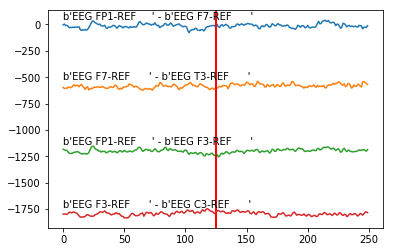

Spike Index:  3788


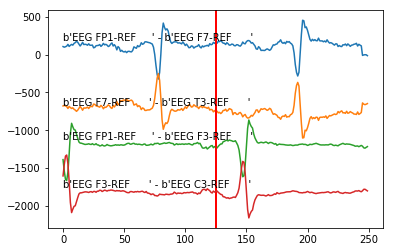

Spike Index:  3874


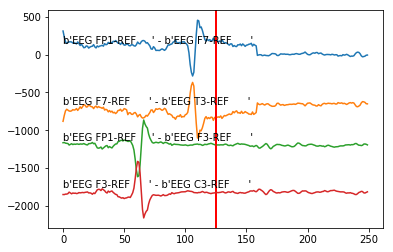

Spike Index:  3988


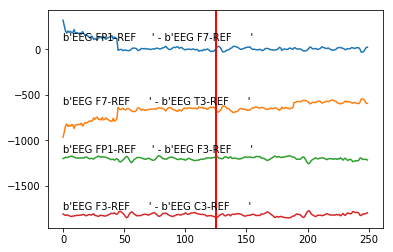

Spike Index:  6610


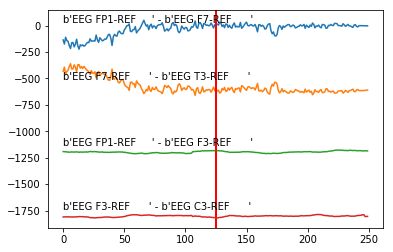

Spike Index:  6708


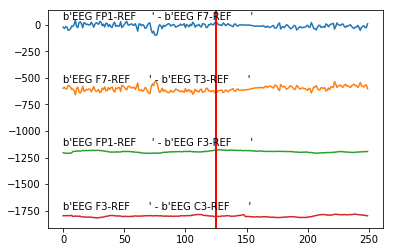

Spike Index:  7957


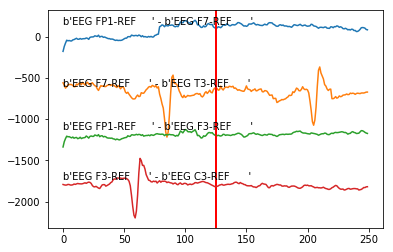

Spike Index:  12041


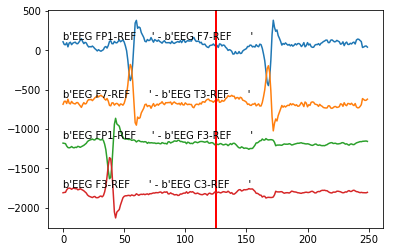

Spike Index:  12217


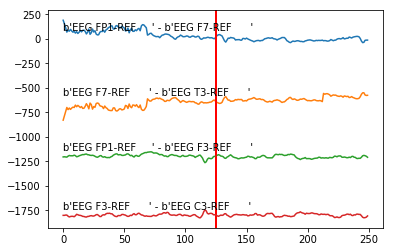

Spike Index:  14726


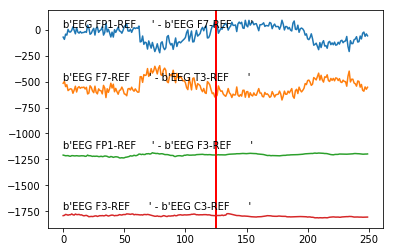

Spike Index:  14975


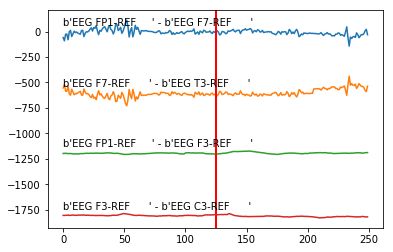

Spike Index:  16098


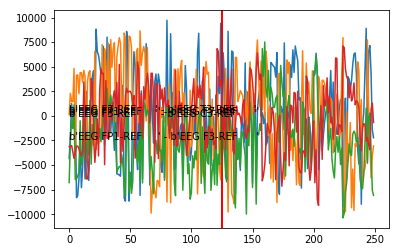

Spike Index:  16235


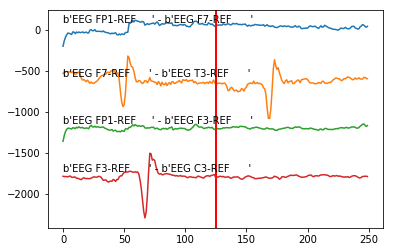

Spike Index:  18794


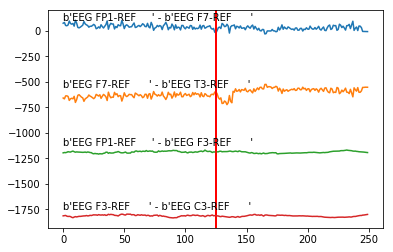

Spike Index:  20225


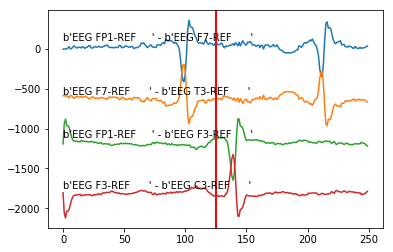

Spike Index:  20327


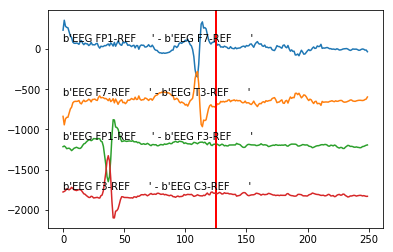

Spike Index:  20444


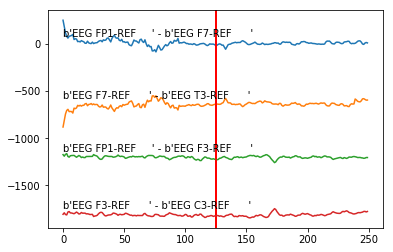

Spike Index:  24371


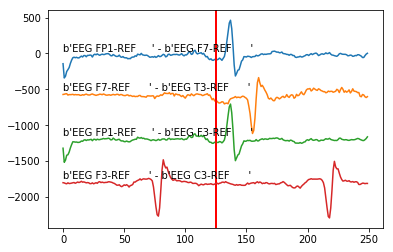

Spike Index:  24516


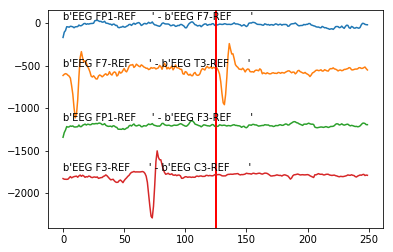

Spike Index:  28516


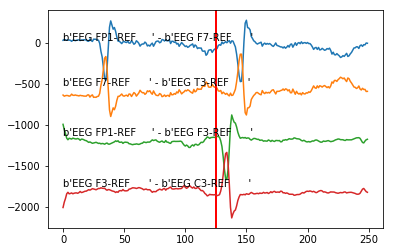



QUADRANT   ______  [3838, 3845, 3985, 4147, 7945, 8074, 12126, 12273, 14829, 15079, 16195, 16324, 20079, 20265, 20410, 20531, 22579, 22832, 24445, 24574, 28082, 28332, 28550, 28661, 28788]
Spike Index:  3838


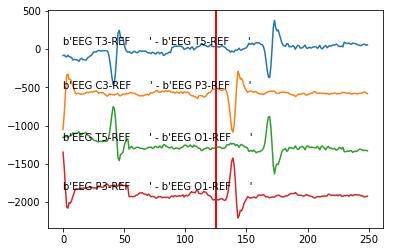

Spike Index:  3845


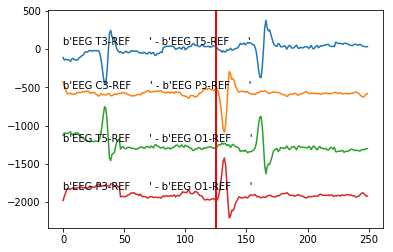

Spike Index:  3985


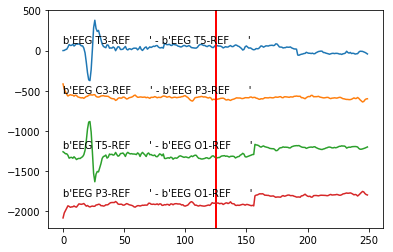

Spike Index:  4147


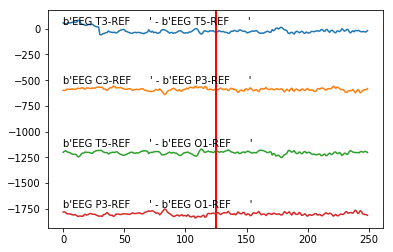

Spike Index:  7945


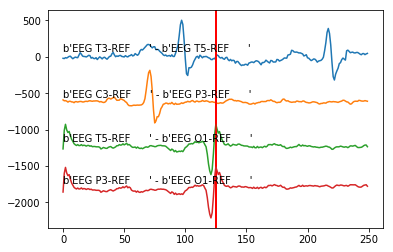

Spike Index:  8074


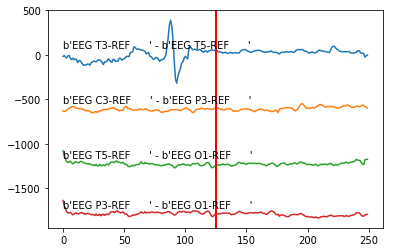

Spike Index:  12126


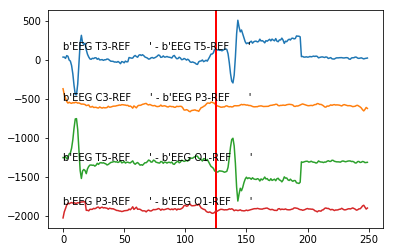

Spike Index:  12273


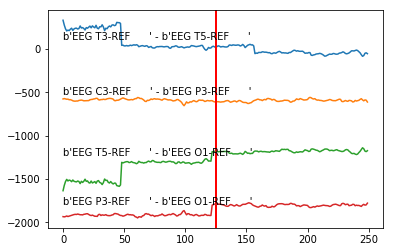

Spike Index:  14829


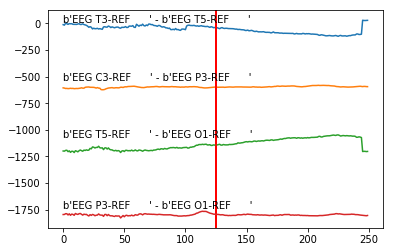

Spike Index:  15079


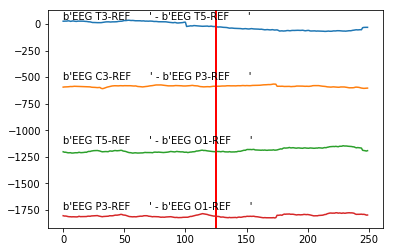

Spike Index:  16195


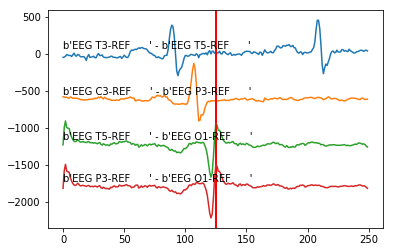

Spike Index:  16324


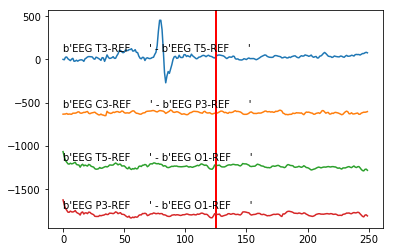

Spike Index:  20079


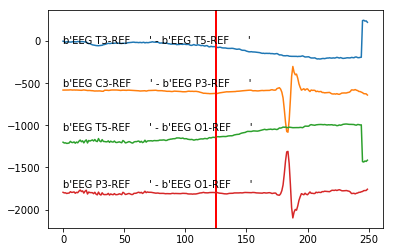

Spike Index:  20265


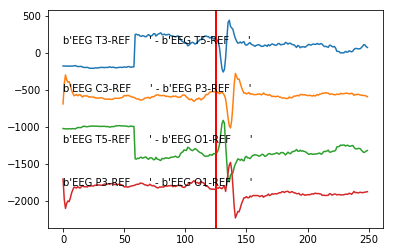

Spike Index:  20410


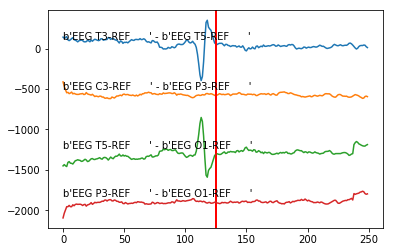

Spike Index:  20531


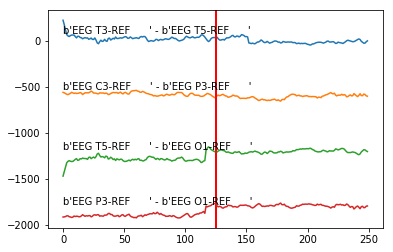

Spike Index:  22579


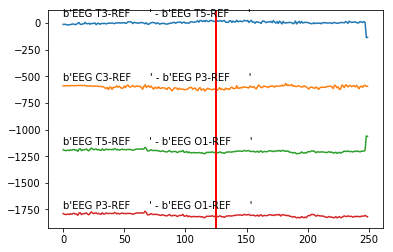

Spike Index:  22832


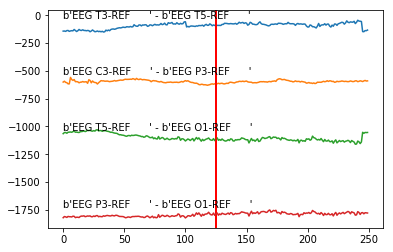

Spike Index:  24445


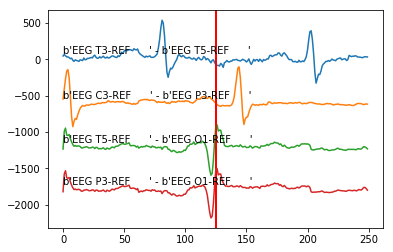

Spike Index:  24574


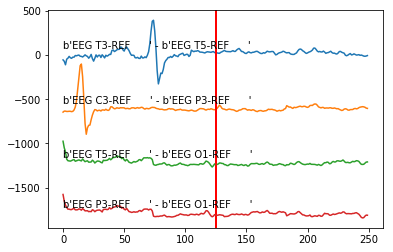



QUADRANT   ______  [355, 355, 603, 2110, 5836, 5993, 8363, 8613, 8712, 10363, 14141, 14260, 16856, 17116, 18616, 22374, 22597, 24870, 25119]
Spike Index:  355


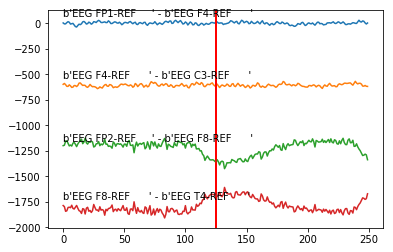

Spike Index:  355


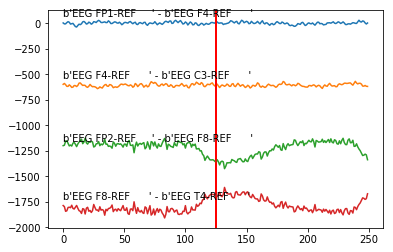

Spike Index:  603


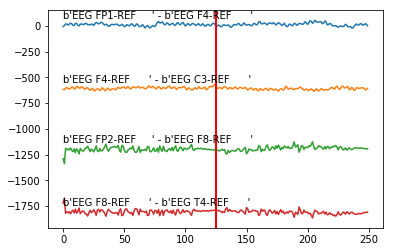

Spike Index:  2110


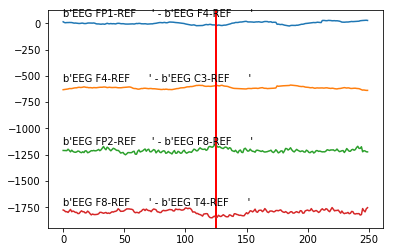

Spike Index:  5836


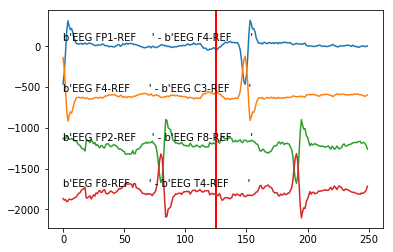

Spike Index:  5993


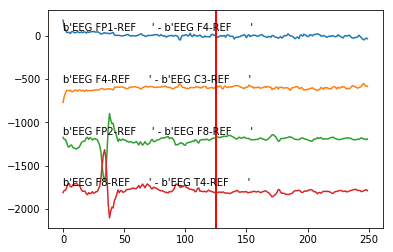

Spike Index:  8363


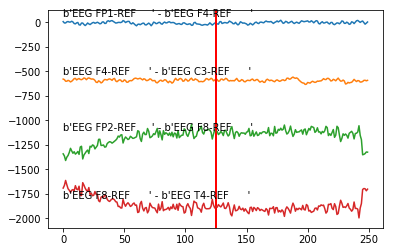

Spike Index:  8613


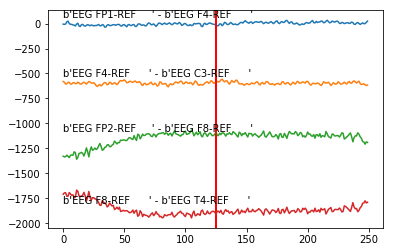

Spike Index:  8712


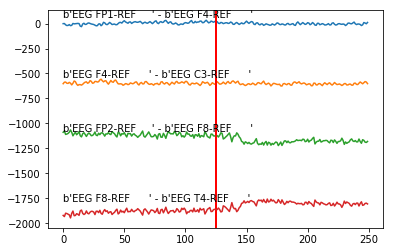

Spike Index:  10363


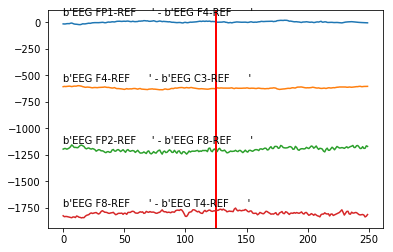

Spike Index:  14141


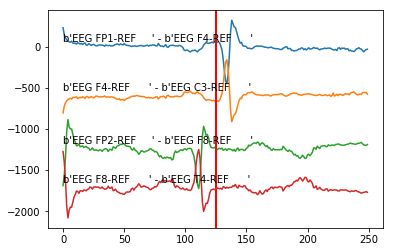

Spike Index:  14260


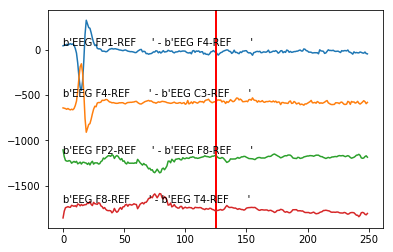

Spike Index:  16856


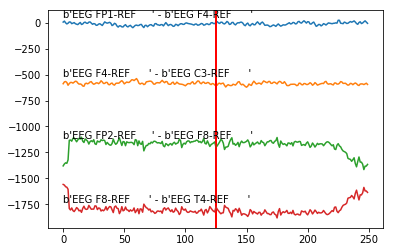

Spike Index:  17116


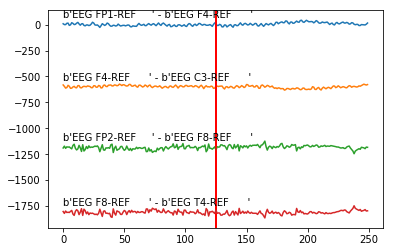

Spike Index:  18616


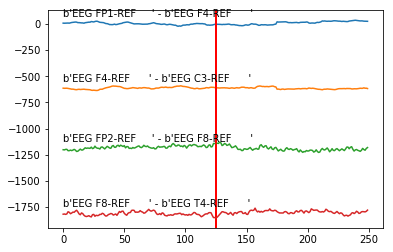

Spike Index:  22374


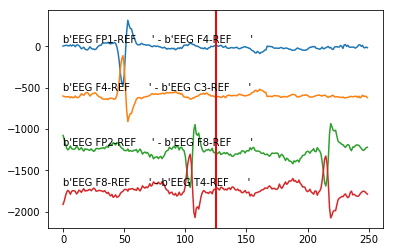

Spike Index:  22597


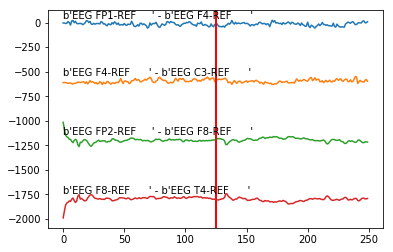

Spike Index:  24870


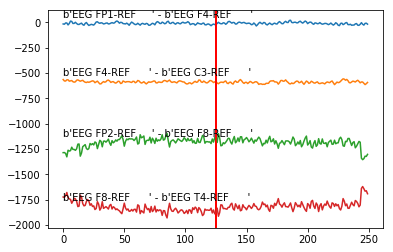

Spike Index:  25119


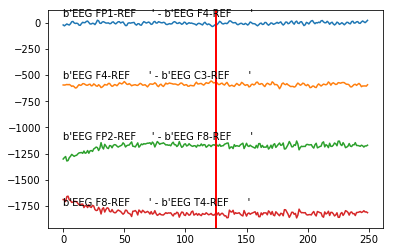



QUADRANT   ______  [1780, 1908, 5934, 6070, 8024, 10039, 10167, 14079, 14216, 14318, 16159, 16305, 16723, 18297, 18425, 22358, 22449, 24457, 24597, 24725, 24975, 26555, 26683, 29366]
Spike Index:  1780


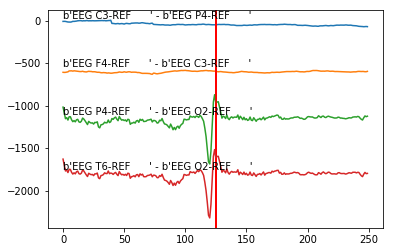

Spike Index:  1908


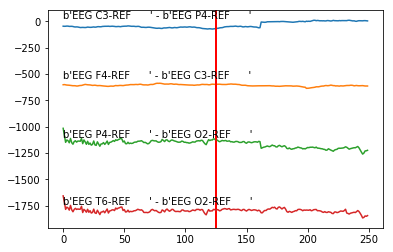

Spike Index:  5934


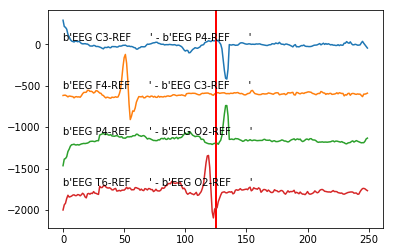

Spike Index:  6070


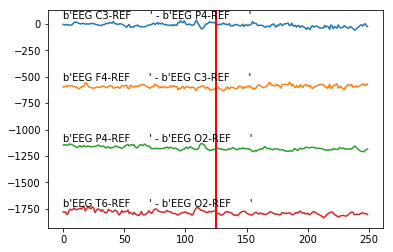

Spike Index:  8024


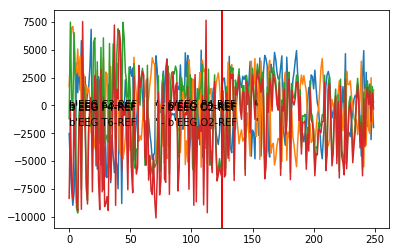

Spike Index:  10039


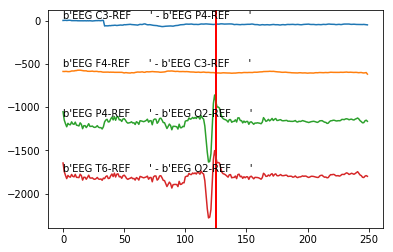

Spike Index:  10167


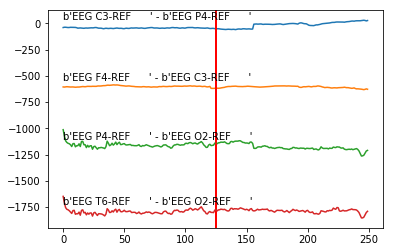

Spike Index:  14079


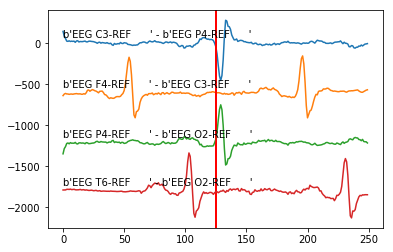

Spike Index:  14216


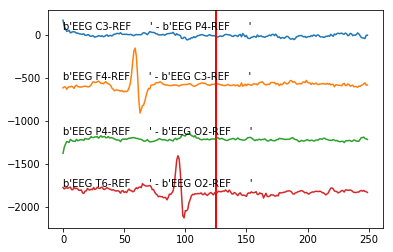

Spike Index:  14318


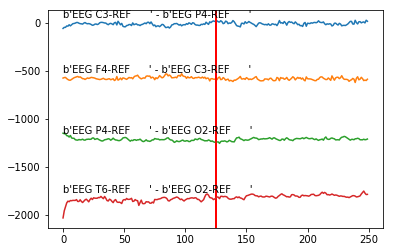

Spike Index:  16159


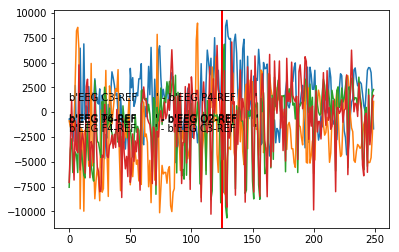

Spike Index:  16305


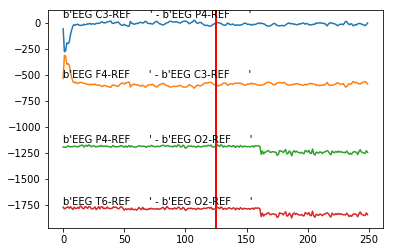

Spike Index:  16723


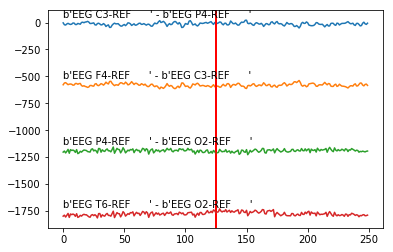

Spike Index:  18297


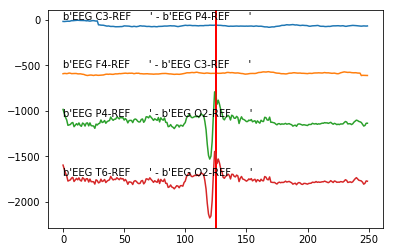

Spike Index:  18425


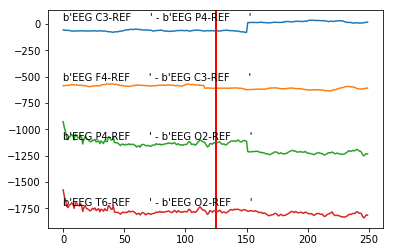

Spike Index:  22358


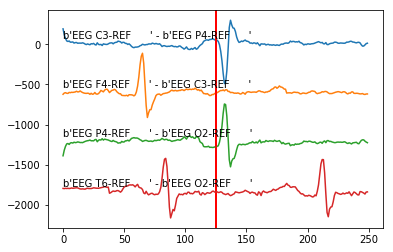

Spike Index:  22449


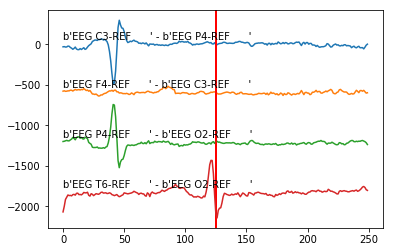

Spike Index:  24457


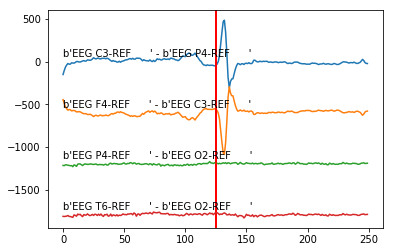

Spike Index:  24597


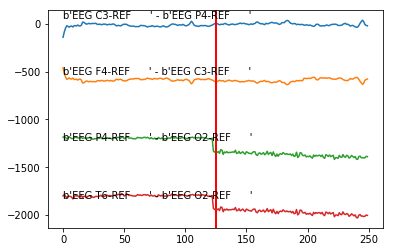

Spike Index:  24725


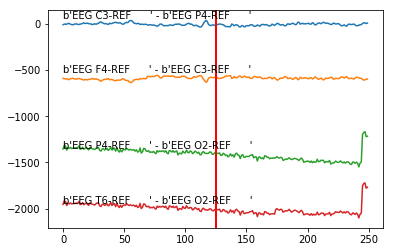

In [225]:
#plotQuadrantSpike(edfObject,quadrantArray,montageArray,quadrantToPlot,indexToPlot,timeSpan)

for i,quadrant in enumerate(finalCandidates):
    print("\n\nQUADRANT   ______ ",quadrant)
    for spikeIndex in quadrant[0:20]:
        print("Spike Index: ",spikeIndex)
        plotQuadrantSpike(trainingEDF1,adjacentElectrodeArray,longBipolarMontage,i,spikeIndex,1) 

In [256]:
def checkInput():
    a = input()
    a = int(a)
    if int(a)==0 or int(a)==1:
        return int(a)
    checkInput()
    
def markQuadrants(finalCandidatesIn,edfIn):
    '''
    takes 
    Returns: quadrantDict = {quadrant:[index,trueSpike?]}
    '''
    returnDict = {}
    for i,quadrant in enumerate(finalCandidatesIn):
        spikeIndexArray = []
        print("\n\nQUADRANT   ______ ",quadrant)
        for spikeIndex in quadrant:
            print("Spike Index: ",spikeIndex)
            plotQuadrantSpike(edfIn,adjacentElectrodeArray,longBipolarMontage,i,spikeIndex,1) 
            trueSpike = checkInput()
            spikeIndexArray.append([spikeIndex,trueSpike])
            print("Spike? ",trueSpike)
            print("Spike Index Array:", spikeIndexArray)
        returnDict[i] = spikeIndexArray
        print("RETURN DICT------------------",returnDict)
    return returnDict
            
#markQuadrants()
            



QUADRANT   ______  [38, 3788, 3874, 3988, 6610, 6708, 7957, 12041, 12217, 14726, 14975, 16098, 16235, 18794, 20225, 20327, 20444, 24371, 24516, 28516, 28658]
Spike Index:  38


/Applications/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


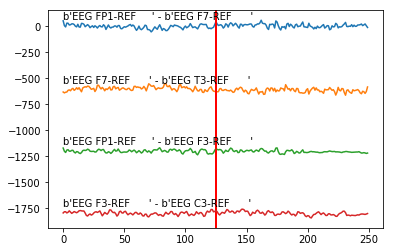

0
Spike?  0
Spike Index Array: [[38, 0]]
Spike Index:  3788


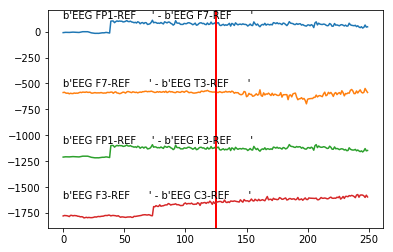

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0]]
Spike Index:  3874


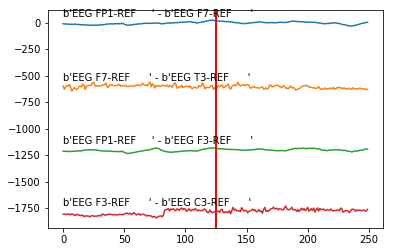

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0]]
Spike Index:  3988


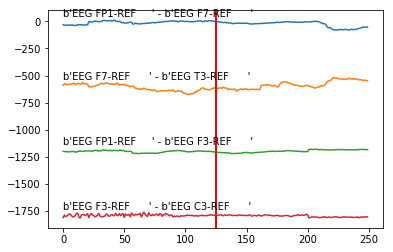

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0]]
Spike Index:  6610


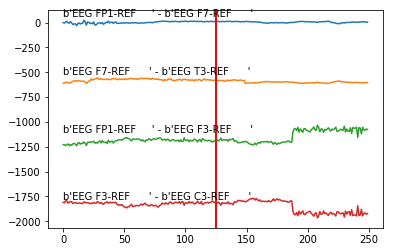

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0]]
Spike Index:  6708


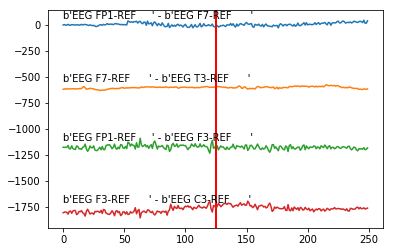

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0]]
Spike Index:  7957


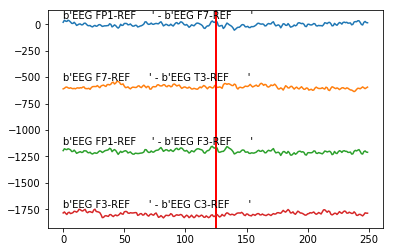

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0]]
Spike Index:  12041


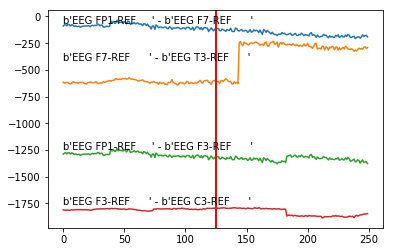

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0]]
Spike Index:  12217


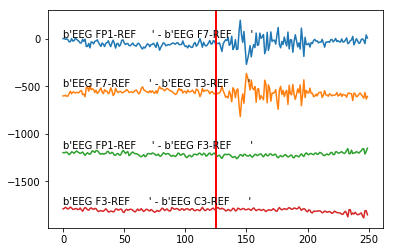

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0]]
Spike Index:  14726


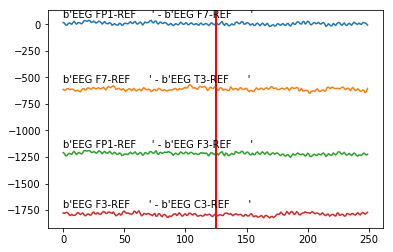

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0]]
Spike Index:  14975


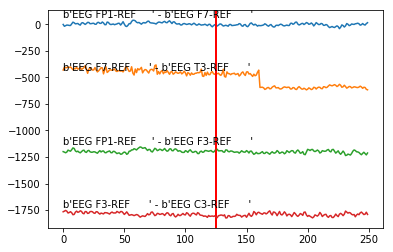

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0]]
Spike Index:  16098


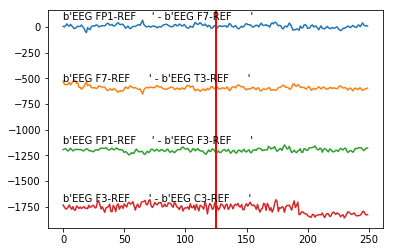

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0]]
Spike Index:  16235


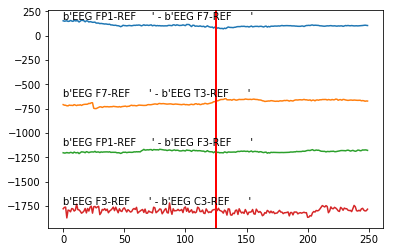

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0]]
Spike Index:  18794


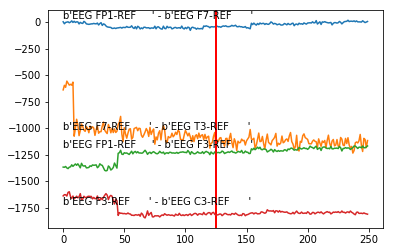

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0]]
Spike Index:  20225


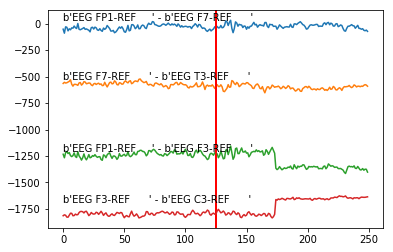

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0], [20225, 0]]
Spike Index:  20327


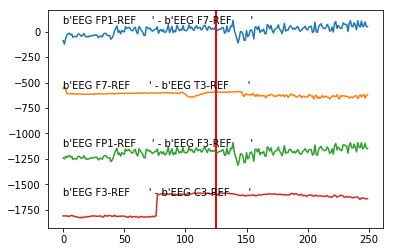

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0], [20225, 0], [20327, 0]]
Spike Index:  20444


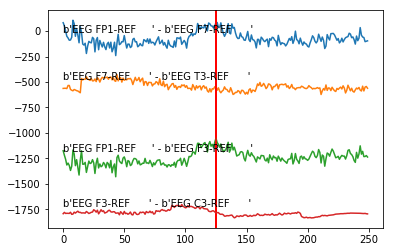

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0], [20225, 0], [20327, 0], [20444, 0]]
Spike Index:  24371


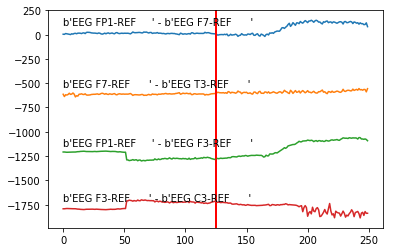

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0], [20225, 0], [20327, 0], [20444, 0], [24371, 0]]
Spike Index:  24516


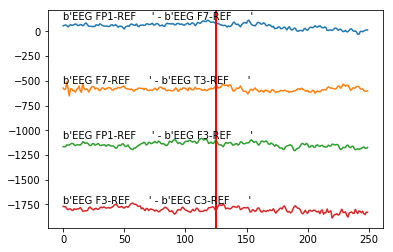

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0], [20225, 0], [20327, 0], [20444, 0], [24371, 0], [24516, 0]]
Spike Index:  28516


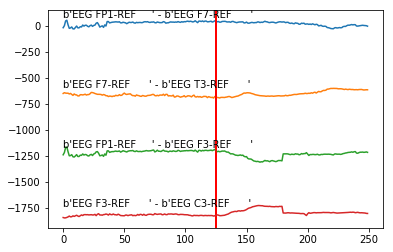

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0], [20225, 0], [20327, 0], [20444, 0], [24371, 0], [24516, 0], [28516, 0]]
Spike Index:  28658


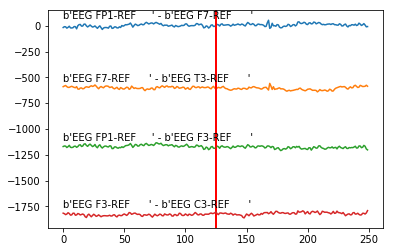

0
Spike?  0
Spike Index Array: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0], [20225, 0], [20327, 0], [20444, 0], [24371, 0], [24516, 0], [28516, 0], [28658, 0]]
RETURN DICT------------------ {0: [[38, 0], [3788, 0], [3874, 0], [3988, 0], [6610, 0], [6708, 0], [7957, 0], [12041, 0], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 0], [18794, 0], [20225, 0], [20327, 0], [20444, 0], [24371, 0], [24516, 0], [28516, 0], [28658, 0]]}


QUADRANT   ______  [3838, 3845, 3985, 4147, 7945, 8074, 12126, 12273, 14829, 15079, 16195, 16324, 20079, 20265, 20410, 20531, 22579, 22832, 24445, 24574, 28082, 28332, 28550, 28661, 28788]
Spike Index:  3838


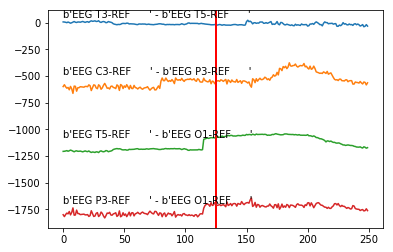

0
Spike?  0
Spike Index Array: [[3838, 0]]
Spike Index:  3845


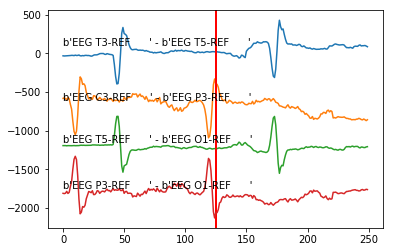

1
Spike?  1
Spike Index Array: [[3838, 0], [3845, 1]]
Spike Index:  3985


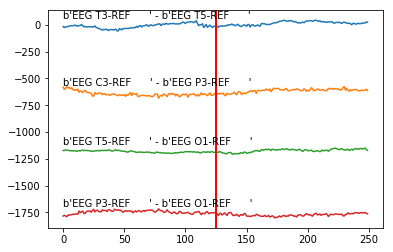

KeyboardInterrupt: 

In [264]:
trainingSetMarkers1 = markQuadrants(finalCandidates,trainingEDF1)



QUADRANT   ______  [901, 901, 1009, 1182, 1489, 1598, 1748, 4027, 4119, 4670, 6206, 7003, 7106, 7197, 7322, 7787, 7893, 8138, 10016, 10232, 12097, 13202, 13305, 13462, 13783, 13917, 14170, 14809, 15133, 16210, 16334, 17440, 18650, 19293, 19478, 19603, 19744, 20957, 21280, 21485, 22331, 22431, 22539, 23331, 23436, 25501, 25604, 25744, 26077, 26848, 27104, 27683, 28527, 28638]
Spike Index:  901
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457


/Applications/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


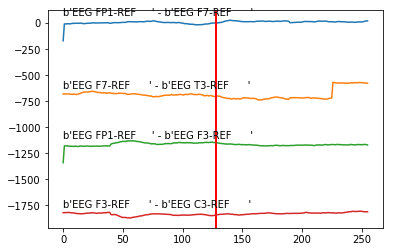

0
Spike?  0
Spike Index Array: [[901, 0]]
Spike Index:  901
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457


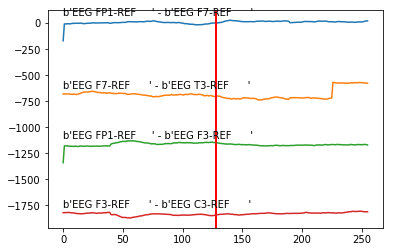

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0]]
Spike Index:  1009
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457


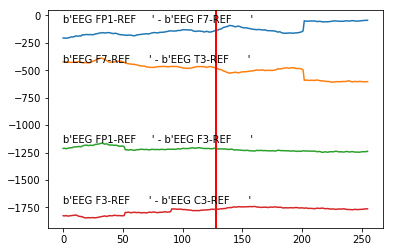

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0], [1009, 0]]
Spike Index:  1182
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457


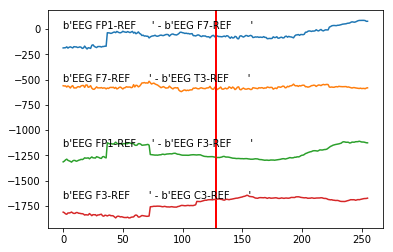

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0], [1009, 0], [1182, 0]]
Spike Index:  1489
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457


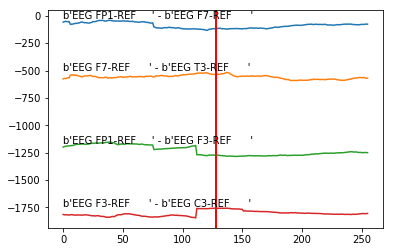

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0], [1009, 0], [1182, 0], [1489, 0]]
Spike Index:  1598
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457


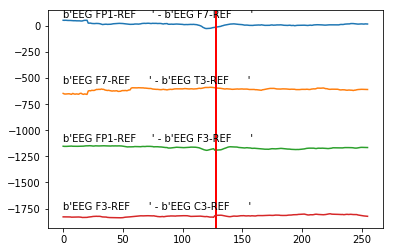

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0], [1009, 0], [1182, 0], [1489, 0], [1598, 0]]
Spike Index:  1748
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457
Channel2SCALE FACTOR:  0.1673112582781457


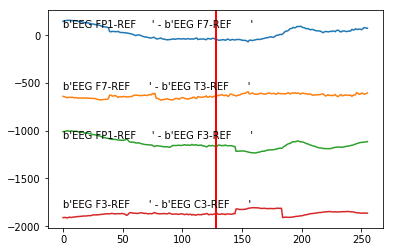

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0], [1009, 0], [1182, 0], [1489, 0], [1598, 0], [1748, 0]]
Spike Index:  4027
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN F

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

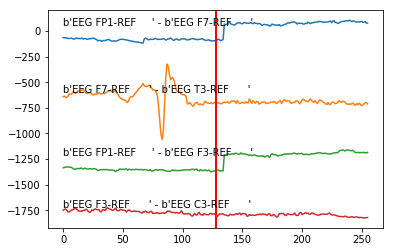

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0], [1009, 0], [1182, 0], [1489, 0], [1598, 0], [1748, 0], [4027, 0]]
Spike Index:  4119
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

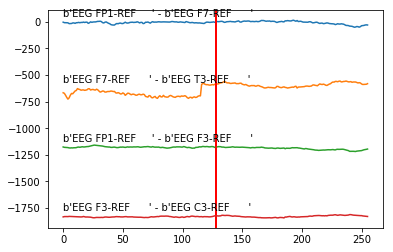

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0], [1009, 0], [1182, 0], [1489, 0], [1598, 0], [1748, 0], [4027, 0], [4119, 0]]
Spike Index:  4670
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE P

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

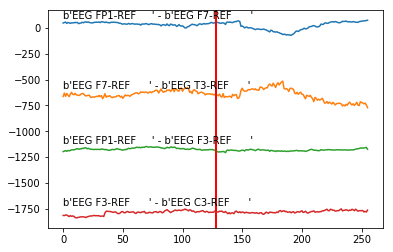

0
Spike?  0
Spike Index Array: [[901, 0], [901, 0], [1009, 0], [1182, 0], [1489, 0], [1598, 0], [1748, 0], [4027, 0], [4119, 0], [4670, 0]]
Spike Index:  6206
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERRO

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
ERROR IN FILE PARSER:  b''
E

TypeError: ufunc 'multiply' did not contain a loop with signature matching types dtype('<U32') dtype('<U32') dtype('<U32')

In [477]:
predictSetMarkers = markQuadrants(finalCandidatesPredict,predictEDF1)

In [430]:
#print(trainingSetMarkers.keys())
for x in trainingSetMarkers:
    print("X: ",x,"\n",trainingSetMarkers[x])
    
print("\n\n")
for x in predictSetMarkers:
    print("X: ",x,"\n",predictSetMarkers[x])

X:  0 
 [[38, 0], [3788, 1], [3874, 1], [3988, 0], [6610, 0], [6708, 0], [7957, 1], [12041, 1], [12217, 0], [14726, 0], [14975, 0], [16098, 0], [16235, 1], [18794, 0], [20225, 1], [20327, 1], [20444, 0], [24371, 1], [24516, 1], [28516, 1], [28658, 1]]
X:  1 
 [[3838, 1], [3845, 1], [3985, 1], [4147, 0], [7945, 1], [8074, 1], [12126, 1], [12273, 0], [14829, 0], [15079, 0], [16195, 1], [16324, 1], [20079, 1], [20265, 1], [20410, 1], [20531, 0], [22579, 0], [22832, 0], [24445, 1], [24574, 1], [28082, 0], [28332, 1], [28550, 1], [28661, 1], [28788, 0]]
X:  2 
 [[355, 0], [355, 0], [603, 0], [2110, 0], [5836, 1], [5993, 1], [8363, 0], [8613, 0], [8712, 0], [10363, 0], [14141, 1], [14260, 1], [16856, 0], [17116, 0], [18616, 0], [22374, 1], [22597, 0], [24870, 0], [25119, 0]]
X:  3 
 [[1780, 1], [1908, 0], [5934, 1], [6070, 0], [8024, 0], [10039, 1], [10167, 0], [14079, 1], [14216, 1], [14318, 0], [16159, 0], [16305, 0], [16723, 0], [18297, 1], [18425, 0], [22358, 1], [22449, 1], [24457, 0], 

NameError: name 'predictSetMarkers' is not defined

In [ ]:
def getAverageAmplitudeChange(dataString,sampleRate):
    return "Not done yet"

def getSlope(dataString,sampleRate):
    dataMax = max(dataString)
    dataMin = min(dataString)
    
    maxIndex = list(dataString).index(dataMax)
    minIndex = list(dataString).index(dataMin)
    #print("Data String: ",dataString/10)
    #print("maxIndex: ",maxIndex)
    #print("Min Index: ",minIndex)
    
    dataAverage = np.average(dataString)
    if maxIndex<minIndex:
        upFound = False
        downFound = False
        i = 1
        while upFound == False:
            deflectionFound = dataString[maxIndex-i-1] > dataString[maxIndex-i]
            #print("Data max>min up: ",dataString[maxIndex-i-1], dataString[maxIndex-i])
            if deflectionFound:
                upwardDuration = i/sampleRate #Duration in mSec
                amplitudeChange = dataMax - dataString[maxIndex - i - 1]
                upwardSlope = amplitudeChange/upwardDuration
                upwardIndex = maxIndex - i
                upFound = True
                i = 1
            else:
                i+=1
        while downFound == False:
            deflectionFound = dataString[maxIndex+i+1] > dataString[maxIndex+i]
            #print("Data max>min down: ",dataString[maxIndex+i+1], dataString[maxIndex+i])
            if deflectionFound:
                downwardDuration = i/sampleRate #Duration in mSec
                amplitudeChange = dataMax - dataString[maxIndex + i + 1]
                downwardSlope = amplitudeChange/downwardDuration
                downwardIndex = maxIndex + i + 1
                downFound = True
                i = 1
            else:
                i+=1
                
    elif minIndex<maxIndex:
        upFound = False
        downFound = False
        i = 1
        while upFound == False:
            if minIndex+i+1 >= sampleRate:
                deflectionFound = True
            else:
                deflectionFound = dataString[minIndex+i+1] < dataString[minIndex+i]
            #print("Data min< max up: ",dataString[minIndex+i+1], dataString[minIndex+i]," i: ",i)
            if deflectionFound:
                upwardDuration = i/sampleRate #Duration in mSec
                amplitudeChange = dataString[minIndex + i] - dataMin
                upwardSlope = amplitudeChange/upwardDuration
                upwardIndex = minIndex + i
                #print("upwardSlope: ",upwardSlope, "index: ",upwardIndex)
                upFound = True
                i = 1
            else:
                i+=1
        while downFound == False:
            deflectionFound = dataString[minIndex-i-1] < dataString[minIndex-i]
            #print("Data min<max down: ",dataString[minIndex-i-1], dataString[minIndex-i])
            if deflectionFound:
                #print("Found a deflection")
                downwardDuration = i/sampleRate #Duration in mSec
                amplitudeChange = dataString[minIndex - i - 1] - dataMin
                downwardSlope = amplitudeChange/downwardDuration
                downwardIndex = minIndex - i - 1
                downFound = True
                i = 1
            else:
                i+=1
                
        
    return [upwardSlope,downwardSlope,downwardIndex,upwardIndex,dataMax,dataMin]
  

def getSpikeFeaturesForNeuralNetwork(setMarkers,edfIn,adjacencyArray,montageArray):
    '''
    f=each feature value will repeat 4 times for each value in adjacentArea
    return [0,1,0,1,1,1,0,0],[[ampMax,ampMin,upSlope,downSlope,fftPeak,averageAmplitudeChange]
    Prototype:
    [upwardSlope,downwardSlope,downwardIndex,upwardIndex,dataMax,dataMin]
    '''
    edfDataDictionary = edfIn.dataDictionary(0,120)
    dataDictionaryKeys = edfDataDictionary.keys()
    edfSampleRate = edfIn.getSampleRate()
    dataDictionaryKeys = list(edfDataDictionary.keys())
    setMarkerKeys = list(setMarkers.keys())
    #print("SetMarkers: ",setMarkers)
    
    isSpikeArray = []
    featureArray = []
    
    for i in setMarkerKeys:
        channelsInQuadrant = adjacencyArray[i]
        #print("ChannelsInQuadrant: ",channelsInQuadrant)
        #print("QuadrantMarkers: ",setMarkers[i])
        for entry in setMarkers[i]:
            isSpike = entry[1]
            #isSpikeArray.append(isSpike)
            spikeCandidateIndex = entry[0]
            if spikeCandidateIndex < edfSampleRate:
                break
            #print("adjArray: ",adjacencyArray[i])
            #print("i, ",i)
            for channel in adjacencyArray[i]:
                #print(channel)
                channel1Index = montageArray[channel][0]
                channel2Index = montageArray[channel][1]
                channel1Label = dataDictionaryKeys[channel1Index]
                channel2Label = dataDictionaryKeys[channel2Index]
                channel1 = edfDataDictionary[channel1Label]
                channel2= edfDataDictionary[channel2Label]

                channel1DigMax = channel1['digMax']
                channel1PhysMax = channel1['physMax']
                channel2DigMax = channel2['digMax']
                channel2PhysMax = channel2['physMax']
                sampleRate = channel1['sampleRate']

                channel1ScaleFactor = channel1PhysMax/channel1DigMax
                channel2ScaleFactor = channel2PhysMax/channel2DigMax
                #print("ChannelScaleFactors: ",channel1ScaleFactor,channel2ScaleFactor)
                dataStartIndex = int(spikeCandidateIndex - int(sampleRate/2))
                dataEndIndex = int(spikeCandidateIndex + int(sampleRate/2))
                #print("INDICES: ",dataStartIndex," : ",dataEndIndex)
                input1Data = np.array(edfDataDictionary[channel1Label]['data'][dataStartIndex:dataEndIndex]) * channel1ScaleFactor
                input2Data = np.array(edfDataDictionary[channel2Label]['data'][dataStartIndex:dataEndIndex]) * channel2ScaleFactor
                #print('input1Data: ',input1Data)
                channelData = input1Data - input2Data 
                #print(channelData)
                #plt.plot(channelData)
                #plt.show()
                sampleSlope = getSlope(channelData,edfSampleRate)
                isSpikeArray.append(isSpike)
                featureArray.append(sampleSlope)
                #print("SampleSlope: ",sampleSlope)
    return [isSpikeArray,featureArray]
               
            
        
    

<h1>Neural Network</h1>

In [466]:
TRAIN_DATA = getSpikeFeaturesForNeuralNetwork(trainingSetMarkers,trainingEDF1,adjacentElectrodeArray,longBipolarMontage)
#print(TRAIN_DATA)
#print(np.array(TRAIN_DATA).shape)
print(np.array(TRAIN_DATA[0]).shape)
print(np.array(TRAIN_DATA[1]).shape)

(272,)
(272, 6)


In [467]:
TRAIN_DATA_Y = TRAIN_DATA[0]
TRAIN_DATA_X = TRAIN_DATA[1]  #[upwardSlope,downwardSlope,downwardIndex,upwardIndex,dataMax,dataMin]
    

In [471]:
#with open("TrainDataY.txt",'w') as trainDataY:
    trainDataY.write(json.dumps(TRAIN_DATA_Y))
    
#with open("TrainDataX.txt","w") as trainDataX:
    trainDataX.write(json.dumps(TRAIN_DATA_X))

In [468]:
clf = MLPClassifier(solver='lbfgs', alpha=1e-5,hidden_layer_sizes=(5, 2), random_state=1)
scaler = StandardScaler()  
SCALED_FIT_X = scaler.fit(TRAIN_DATA_X)
SCALED_TRAIN_X = scaler.transform(TRAIN_DATA_X)

clf.fit(TRAIN_DATA_X, TRAIN_DATA_Y) 
#clf.fit(SCALED_TRAIN_X,TRAIN_DATA_Y)


#clf.predict([[1., 2.]])

MLPClassifier(activation='relu', alpha=1e-05, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(5, 2), learning_rate='constant',
       learning_rate_init=0.001, max_iter=200, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=1, shuffle=True,
       solver='lbfgs', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False)

In [401]:
clf.fit(SCALED_TRAIN_X,TRAIN_DATA_Y)

MLPClassifier(activation='relu', alpha=1e-05, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(5, 2), learning_rate='constant',
       learning_rate_init=0.001, max_iter=200, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=1, shuffle=True,
       solver='lbfgs', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False)

<h1>File Tree Parse Functions</h1>

In [327]:
def parseTse(filePath):
    try:
        with open(str(filePath),'r') as tseFileData:
            tseData = [line.rstrip('\n') for line in tseFileData]
        #print("Entry (Parse Fuction: ): ",tseData)
        tseEntryList = []
        for entry in tseData:
            entryList = entry.split(" ")
            #print("TSE DATA ENTRY (parse function) : ",entryList)
            if len(entryList) == 4:
                splitFile = filePath.split('/')
                currentFile = splitFile[5] #changed from 5 to 4
                currentSessionNumber = splitFile[4].split('_')[0]
                currentFileSplit = currentFile.split('_')
                currentT = currentFileSplit[2].split(".")
                currentT = currentT[0]
                tseEntry = {'currentT':currentT,'startTime':entryList[0],'endTime':entryList[1],
                               'eventLabel':entryList[2],'probability':entryList[3]}
                tseEntryList.append(tseEntry)
            else:
                pass
                #print("LEN NOT 4: ",entryList)
        return(tseEntryList)
    except Exception as exc:
        print("Exception: ",exc)
        print("Found an error with tseFile()")
        
def parseLbl(filePath):
    return "Not done yet"

def addFile(filepath):
    splitFile = filepath.split('/')
    if len(splitFile)<6:
        pass
        #print("File path too short")
    else:
        patientId = splitFile[3]
        currentFile = splitFile[5] #changed from 5 to 4
        currentSessionNumber = splitFile[4].split('_')[0]
        currentFileSplit = currentFile.split('_')
        currentFileExt = str(fileExt(currentFile))
        sessionNumber = currentFileSplit[0] #Changed from 1 to 0
        sessionId = str(patientId)+str(currentSessionNumber)
        #print("\tFile Path: ",filepath)
        #print("\t\tCurrentFile: ",currentFileSplit)
        #print("\t\tCurrentFileExt: ",currentFileExt)
        #pr, int("\t\tSessionId: ",sessionId)
        dbSession = sessions.find_one({"sessionId":sessionId})
        
        if dbSession == None:
            sessions.insert_one({"sessionId":sessionId,"patientId":patientId})
            #print("Found a new session")
        else:
            pass
            #print("Found this session\n")  
        if currentFileExt == ".txt":
            try:
                with open(str(files),'r') as reportFile:
                    rText = reportFile.readlines()  
                try:
                    sessions.update_one({"sessionId":sessionId},
                                       {"$set":{"reportText":rText}})
                except:
                    pass
                    #print("Could not add report text")     
            except UnicodeDecodeError:
                sessions.update_one({"sessionId":sessionId},
                                       {"$set":{"reportText":"Unopenable"}})
        elif currentFileExt  == ".edf":
            try:
                updateEdf = dbSession['edfList']
                updateEdf.append(filepath)
                #edfFileData = edfData(1)
                #edfFileData.loadFile(filePath)
                #edfFileData.parseEdf()
                #print("EDF DATA: ",edfFileData.channelSampleRates)
                sessions.update_one({"sessionId":sessionId},{"$set":{"edfList":updateEdf}})    
                #ADD EDF INFO EX SAMPLE RATE AND OTHER INFO
                
                #This is new~~~~~~~~~~~~~~~~---------------!!!!!!!!!!!!!!!!!!!!!@#$%@#^$%$#%@$#%#$@%@%^%$^#
                #sessions.update_one({"sessionId":sessionId},{"$set":{"sampleRates":edfFileData.channelSampleRates}})
                
                
            except:
                #print ("No edf") 
                sessions.update_one({"sessionId":sessionId},{"$set":{"edfList":[filepath]}})
        elif currentFileExt == ".lbl":
            try:
                updateLbl = dbSession['lblList']
                updateLbl.append(filepath)
                #print("\n\nUPDATING LABL LIST-------------")
                #print(updateLbl)
                sessions.update_one({"sessionId":sessionId},{"$set":{"lblList":updateLbl}})
            except:
                sessions.update_one({"sessionId":sessionId},{"$set":{"lblList":[filepath]}})
                
    #TSE DATA ERROR IN FIRST ENTRY BECAUSE dbSessionTSEDATA DOESNT EXIST
    ###### Must change function to append to existing tse data entry, look for existing
    ###### Then append the new data entries.
    ##### Changed lne 'updateTseData.append(tseEntry)' to updateTseData += tseEntry in for loop
        elif currentFileExt == ".tse":
            try:
                updateTse = dbSession['tseList']
                updateTse.append(filepath)
                updateTseData = dbSession['tseData']
                #print("updateTseData from find: ",updateTseData)
                tseEntry = parseTse(files)
                updateTseData = updateTseData + tseEntry
                '''
                for entry in tseEntry:    
                    updateTseData += entry
                '''
                #print("After Append--------->")
                #print(updateTseData)
                sessions.update_one({"sessionId":sessionId},{"$set":{"tseList":updateTse}})
                sessions.update_one({"sessionId":sessionId},{"$set":{"tseData":updateTseData}})
            
            except Exception as exc:
                #print("TSE EXCEPTION ENCOUNTERED")
                #print("EXC: ",exc)
                sessions.update_one({"sessionId":sessionId},{"$set":{"tseList":[filepath]}})
                
                tseEntry = parseTse(files)
    
                sessions.update_one({"sessionId":sessionId},{"$set":{"tseData":tseEntry}})
        
    #Write function to take edf file path and return EEG data. 
        #Add optional parameters to input tse data and return only that EEG data. 
#Return data samples with certain feature and specified time before and after

#https://stackoverflow.com/questions/273192/how-can-i-create-a-directory-if-it-does-not-exist
def ensure_dir(file_path):
    directory =  file_path# os.path.dirname(file_path)
    print("DIRECTORY: ",directory)
    if not os.path.exists(directory):
        os.makedirs(directory)

def loadFeatureData(filePath):
    edfData = json.load(open(filePath,'r'))
    return edfData
    
    
    
def returnSampleRateEdf(edfFilePath):
    edfFile = edfData(1)
    edfFile.loadFile(edfFilePath)
    edfFile.parseEdf()
    return edfFile.sampleRate
    
        
def returnFeatureData(featureSearch,timeBefore=10,timeAfter=10):
    '''
    Creates text files containing specified eeg activity
    '''
    records = testDb.sessions.find({'tseData.eventLabel':featureSearch})
    recordList = []
    fileNameString = (str(featureSearch)+'_'+str(timeBefore)+'_'+str(timeAfter))
    #print("FileNameString: "+fileNameString)
    iterations = 0
    with open(fileNameString,'w') as featureDataFile:
        featureDataFile.write(str(featureSearch)+'\n')
        directoryName = str(featureSearch+"Directory")
        ensure_dir(directoryName)
        for x in records:
            iterations+=1
            if iterations == 4:
                break
            #print(x['sessionId'])
            recordList.append(x)
            for tse in x['tseData']:
                if tse['eventLabel'] == featureSearch:
                    print(tse)
                    for edf in x['edfList']:
                        if (str(tse['currentT'])+'.edf') in edf.split('_'):  #This is messy, clean it up
                            startTime = 0.0 #                                     float(tse['startTime'])
                            endTime = float(tse['endTime'])
                            duration = endTime-startTime
                            sampleRate = returnSampleRateEdf(edf)
                            #print("In if statement should be printing sample rate right after this.")
                            #print("SAMPLE RATE FROM EDF: ",sampleRate)
                            #print("Start Time from TSE: ",startTime)
                            #print("End Time from TSE: ",endTime)
                            #print("Duration: ",duration)
                            
                            #print(edf)
                            txtFileName = (str(edf.split('/')[-1].split('.')[0])+'.txt')
                            #print("EDF SPLIT: ",edf)
                            edfFile = edfData(1)
                            edfFile.loadFile(edf)
                            edfFile.parseEdf()
                            edfDataText = edfFile.dataDictionary(0.0,endTime)
                            #print("Should be writing")
                            edfFilePathWrite = str(directoryName)+"/"+str(txtFileName)
                            with open(edfFilePathWrite,'w') as featureDataFile:
                                featureDataFile.write(json.dumps(edfDataText))
                                  
    print(len(recordList))
    

<h1>Functions from old workbook</h1>

In [ ]:
'''
Extra features from firsWorkbook
'''

testDataFile = trainingEDF1.dataDictionary(0,10)
eegKeys = list(testDataFile.keys())

def movingAverage(inputArray,avgNum):
    newArray = []
    for i in range(len(inputArray)):
        if i<avgNum:
            pass
        newArray.append(np.average(inputArray[i-(avgNum):i]))
    return newArray
            
        

def returnVariation(eegData,width,sampleRate):
    #Looks for greatest change over the specified width in the signal
    #width is samples to 
    v1 = eegData[0]
    totalChange = 0 
    maxChange = 0
    maxIndex = 0
    dataLength = len(eegData)
    for i in range(dataLength-width):
        currentChange = 0
        for j in range(width-1):
            currentChange += eegData[j+i]-eegData[j+i+1]
             
        if abs(currentChange) > abs(maxChange):
            maxChange = currentChange
            maxIndex = i
        #print(currentChange)
        currentChange = 0
        
    msTime = maxIndex/sampleRate
    #print("Max Change: ",maxChange," Max Index: ",maxIndex," Max Time: ",msTime)
    return [maxChange,maxIndex,msTime]
        
    

fftData = {}
#Need to change EEG data to return actual values. 
# Find FFT for each 1 second segment of each channel.
fftStartPoint = 0
fftEndPoint = 6000
#Calculate FFT for each second of each channel.
for i,channelConstruct in enumerate(longBipolarMontage):
    #print ('channelConstruct: ',channelConstruct[0],' , ',channelConstruct[1])
    digMax = testDataFile[eegKeys[channelConstruct[0]]]["digMax"]
    physMax = testDataFile[eegKeys[channelConstruct[0]]]["physMax"]
    scaleRatio = physMax/digMax
    channelData = scaleRatio * np.array(testDataFile[eegKeys[channelConstruct[0]]]["data"][fftStartPoint:fftEndPoint]) - np.array(testDataFile[eegKeys[channelConstruct[1]]]["data"][fftStartPoint:fftEndPoint])
    samplesInChannelData = len(channelData)
    sampleRate = testDataFile[eegKeys[channelConstruct[0]]]["sampleRate"]
    print("SampleRate: ",sampleRate)
    durationOfSample = samplesInChannelData/sampleRate
    channelName = (str(eegKeys[channelConstruct[0]])+' , '+str(eegKeys[channelConstruct[1]]))
    for segment in range(int(durationOfSample)):
        start = segment*sampleRate
        end = start+sampleRate
        #print("Start: ",start," End: ",end,' SampleData: ', channelData[start:start+10])
        if channelName in fftData.keys():
            fftData[channelName].append(scipy.fftpack.fft(channelData[start:end])) 
        else:
            fftData[channelName] = [(scipy.fftpack.fft(channelData[start:end]))]
    
    #fftData[channelName] = scipy.fftpack.fft(channelData)
#print(fftData.keys())

eegChannelData = np.array(testDataFile[eegKeys[channelConstruct[0]]]["data"][250:500]) - np.array(testDataFile[eegKeys[channelConstruct[1]]]["data"][250:500])
eegExample = eegChannelData[0:250]

eegExample2 = eegChannelData[2250:2500] #Contains spike
spikeSample2 = eegChannelData[2300:2550]
spikeMaxChange = returnVariation(eegExample2,5,sampleRate)
spikeMaxChange2 = returnVariation(spikeSample2,5,sampleRate)
normalBackground = eegChannelData[0:250]
eegExample10Seconds = eegChannelData[0:3000]
eegExample10SecondsChange = getChangeArray(eegExample10Seconds)
eegExample10SecondsMA10 = movingAverage(eegExample10Seconds,10)
eegExample10SecondsMA3 = movingAverage(eegExample10Seconds,3)
eegExample10SecondsMA50 = movingAverage(eegExample10Seconds,50)


channelList = list(fftData.keys())
fftExampleChannel = channelList[0]
fftExample = (fftData[fftExampleChannel][0])
#contains spike-and-wave
fftExample2 = (fftData[fftExampleChannel][8])
fftExampleF1 = scipy.fftpack.fft(butter_highpass_filter(eegExample2,1,sampleRate))
fftExampleF2 = scipy.fftpack.fft(butter_highpass_filter(eegExample2,15,sampleRate))
fftExample3 = (fftData[fftExampleChannel][9]) 




T =  1.0/len(fftExample)
N = len(fftExample)

#Start,Stop,Number of samples!!!
xf = np.linspace(1,1.0/(2.0*T), N/2)


averageValue2 = np.mean(np.absolute(eegExample2))
print("EX 2 AVERAGE VALUE: ",averageValue2)
print("EX 2 Max: ",max(eegExample2))
print("EX 2 Min: ",min(eegExample2))

plt.plot(xf, 2.0/N * np.abs(fftExample[:N//2]))
plt.xlabel("Frequency")
plt.ylabel("uV Squared")
plt.title((fftExampleChannel," FFT"))
plt.show()

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Normal Background")
plt.plot(eegExample)
plt.show()

plt.plot(xf, 2.0/N * np.abs(fftExample2[:N//2]))
plt.xlabel("Frequency")
plt.ylabel("uV Squared")
plt.title("FFT Spike-and-Wave")
plt.show() 

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Spike-and-Wave")
plt.plot(eegExample2)
plt.axhline(y=averageValue2, color='r', linestyle='-')
plt.axhline(y=(0-averageValue2), color='r', linestyle='-')
plt.axes().axvline(spikeMaxChange[1],0,1).set_color('red')
plt.show()

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Spike-and-Wave 2")
plt.plot(spikeSample2)
plt.axes().axvline(spikeMaxChange2[1],0,1).set_color('red')
plt.show()

plt.plot(xf, 2.0/N * np.abs(fftExampleF1[:N//2]))
plt.xlabel("Frequency")
plt.ylabel("uV Squared")
plt.title("FFT Spike-and-Wave 1 Hz Filter")
plt.show()

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Filter 1 Hz")
plt.plot(butter_highpass_filter(eegExample2,1,sampleRate))
plt.show()

plt.plot(xf, 2.0/N * np.abs(fftExampleF2[:N//2]))
plt.xlabel("Frequency")
plt.ylabel("uV Squared")
plt.title("FFT Spike-and-Wave 15 Hz Filter")
plt.show()

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Filter 15 Hz")
plt.plot(butter_highpass_filter(eegExample2,15,sampleRate))
plt.show()

tenSecondAverage = np.average(np.absolute(eegExample10Seconds))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10Seconds)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()
#print(fftData[list(fftData.keys())[0]][0])

tenSecondChangeAverage = np.average(np.absolute(eegExample10SecondsChange))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample Change")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10SecondsChange)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()

tenSecondChangeAverage = np.average(np.absolute(eegExample10SecondsMA3))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample MA 3 points")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10SecondsMA3)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()

tenSecondChangeAverage = np.average(np.absolute(eegExample10SecondsMA10))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample MA 10 points")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10SecondsMA10)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()

tenSecondChangeAverage = np.average(np.absolute(eegExample10SecondsMA50))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample MA 50 points")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10SecondsMA50)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()